# Kaggle Tabular Project

In [8]:
import numpy as np
import random
import matplotlib.pyplot as plt
import pandas as pd
import pyarrow, fastparquet
import math
import scipy
from scipy import signal

### Define Project and Data Overview

[Harmful Brain Activity Multiclass Classification](https://www.kaggle.com/competitions/hms-harmful-brain-activity-classification/overview)

This is a supervised multiclass classification problem with the goal of using EEG and Spectrogram data to classify different types of brain activity. There isn't feature data. That has to be derived from the EEG and Spectrogram data provided. The target variable has 6 classes: Other, LPD, GPD, LRDA, GRDA, and Seizure. The problem is to extract features from the EEG and Spectrogram data and then build a classification model which will predict the type of activity the test EEG and test Spectrogram represent. These classifications are supposed to be given probabilistically. In other words, I'll identify the probability the test EEG and Spectrogram show seizure activity, the probability they show LRDA activity, the probability they show GRDA activity, etc.

### Describe the Data

This will also involve loading in the data and looking at the data. Some of the data loading and initial data look will have to wait until the feature extraction stage. There are no features, yet. The EEG data is the data I'm focusing on, and that data has 20 columns, but the data in those columns is too noisy to be useful for machine learning, so features will have to be extracted from it. Once that happens, I can do the feature data overview section of this.  
  
There are missing values in the EEGs. This will be shown later and handled later by replacing missing values with the column median.
  
As mentioned, I'm given both EEG and Spectrogram data. These are accessible using the metadata in train.csv.

In [9]:
training = pd.read_csv('train.csv')

Train.csv has 106800 columns. These aren't features. These provide ways to access the EEG and Spectrogram data and some info about that data. There are three columns each for EEG and Spectrogram data which give the ID, the sub ID (for that row's specific subset of the overall EEG or Spectrogram), and the start time for that sub EEG or sub Spectrogram (this is important for getting the specific rows of the EEG or Spectrogram this row of the train.csv data represents). The label ID and patient ID are included. Then the consensus vote of experts (vote total varies) about what brain activity is represented by the EEG and Spectrogram data for this row. The last 6 columns give the total number of votes by activity type for that row. Below, in the first row, the 3 experts who voted all voted that this data represented seizure activity.

In [10]:
training

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106795,351917269,6,12.0,2147388374,6,12.0,4195677307,10351,LRDA,0,0,0,3,0,0
106796,351917269,7,14.0,2147388374,7,14.0,290896675,10351,LRDA,0,0,0,3,0,0
106797,351917269,8,16.0,2147388374,8,16.0,461435451,10351,LRDA,0,0,0,3,0,0
106798,351917269,9,18.0,2147388374,9,18.0,3786213131,10351,LRDA,0,0,0,3,0,0


The csv contains information about the EEG and Spectrogram data which are contained in parquets. For the EEG data, you get the overall EEG ID which corresponds to a single parquet. The parquet is named 'idnumber.parquet' and in many cases contains many sub EEGs.  
  
The sub EEGs are listed in order and attainable using the eeg_label_offset_seconds data. There are 200 rows of data per second of EEG recording. So an offset of 6 seconds means that sub EEG will start at row 1200 in the overall EEG data. A sub EEG is 50 seconds long, so it contains 10000 rows of data. So, to acquire a sub EEG starting 6 seconds into the overall recording, you'd take rows 1200 through 11200.  
  
The test EEG is a 50 second EEG recording, so it has the same dimensions of the sub EEGs.  
  
Every EEG has 20 columns of data. Each column is the location of an electrode used to get electrical readings from the brain. The column labels tell you which region and which location in that region. So, Fp1 is the first prefrontal cortex location.

In [11]:
example_eeg = pd.read_parquet('train_eegs/' + str(training['eeg_id'][0]) + '.parquet', engine = 'pyarrow')

In [12]:
example_eeg

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,Pz,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG
0,-80.519997,-70.540001,-80.110001,-108.750000,-120.330002,-88.620003,-101.750000,-104.489998,-99.129997,-90.389999,-97.040001,-77.989998,-88.830002,-112.120003,-108.110001,-95.949997,-98.360001,-121.730003,-106.449997,7.920000
1,-80.449997,-70.330002,-81.760002,-107.669998,-120.769997,-90.820000,-104.260002,-99.730003,-99.070000,-92.290001,-96.019997,-84.500000,-84.989998,-115.610001,-103.860001,-97.470001,-89.290001,-115.500000,-102.059998,29.219999
2,-80.209999,-75.870003,-82.050003,-106.010002,-117.500000,-87.489998,-99.589996,-96.820000,-119.680000,-99.360001,-91.110001,-99.440002,-104.589996,-127.529999,-113.349998,-95.870003,-96.019997,-123.879997,-105.790001,45.740002
3,-84.709999,-75.339996,-87.480003,-108.970001,-121.410004,-94.750000,-105.370003,-100.279999,-113.839996,-102.059998,-95.040001,-99.230003,-101.220001,-125.769997,-111.889999,-97.459999,-97.180000,-128.940002,-109.889999,83.870003
4,-90.570000,-80.790001,-93.000000,-113.870003,-129.960007,-102.860001,-118.599998,-101.099998,-107.660004,-102.339996,-98.510002,-95.300003,-88.930000,-115.639999,-99.800003,-97.500000,-88.730003,-114.849998,-100.250000,97.769997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17995,-144.660004,-147.809998,-129.820007,-129.460007,-157.509995,-124.000000,-124.570000,-94.820000,-153.070007,-121.110001,-86.459999,-132.520004,-138.339996,-128.970001,-71.300003,-114.480003,-86.709999,-114.959999,-81.500000,-20.070000
17996,-140.880005,-153.000000,-129.529999,-129.020004,-154.059998,-131.220001,-128.380005,-95.000000,-140.820007,-114.639999,-84.379997,-115.339996,-119.230003,-114.709999,-70.989998,-92.129997,-79.639999,-116.139999,-81.879997,10.600000
17997,-133.729996,-141.770004,-121.900002,-122.370003,-158.750000,-123.550003,-127.730003,-93.089996,-125.230003,-106.489998,-83.419998,-112.720001,-103.209999,-107.629997,-61.869999,-97.910004,-77.150002,-106.500000,-75.339996,-2.060000
17998,-141.449997,-151.139999,-127.190002,-128.699997,-163.460007,-124.309998,-129.479996,-94.419998,-140.869995,-113.339996,-83.519997,-129.300003,-118.650002,-117.589996,-71.879997,-99.279999,-83.900002,-116.160004,-81.410004,2.820000


In [13]:
training[training['eeg_id'] == 1628180742]

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0
5,1628180742,5,26.0,353733,5,26.0,2413091605,42516,Seizure,3,0,0,0,0,0
6,1628180742,6,30.0,353733,6,30.0,364593930,42516,Seizure,3,0,0,0,0,0
7,1628180742,7,36.0,353733,7,36.0,3811483573,42516,Seizure,3,0,0,0,0,0
8,1628180742,8,40.0,353733,8,40.0,3388718494,42516,Seizure,3,0,0,0,0,0


Above is the first EEG in the dataset. It has 9 sub EEGs. Below is one of those sub EEGs.

In [14]:
example_sub_eeg = example_eeg.iloc[1200:11200]

In [15]:
example_sub_eeg

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,Pz,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG
1200,-129.460007,-115.580002,-115.129997,-157.440002,-166.979996,-126.260002,-133.429993,-124.349998,-116.629997,-112.110001,-117.040001,-103.169998,-100.070000,-133.970001,-103.449997,-100.059998,-90.040001,-132.460007,-107.230003,-5.900000
1201,-128.740005,-112.330002,-112.059998,-154.830002,-164.440002,-121.230003,-135.380005,-122.269997,-114.930000,-107.370003,-111.059998,-100.480003,-96.330002,-122.019997,-95.400002,-98.309998,-83.660004,-122.070000,-97.180000,9.670000
1202,-128.600006,-112.550003,-107.489998,-148.360001,-154.089996,-114.110001,-129.470001,-115.989998,-123.620003,-104.839996,-100.190002,-104.250000,-106.040001,-116.940002,-96.059998,-96.620003,-91.120003,-127.430000,-93.900002,-3.030000
1203,-123.449997,-106.440002,-108.870003,-148.309998,-158.080002,-118.129997,-133.350006,-117.790001,-106.150002,-95.480003,-97.440002,-93.980003,-90.500000,-109.900002,-86.510002,-93.559998,-86.019997,-121.650002,-92.110001,33.880001
1204,-129.770004,-119.430000,-111.879997,-148.029999,-145.830002,-118.040001,-140.699997,-113.980003,-97.209999,-85.459999,-91.620003,-83.529999,-71.750000,-96.820000,-71.599998,-85.779999,-68.370003,-105.889999,-85.059998,65.309998
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11195,-156.139999,-149.660004,-115.019997,-130.360001,-167.929993,-94.500000,-117.029999,-130.899994,-137.979996,-129.869995,-122.279999,-127.019997,-133.919998,-183.699997,-83.559998,-112.889999,-124.989998,-150.190002,-126.360001,100.959999
11196,-168.899994,-157.619995,-168.679993,-141.410004,-199.839996,-118.550003,-114.269997,-132.399994,-169.940002,-158.889999,-131.960007,-159.110001,-186.610001,-278.440002,-106.930000,-113.339996,-1.440000,-167.160004,-134.429993,120.190002
11197,-164.080002,-143.070007,-211.740005,-165.570007,-201.369995,-90.730003,-120.489998,-134.940002,-170.300003,-168.910004,-143.000000,-159.619995,-211.259995,-271.290009,-116.010002,-68.989998,-131.259995,-179.529999,-141.350006,148.399994
11198,-168.080002,-148.940002,-118.269997,-145.429993,-162.889999,-128.440002,-120.709999,-123.620003,-124.800003,-108.779999,-117.269997,-135.500000,-126.430000,-23.309999,-87.169998,-90.980003,-148.750000,-162.380005,-129.490005,123.660004


The offsets for the sub EEGs aren't consistent. They vary from EEG to EEG. Sub EEGs will overlap with one another. When comparing sub EEGs it will be important to re-index them. As seen above, the sub EEG starts with row 1200. When attempting to index over it, starting with 0 as the 1st index would result in an error.  
  
Each sub EEG has been classified by experts. This information is found in the 'expert_consensus' column of the training csv. The possible options are the 6 I listed above: Other, LPD, GPD, LRDA, GRDA, and Seizure. The number of votes in the consensus varies row to row. Sometimes there is as few as 1 vote and sometimes there are closer to 30 votes.

In [16]:
example_spectrogram = pd.read_parquet('train_spectrograms/' + str(training['spectrogram_id'][0])
                                      + '.parquet', engine = 'pyarrow')

In [17]:
example_spectrogram

,time,LL_0.59,LL_0.78,LL_0.98,LL_1.17,LL_1.37,LL_1.56,LL_1.76,LL_1.95,LL_2.15,...,RP_18.16,RP_18.36,RP_18.55,RP_18.75,RP_18.95,RP_19.14,RP_19.34,RP_19.53,RP_19.73,RP_19.92
0,1,4.26,10.98,9.05,13.65,11.49,8.930000,18.840000,19.26,19.240000,...,0.31,0.17,0.28,0.19,0.24,0.27,0.29,0.16,0.22,0.19
1,3,2.65,3.97,12.18,13.26,14.21,13.230000,9.650000,8.11,11.280000,...,0.15,0.13,0.14,0.24,0.24,0.36,0.35,0.31,0.36,0.40
2,5,4.18,4.53,8.77,14.26,13.36,16.559999,19.219999,17.51,22.650000,...,0.29,0.21,0.16,0.25,0.28,0.28,0.34,0.48,0.44,0.48
3,7,2.41,3.21,4.92,8.07,5.97,12.420000,10.820000,14.96,21.809999,...,0.33,0.51,0.49,0.64,0.58,0.42,0.32,0.31,0.32,0.33
4,9,2.29,2.44,2.77,4.62,5.39,7.080000,9.840000,12.27,14.410000,...,0.44,0.38,0.48,0.63,0.45,0.45,0.49,0.33,0.31,0.34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,631,6.36,6.59,6.60,7.30,4.48,8.400000,13.420000,13.85,16.010000,...,0.14,0.05,0.06,0.04,0.04,0.04,0.05,0.05,0.08,0.11
316,633,4.90,8.80,8.22,5.83,10.21,10.580000,10.250000,13.68,19.549999,...,0.16,0.08,0.06,0.06,0.07,0.04,0.06,0.09,0.07,0.08
317,635,6.07,7.85,11.26,9.20,8.18,9.130000,10.450000,15.09,23.020000,...,0.15,0.13,0.13,0.13,0.10,0.08,0.07,0.09,0.17,0.12
318,637,3.41,3.75,4.80,6.45,6.70,7.960000,8.160000,6.97,9.700000,...,0.13,0.11,0.13,0.07,0.11,0.12,0.09,0.16,0.19,0.19


The spectrogram situation is similar to the EEG situation. Each overall spectrogram has its own ID which is used to access the parquet. That overall spectrogram will include sub spectrograms. These contain 10 minutes of data. There is not an equal number of EEGs and spectrograms, but each sub EEG will have a sub spectrogram associated with it.  
  
The test spectrogram has the same dimensions as the sub spectrograms. 300 rows x 401 columns. 1 column is time and the other 400 correspond to Hz values and regions of the brain. There are four regions: Left Lateral (LL), Left Parasagittal (LP), Right Lateral (RL), and Right Parasagittal (RP).  
  
The lateral plane divides top and bottom sections and the sagittal plane divides left and right sections.

In [18]:
example_sub_spectrogram = example_spectrogram.iloc[0:300]

In [19]:
example_sub_spectrogram

,time,LL_0.59,LL_0.78,LL_0.98,LL_1.17,LL_1.37,LL_1.56,LL_1.76,LL_1.95,LL_2.15,...,RP_18.16,RP_18.36,RP_18.55,RP_18.75,RP_18.95,RP_19.14,RP_19.34,RP_19.53,RP_19.73,RP_19.92
0,1,4.26,10.98,9.05,13.65,11.49,8.930000,18.840000,19.260000,19.240000,...,0.31,0.17,0.28,0.19,0.24,0.27,0.29,0.16,0.22,0.19
1,3,2.65,3.97,12.18,13.26,14.21,13.230000,9.650000,8.110000,11.280000,...,0.15,0.13,0.14,0.24,0.24,0.36,0.35,0.31,0.36,0.40
2,5,4.18,4.53,8.77,14.26,13.36,16.559999,19.219999,17.510000,22.650000,...,0.29,0.21,0.16,0.25,0.28,0.28,0.34,0.48,0.44,0.48
3,7,2.41,3.21,4.92,8.07,5.97,12.420000,10.820000,14.960000,21.809999,...,0.33,0.51,0.49,0.64,0.58,0.42,0.32,0.31,0.32,0.33
4,9,2.29,2.44,2.77,4.62,5.39,7.080000,9.840000,12.270000,14.410000,...,0.44,0.38,0.48,0.63,0.45,0.45,0.49,0.33,0.31,0.34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,591,5.26,7.41,10.16,7.25,15.35,27.590000,28.650000,27.600000,30.690001,...,0.09,0.17,0.11,0.09,0.10,0.08,0.07,0.17,0.17,0.24
296,593,5.17,7.17,10.05,13.47,13.22,11.560000,29.790001,24.660000,23.379999,...,0.06,0.06,0.05,0.11,0.09,0.08,0.16,0.21,0.20,0.20
297,595,1.87,3.59,8.69,7.59,8.33,11.880000,12.690000,16.360001,24.240000,...,0.09,0.07,0.07,0.06,0.06,0.07,0.08,0.10,0.10,0.10
298,597,3.27,5.63,9.46,11.19,11.98,12.260000,9.240000,7.030000,8.660000,...,0.12,0.08,0.06,0.04,0.04,0.06,0.05,0.08,0.13,0.14


In [20]:
testing = pd.read_csv('test.csv')

In [21]:
testing

,spectrogram_id,eeg_id,patient_id
0,853520,3911565283,6885


The testing set is just one EEG and one spectrogram with the same dimensions as the sub EEGs and sub spectrograms.

In [22]:
test_eeg = pd.read_parquet('test_eegs/3911565283.parquet', engine = 'pyarrow')
test_spectrogram = pd.read_parquet('test_spectrograms/853520.parquet', engine = 'pyarrow')

In [23]:
test_eeg

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,Pz,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG
0,9.210000,-47.459999,15.100000,8.220000,-16.900000,-22.99,-25.820000,-10.090000,28.370001,-3.010000,-27.299999,101.040001,35.110001,14.540000,18.330000,28.540001,44.090000,69.650002,30.74,171.679993
1,-3.590000,-30.290001,32.380001,10.800000,-68.980003,-21.60,-15.080000,-9.210000,26.360001,-8.980000,-32.279999,95.800003,26.389999,4.820000,10.540000,20.559999,32.060001,59.439999,23.32,178.279999
2,-26.040001,-60.070000,2.370000,-10.150000,-34.689999,-31.40,-31.920000,-26.980000,-1.940000,-28.770000,-49.770000,73.449997,-3.680000,-17.320000,-16.150000,-8.270000,5.330000,45.180000,9.49,306.739990
3,-3.040000,-36.250000,29.559999,14.530000,-14.010000,-11.90,-14.230000,-6.310000,26.040001,-2.770000,-25.030001,91.010002,22.610001,6.900000,9.930000,15.480000,33.580002,69.620003,31.01,223.259995
4,-4.630000,-20.160000,25.190001,1.190000,-44.580002,-23.51,-30.709999,-17.600000,25.420000,-8.860000,-33.959999,89.449997,19.440001,-2.080000,6.110000,8.380000,24.180000,55.869999,19.91,170.759995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,-26.889999,-45.480000,-17.250000,-23.570000,19.059999,-9.40,-27.120001,-21.580000,-75.760002,-65.800003,-88.790001,-30.090000,-49.830002,-75.339996,-61.139999,-71.889999,-53.299999,-8.130000,-12.38,-34.799999
9996,-24.049999,-41.689999,-13.450000,-26.219999,14.210000,0.02,-30.030001,-22.219999,-75.440002,-68.639999,-91.099998,-33.180000,-45.610001,-78.809998,-61.259998,-71.889999,-55.009998,-12.320000,-15.15,-27.799999
9997,-34.500000,-55.340000,-25.959999,-30.670000,8.890000,-9.74,-38.520000,-30.330000,-87.080002,-70.690002,-92.320000,-37.349998,-57.290001,-80.209999,-67.320000,-72.919998,-57.110001,-12.330000,-15.20,21.980000
9998,-16.110001,-35.980000,-8.570000,-12.020000,28.580000,5.45,-20.510000,-10.300000,-65.459999,-50.730000,-71.650002,-15.970000,-36.380001,-59.660000,-46.310001,-51.520000,-39.740002,6.770000,3.74,-5.800000


10000 x 20 for the test EEG.

In [24]:
test_spectrogram

,time,LL_0.59,LL_0.78,LL_0.98,LL_1.17,LL_1.37,LL_1.56,LL_1.76,LL_1.95,LL_2.15,...,RP_18.16,RP_18.36,RP_18.55,RP_18.75,RP_18.95,RP_19.14,RP_19.34,RP_19.53,RP_19.73,RP_19.92
0,1,14.910000,17.110001,11.660000,11.73,6.08,4.54,4.31,3.38,2.05,...,0.07,0.06,0.05,0.06,0.05,0.05,0.06,0.05,0.04,0.05
1,3,11.130000,10.950000,10.770000,5.07,4.03,3.24,3.61,2.98,1.54,...,0.05,0.04,0.04,0.04,0.04,0.04,0.03,0.03,0.03,0.02
2,5,10.880000,10.570000,8.790000,5.33,2.44,1.48,1.83,0.99,0.89,...,0.04,0.04,0.04,0.03,0.03,0.04,0.04,0.05,0.06,0.06
3,7,19.450001,18.200001,17.719999,13.38,4.17,1.88,1.84,1.22,1.27,...,0.03,0.03,0.05,0.08,0.07,0.07,0.08,0.03,0.03,0.03
4,9,21.650000,22.530001,23.160000,17.00,7.19,3.89,3.65,2.72,2.35,...,0.04,0.04,0.05,0.05,0.06,0.05,0.05,0.05,0.04,0.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,591,15.580000,18.209999,14.020000,15.96,4.36,4.98,2.68,2.22,2.03,...,0.48,0.59,0.59,0.73,0.44,0.41,0.56,0.60,0.61,0.60
296,593,17.209999,20.219999,20.889999,17.16,9.15,4.14,2.49,2.71,1.60,...,0.26,0.37,0.41,0.36,0.48,0.36,0.39,0.46,0.34,0.32
297,595,9.610000,13.320000,9.190000,11.50,8.11,5.53,5.57,3.69,3.19,...,0.58,0.37,0.17,0.14,0.13,0.30,0.36,0.39,0.56,0.29
298,597,8.430000,11.840000,13.640000,10.56,8.63,5.80,2.98,1.48,0.96,...,0.54,0.22,0.17,0.16,0.11,0.38,0.45,0.45,0.45,0.34


300 x 401 for the test spectrogram.

Because there are so many eeg parquets, trying to load all of them in at one time kills the kernel. I'm going to have to split things up in order to load all of it in. I'll do this after deciding what rows to include in the overall data that I'll split for training, validation, and testing.  
  
##### Quick Data Overview  
  
As mentioned, there isn't feature data. I have to extract features from the EEG and spectrogram data. The target variable is categorical and has 6 levels: other, lpd, gpd, lrda, grda, and seizure.

In [25]:
training.expert_consensus.value_counts(normalize = True)

expert_consensus
Seizure    0.196002
GRDA       0.176601
Other      0.176105
GPD        0.156386
LRDA       0.155805
LPD        0.139101
Name: proportion, dtype: float64

As shown in the value counts above, the target variable does have some class imbalance. Seizure data makes up almost 20% and LPD data makes up about 14%, so the imbalance isn't huge, but the distribution isn't even.

In [26]:
pd.isnull(training).sum()

eeg_id                              0
eeg_sub_id                          0
eeg_label_offset_seconds            0
spectrogram_id                      0
spectrogram_sub_id                  0
spectrogram_label_offset_seconds    0
label_id                            0
patient_id                          0
expert_consensus                    0
seizure_vote                        0
lpd_vote                            0
gpd_vote                            0
lrda_vote                           0
grda_vote                           0
other_vote                          0
dtype: int64

To check EEGs for missing values, I'll write a function that I can use to loop over each unique EEG and return what percentage of the data is missing. I'll drop EEGs with a large enough percentage missing and use the column medians to replace the the missing data in the other EEGs.

In [27]:
def get_null_ratio(eeg_id):
    parquet = str(eeg_id) + '.parquet'
    eeg = pd.read_parquet('train_eegs/' + parquet, engine = 'pyarrow')
    n = eeg.shape[0] * eeg.shape[1]
    null_sum = pd.isnull(eeg).sum().sum()
    null_ratio = null_sum / n
    return null_ratio

In [28]:
eeg_ids = np.unique(training['eeg_id'])

In [29]:
ratios = []
for i in eeg_ids:
    ratios.append(get_null_ratio(i))

In [30]:
d = {'id': eeg_ids, 'null_ratio': ratios}
null_ratios = pd.DataFrame(d)

In [31]:
null_eegs = null_ratios[null_ratios['null_ratio'] > 0]

In [32]:
null_eegs

,id,null_ratio
9,2366870,0.000125
14,3625731,0.000100
35,9240926,0.000018
42,10466156,0.000012
54,14623517,0.000030
...,...,...
16991,4265825314,0.000052
17042,4281834573,0.000058
17045,4282888597,0.000032
17059,4285135820,0.000081


824 EEGs out of more than 17k have missing data somewhere.

In [33]:
to_drop = null_eegs[null_eegs['null_ratio'] >= 0.05]

In [34]:
to_drop

,id,null_ratio
83,21746311,0.211538
87,23656323,0.435000
109,27705009,0.196552
311,82511342,0.120000
323,84103002,0.153846
...,...,...
15863,3980685149,0.117647
16001,4014324217,0.085319
16022,4018623581,0.300000
16134,4045810693,0.187500


Of those 824 EEGs, 101 of them are missing at least 5% of their data. These EEGs are the ones I'll drop. For the rest I will use the column medians to replace the missing values.  
  
Because loading in every EEG to a list killed the kernel, I won't be replacing the null values yet. I'll do that later as I process individual EEGs in order to calculate feature data for the EEGs. For now, I'll just drop the EEGs in to_drop.

In [35]:
to_drop_ids = to_drop['id']

In [36]:
drop_ids = [i for i in to_drop_ids]

In [37]:
null_indexes = np.where(training['eeg_id'] == drop_ids[0])

In [38]:
for i in drop_ids:
    indexes = np.where(training['eeg_id'] == i)
    for j in indexes:
        training = training.drop(index = j)
        training = training.reset_index()
        training = training.drop(columns = 'index')

In [39]:
training

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106465,351917269,6,12.0,2147388374,6,12.0,4195677307,10351,LRDA,0,0,0,3,0,0
106466,351917269,7,14.0,2147388374,7,14.0,290896675,10351,LRDA,0,0,0,3,0,0
106467,351917269,8,16.0,2147388374,8,16.0,461435451,10351,LRDA,0,0,0,3,0,0
106468,351917269,9,18.0,2147388374,9,18.0,3786213131,10351,LRDA,0,0,0,3,0,0


Dropping the rows with those EEG IDs resulted in 330 rows dropped out of 106800.

### Initial Data Visualization

I will make plots comparing the EEG column data across target variable classes. These will be time series plots of the recordings over time. There are 20 columns and 6 classes, so the first grid comparing each class will be 20x6. I'll then plot each class with the seizure data plotted on the same plots as the other brain activity types. This will be 20x5. Then I'll plot 5 sub EEGs for each class to compare data within each class.

#### Getting Some Sub EEGs for Visualization

In [40]:
other_df = training[training['expert_consensus'] == 'Other'].reset_index()
lpd_df = training[training['expert_consensus'] == 'LPD'].reset_index()
gpd_df = training[training['expert_consensus'] == 'GPD'].reset_index()
lrda_df = training[training['expert_consensus'] == 'LRDA'].reset_index()
grda_df = training[training['expert_consensus'] == 'GRDA'].reset_index()
seizure_df = training[training['expert_consensus'] == 'Seizure'].reset_index()

In [41]:
other_df = other_df.drop(columns = 'index')
lpd_df = lpd_df.drop(columns = 'index')
gpd_df = gpd_df.drop(columns = 'index')
lrda_df = lrda_df.drop(columns = 'index')
grda_df = grda_df.drop(columns = 'index')
seizure_df = seizure_df.drop(columns = 'index')

In [42]:
other_ids = [np.unique(other_df['eeg_id'])[i] for i in range(5)]
lpd_ids = [np.unique(lpd_df['eeg_id'])[i] for i in range(5)]
gpd_ids = [np.unique(gpd_df['eeg_id'])[i] for i in range(5)]
lrda_ids = [np.unique(lrda_df['eeg_id'])[i] for i in range(5)]
grda_ids = [np.unique(grda_df['eeg_id'])[i] for i in range(5)]
seizure_ids = [np.unique(seizure_df['eeg_id'])[i] for i in range(5)]

**Other**

In [43]:
other_eeg1 = pd.read_parquet('train_eegs/{}.parquet'.format(other_ids[0]), engine = 'pyarrow')
other_eeg2 = pd.read_parquet('train_eegs/{}.parquet'.format(other_ids[1]), engine = 'pyarrow')
other_eeg3 = pd.read_parquet('train_eegs/{}.parquet'.format(other_ids[2]), engine = 'pyarrow')
other_eeg4 = pd.read_parquet('train_eegs/{}.parquet'.format(other_ids[3]), engine = 'pyarrow')
other_eeg5 = pd.read_parquet('train_eegs/{}.parquet'.format(other_ids[4]), engine = 'pyarrow')

In [44]:
other_df[other_df['eeg_id'] == other_ids[4]]

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
2728,2061593,0,0.0,320962633,3,1450.0,2716610817,23828,Other,0,0,0,0,0,1


In [45]:
other_sub1 = other_eeg1.iloc[1200:11200].reset_index()
other_sub2 = other_eeg2.iloc[0:10000].reset_index()
other_sub3 = other_eeg3.iloc[0:10000].reset_index()
other_sub4 = other_eeg4.iloc[0:10000].reset_index()
other_sub5 = other_eeg5.iloc[0:10000].reset_index()

In [46]:
other_sub1 = other_sub1.drop(columns = 'index')
other_sub2 = other_sub2.drop(columns = 'index')
other_sub3 = other_sub3.drop(columns = 'index')
other_sub4 = other_sub4.drop(columns = 'index')
other_sub5 = other_sub5.drop(columns = 'index')

**LPD**

In [47]:
lpd_eeg1 = pd.read_parquet('train_eegs/{}.parquet'.format(lpd_ids[0]), engine = 'pyarrow')
lpd_eeg2 = pd.read_parquet('train_eegs/{}.parquet'.format(lpd_ids[1]), engine = 'pyarrow')
lpd_eeg3 = pd.read_parquet('train_eegs/{}.parquet'.format(lpd_ids[2]), engine = 'pyarrow')
lpd_eeg4 = pd.read_parquet('train_eegs/{}.parquet'.format(lpd_ids[3]), engine = 'pyarrow')
lpd_eeg5 = pd.read_parquet('train_eegs/{}.parquet'.format(lpd_ids[4]), engine = 'pyarrow')

In [48]:
lpd_df[lpd_df['eeg_id'] == lpd_ids[4]]

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
9717,8027281,0,0.0,1462669389,0,0.0,3005900341,53102,LPD,0,11,0,2,0,1
9718,8027281,1,2.0,1462669389,1,2.0,380317562,53102,LPD,0,11,0,2,0,1
9719,8027281,2,4.0,1462669389,2,4.0,2293197376,53102,LPD,0,11,0,2,0,1
9720,8027281,3,12.0,1462669389,3,12.0,1874315755,53102,LPD,0,11,0,2,0,1
9721,8027281,4,14.0,1462669389,4,14.0,1047978934,53102,LPD,0,11,0,2,0,1
9722,8027281,5,16.0,1462669389,5,16.0,1090251643,53102,LPD,0,11,0,2,0,1
9723,8027281,6,24.0,1462669389,6,24.0,2996577729,53102,LPD,0,11,0,2,0,1
9724,8027281,7,28.0,1462669389,7,28.0,1238696235,53102,LPD,0,11,0,2,0,1


In [49]:
lpd_sub1 = lpd_eeg1.iloc[800:10800].reset_index()
lpd_sub2 = lpd_eeg2.iloc[0:10000].reset_index()
lpd_sub3 = lpd_eeg3.iloc[400:10400].reset_index()
lpd_sub4 = lpd_eeg4.iloc[400:10400].reset_index()
lpd_sub5 = lpd_eeg5.iloc[800:10800].reset_index()

In [50]:
lpd_sub1 = lpd_sub1.drop(columns = 'index')
lpd_sub2 = lpd_sub2.drop(columns = 'index')
lpd_sub3 = lpd_sub3.drop(columns = 'index')
lpd_sub4 = lpd_sub4.drop(columns = 'index')
lpd_sub5 = lpd_sub5.drop(columns = 'index')

**GPD**

In [51]:
gpd_eeg1 = pd.read_parquet('train_eegs/{}.parquet'.format(gpd_ids[0]), engine = 'pyarrow')
gpd_eeg2 = pd.read_parquet('train_eegs/{}.parquet'.format(gpd_ids[1]), engine = 'pyarrow')
gpd_eeg3 = pd.read_parquet('train_eegs/{}.parquet'.format(gpd_ids[2]), engine = 'pyarrow')
gpd_eeg4 = pd.read_parquet('train_eegs/{}.parquet'.format(gpd_ids[3]), engine = 'pyarrow')
gpd_eeg5 = pd.read_parquet('train_eegs/{}.parquet'.format(gpd_ids[4]), engine = 'pyarrow')

In [52]:
gpd_df[gpd_df['eeg_id'] == gpd_ids[4]]

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
13678,25408618,0,0.0,1714287406,0,0.0,2038339169,24945,GPD,0,0,11,0,1,4


In [53]:
gpd_sub1 = gpd_eeg1.iloc[0:10000].reset_index()
gpd_sub2 = gpd_eeg2.iloc[1600:11600].reset_index()
gpd_sub3 = gpd_eeg3.iloc[400:10400].reset_index()
gpd_sub4 = gpd_eeg4.iloc[800:10800].reset_index()
gpd_sub5 = gpd_eeg5.iloc[0:10000].reset_index()

In [54]:
gpd_sub1 = gpd_sub1.drop(columns = 'index')
gpd_sub2 = gpd_sub2.drop(columns = 'index')
gpd_sub3 = gpd_sub3.drop(columns = 'index')
gpd_sub4 = gpd_sub4.drop(columns = 'index')
gpd_sub5 = gpd_sub5.drop(columns = 'index')

**LRDA**

In [55]:
lrda_eeg1 = pd.read_parquet('train_eegs/{}.parquet'.format(lrda_ids[0]), engine = 'pyarrow')
lrda_eeg2 = pd.read_parquet('train_eegs/{}.parquet'.format(lrda_ids[1]), engine = 'pyarrow')
lrda_eeg3 = pd.read_parquet('train_eegs/{}.parquet'.format(lrda_ids[2]), engine = 'pyarrow')
lrda_eeg4 = pd.read_parquet('train_eegs/{}.parquet'.format(lrda_ids[3]), engine = 'pyarrow')
lrda_eeg5 = pd.read_parquet('train_eegs/{}.parquet'.format(lrda_ids[4]), engine = 'pyarrow')

In [56]:
lrda_df[lrda_df['eeg_id'] == lrda_ids[4]]

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
10137,36021112,0,0.0,1289015680,0,0.0,1205974147,48902,LRDA,0,2,0,10,0,6
10138,36021112,1,2.0,1289015680,1,2.0,888280914,48902,LRDA,0,2,0,10,0,6
10139,36021112,2,4.0,1289015680,2,4.0,569431502,48902,LRDA,0,2,0,10,0,6
10140,36021112,3,6.0,1289015680,3,6.0,3186724882,48902,LRDA,0,2,0,10,0,6
10141,36021112,4,8.0,1289015680,4,8.0,77942866,48902,LRDA,0,2,0,10,0,6
10142,36021112,5,10.0,1289015680,5,10.0,3145553135,48902,LRDA,0,2,0,10,0,6
10143,36021112,6,12.0,1289015680,6,12.0,3767489774,48902,LRDA,0,2,0,10,0,6


In [57]:
lrda_sub1 = lrda_eeg1.iloc[0:10000].reset_index()
lrda_sub2 = lrda_eeg2.iloc[1200:11200].reset_index()
lrda_sub3 = lrda_eeg3.iloc[400:10400].reset_index()
lrda_sub4 = lrda_eeg4.iloc[1600:11600].reset_index()
lrda_sub5 = lrda_eeg5.iloc[0:10000].reset_index()

In [58]:
lrda_sub1 = lrda_sub1.drop(columns = 'index')
lrda_sub2 = lrda_sub2.drop(columns = 'index')
lrda_sub3 = lrda_sub3.drop(columns = 'index')
lrda_sub4 = lrda_sub4.drop(columns = 'index')
lrda_sub5 = lrda_sub5.drop(columns = 'index')

**GRDA**

In [59]:
grda_eeg1 = pd.read_parquet('train_eegs/{}.parquet'.format(grda_ids[0]), engine = 'pyarrow')
grda_eeg2 = pd.read_parquet('train_eegs/{}.parquet'.format(grda_ids[1]), engine = 'pyarrow')
grda_eeg3 = pd.read_parquet('train_eegs/{}.parquet'.format(grda_ids[2]), engine = 'pyarrow')
grda_eeg4 = pd.read_parquet('train_eegs/{}.parquet'.format(grda_ids[3]), engine = 'pyarrow')
grda_eeg5 = pd.read_parquet('train_eegs/{}.parquet'.format(grda_ids[4]), engine = 'pyarrow')

In [60]:
grda_df[grda_df['eeg_id'] == grda_ids[4]]

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
3,8071080,0,0.0,2593634,0,0.0,92643023,2944,GRDA,0,0,0,0,3,0
4,8071080,1,10.0,2593634,1,10.0,2540496740,2944,GRDA,0,0,0,0,3,0
5,8071080,2,14.0,2593634,2,14.0,1091227536,2944,GRDA,0,0,0,0,3,0
6,8071080,3,18.0,2593634,3,18.0,1273898793,2944,GRDA,0,0,0,0,3,0


In [61]:
grda_sub1 = grda_eeg1.iloc[0:10000].reset_index()
grda_sub2 = grda_eeg2.iloc[0:10000].reset_index()
grda_sub3 = grda_eeg3.iloc[400:10400].reset_index()
grda_sub4 = grda_eeg4.iloc[1600:11600].reset_index()
grda_sub5 = grda_eeg5.iloc[2000:12000].reset_index()

In [62]:
grda_sub1 = grda_sub1.drop(columns = 'index')
grda_sub2 = grda_sub2.drop(columns = 'index')
grda_sub3 = grda_sub3.drop(columns = 'index')
grda_sub4 = grda_sub4.drop(columns = 'index')
grda_sub5 = grda_sub5.drop(columns = 'index')

**Seizure**

In [63]:
seizure_eeg1 = pd.read_parquet('train_eegs/{}.parquet'.format(seizure_ids[0]), engine = 'pyarrow')
seizure_eeg2 = pd.read_parquet('train_eegs/{}.parquet'.format(seizure_ids[1]), engine = 'pyarrow')
seizure_eeg3 = pd.read_parquet('train_eegs/{}.parquet'.format(seizure_ids[2]), engine = 'pyarrow')
seizure_eeg4 = pd.read_parquet('train_eegs/{}.parquet'.format(seizure_ids[3]), engine = 'pyarrow')
seizure_eeg5 = pd.read_parquet('train_eegs/{}.parquet'.format(seizure_ids[4]), engine = 'pyarrow')

In [64]:
seizure_df[seizure_df['eeg_id'] == seizure_ids[4]]

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
2210,10859011,0,0.0,203428911,0,0.0,1099748058,64791,Seizure,3,0,0,0,0,0


In [65]:
seizure_sub1 = seizure_eeg1.iloc[1200:11200].reset_index()
seizure_sub2 = seizure_eeg2.iloc[0:10000].reset_index()
seizure_sub3 = seizure_eeg3.iloc[0:10000].reset_index()
seizure_sub4 = seizure_eeg4.iloc[2000:12000].reset_index()
seizure_sub5 = seizure_eeg5.iloc[0:10000].reset_index()

In [66]:
seizure_sub1 = seizure_sub1.drop(columns = 'index')
seizure_sub2 = seizure_sub2.drop(columns = 'index')
seizure_sub3 = seizure_sub3.drop(columns = 'index')
seizure_sub4 = seizure_sub4.drop(columns = 'index')
seizure_sub5 = seizure_sub5.drop(columns = 'index')

### Time Series Comparisons of Activity Type

To make any differences more visible, I will rescale the data. Otherwise, the x and y scales for the plots will vary and make it difficult to interpret the plots.  
  
I will also fill in missing values for these sub EEGs.

In [67]:
def get_sub_eeg(data, row):
    eeg_id = str(data['eeg_id'][row])
    eeg_parquet = eeg_id + '.parquet'
    eeg = pd.read_parquet('train_eegs/' + eeg_parquet, engine = 'pyarrow')
    starting_row = int(data['eeg_label_offset_seconds'][row] * 200)
    ending_row = int(starting_row + 10000)
    sub_eeg = eeg.iloc[starting_row: ending_row]
    sub_eeg = sub_eeg.reset_index()
    sub_eeg = sub_eeg.drop(columns = 'index')
    return sub_eeg

In [68]:
def replace_nulls(sub_eeg):
    for col in sub_eeg.columns:
        if pd.isnull(sub_eeg).sum().sum() > 0:
            sub_eeg[col].fillna(sub_eeg[col].median(), inplace = True)
    return sub_eeg

In [69]:
other_sub1, other_sub2, other_sub3, other_sub4, other_sub5 = replace_nulls(other_sub1), replace_nulls(other_sub2), replace_nulls(other_sub3), replace_nulls(other_sub4), replace_nulls(other_sub5)
lpd_sub1, lpd_sub2, lpd_sub3, lpd_sub4, lpd_sub5 = replace_nulls(lpd_sub1), replace_nulls(lpd_sub2), replace_nulls(lpd_sub3), replace_nulls(lpd_sub4), replace_nulls(lpd_sub5)
gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5 = replace_nulls(gpd_sub1), replace_nulls(gpd_sub2), replace_nulls(gpd_sub3), replace_nulls(gpd_sub4), replace_nulls(gpd_sub5)
lrda_sub1, lrda_sub2, lrda_sub3, lrda_sub4, lrda_sub5 = replace_nulls(lrda_sub1), replace_nulls(lrda_sub2), replace_nulls(lrda_sub3), replace_nulls(lrda_sub4), replace_nulls(lrda_sub5)
grda_sub1, grda_sub2, grda_sub3, grda_sub4, grda_sub5 = replace_nulls(grda_sub1), replace_nulls(grda_sub2), replace_nulls(grda_sub3), replace_nulls(grda_sub4), replace_nulls(grda_sub5)
seizure_sub1, seizure_sub2, seizure_sub3, seizure_sub4, seizure_sub5 = replace_nulls(seizure_sub1), replace_nulls(seizure_sub2), replace_nulls(seizure_sub3), replace_nulls(seizure_sub4), replace_nulls(seizure_sub5)

In [70]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

In [71]:
def scale(data, cols = test_eeg.columns):
    scaler = MinMaxScaler()
    scaler.fit(data)
    return pd.DataFrame(scaler.transform(data), columns = cols)

In [72]:
def standardize(sub_eeg):
    standard = StandardScaler()
    return pd.DataFrame(standard.fit_transform(sub_eeg), columns = test_eeg.columns)

In [73]:
other_sub1, other_sub2, other_sub3, other_sub4, other_sub5 = scale(other_sub1), scale(other_sub2), scale(other_sub3), scale(other_sub4), scale(other_sub5)
lpd_sub1, lpd_sub2, lpd_sub3, lpd_sub4, lpd_sub5 = scale(lpd_sub1), scale(lpd_sub2), scale(lpd_sub3), scale(lpd_sub4), scale(lpd_sub5)
gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5 = scale(gpd_sub1), scale(gpd_sub2), scale(gpd_sub3), scale(gpd_sub4), scale(gpd_sub5)
lrda_sub1, lrda_sub2, lrda_sub3, lrda_sub4, lrda_sub5 = scale(lrda_sub1), scale(lrda_sub2), scale(lrda_sub3), scale(lrda_sub4), scale(lrda_sub5)
grda_sub1, grda_sub2, grda_sub3, grda_sub4, grda_sub5 = scale(grda_sub1), scale(grda_sub2), scale(grda_sub3), scale(grda_sub4), scale(grda_sub5)
seizure_sub1, seizure_sub2, seizure_sub3, seizure_sub4, seizure_sub5 = scale(seizure_sub1), scale(seizure_sub2), scale(seizure_sub3), scale(seizure_sub4), scale(seizure_sub5)

### Comparing Brain Activity Type Data  
  
Each column is a target class (identified by the color key below) and each row is a column of EEG data. The columns correspond with the location of the electrode.

##### Key:  
**Blue** - Other  
**Green** - LPD  
**Red** - GPD  
**Cyan** - LRDA  
**Purple** - GRDA  
**Seizure** - Coral

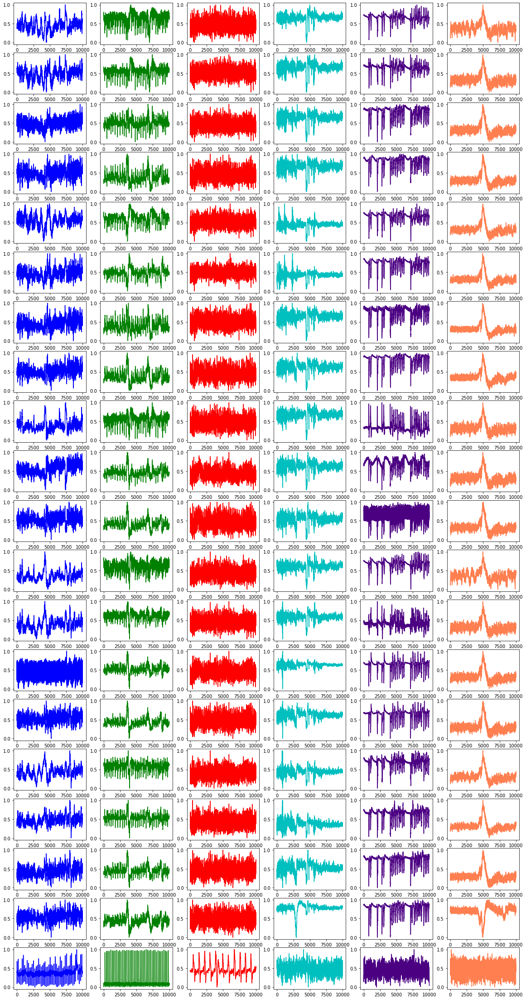

In [74]:
col_list = test_eeg.columns
eeg_list = [other_sub2, lpd_sub2, gpd_sub2, lrda_sub2, grda_sub2, seizure_sub2]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(20, 6)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

### Comparing Each Brain Activity Type with Seizure Activity  
  
The color key is the same as above.

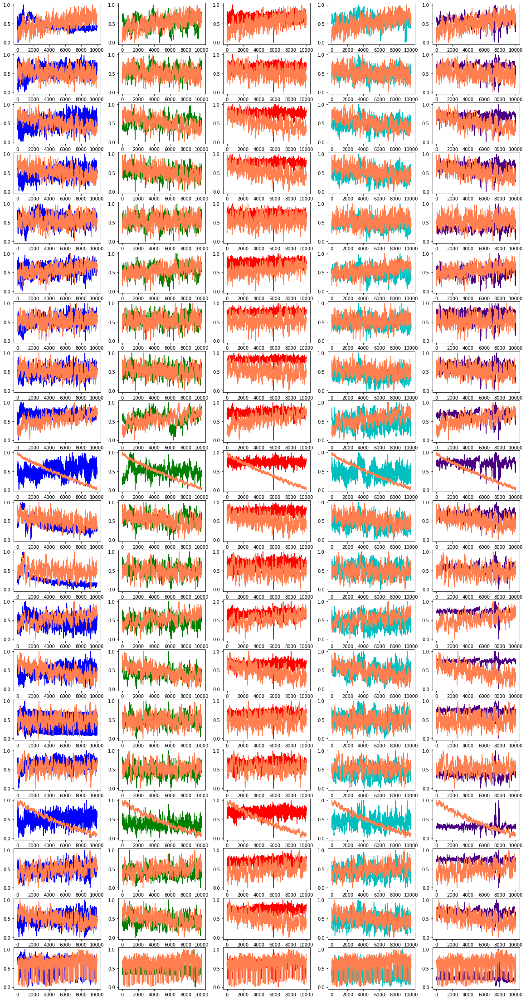

In [75]:
col_list = test_eeg.columns
eeg_list = [other_sub3, lpd_sub3, gpd_sub3, lrda_sub3, grda_sub3]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        axs[i][j].plot(seizure_sub3[col_list[i]], color = 'coral')
        
plt.show()

### Comparing Sub EEGs Within Each Target Class

##### Key:  
**Blue** - Sub EEG 1  
**Green** - Sub EEG 2  
**Red** - Sub EEG 3  
**Cyan** - Sub EEG 4  
**Purple** - Sub EEG 5

**Other**

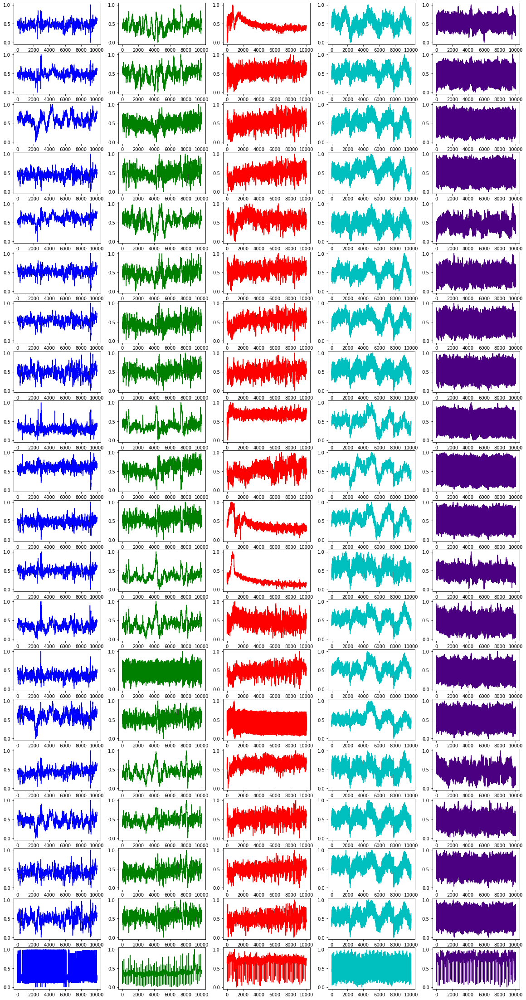

In [76]:
col_list = test_eeg.columns
eeg_list = [other_sub1, other_sub2, other_sub3, other_sub4, other_sub5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

When dealing with EEG data, the noisiness of the data is brought up and given as the reason why the raw data can't be used without some kind of transformation and feature extraction done. These plots show how variable sub EEGs can be despite having the same activity classification.

**LPD**

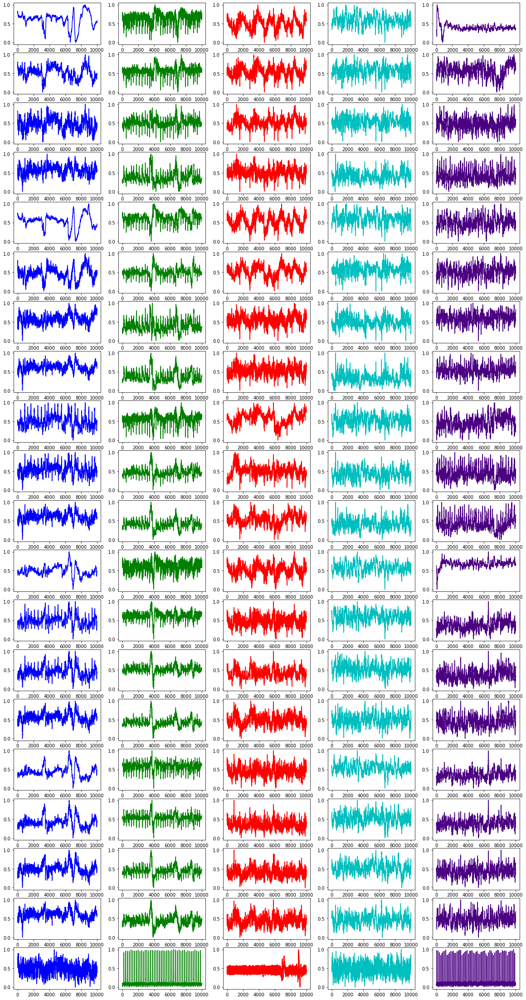

In [77]:
col_list = test_eeg.columns
eeg_list = [lpd_sub1, lpd_sub2, lpd_sub3, lpd_sub4, lpd_sub5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

**GPD**

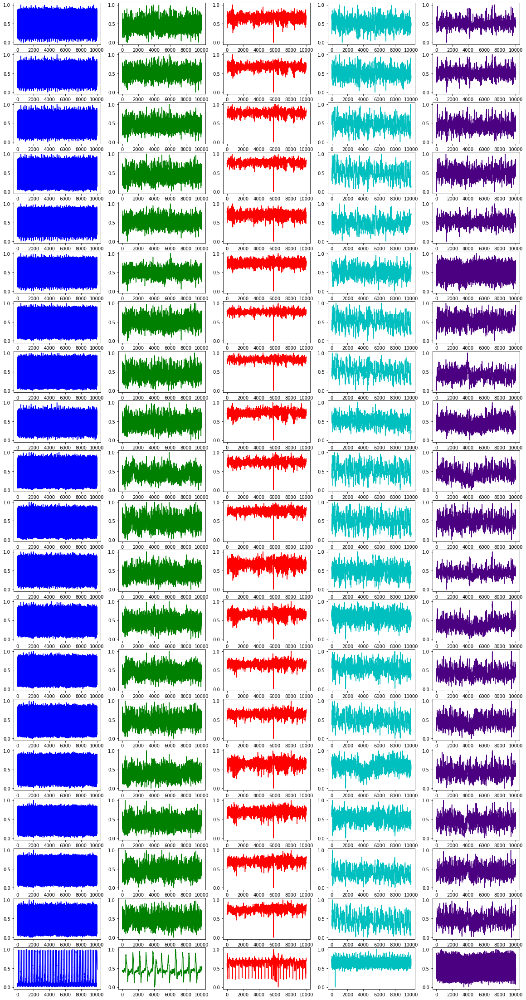

In [78]:
col_list = test_eeg.columns
eeg_list = [gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

The first sub EEG (blue) has extreme values in every column at every time point. This is likely due to some kind of error recording the results of the EEG.

**LRDA**

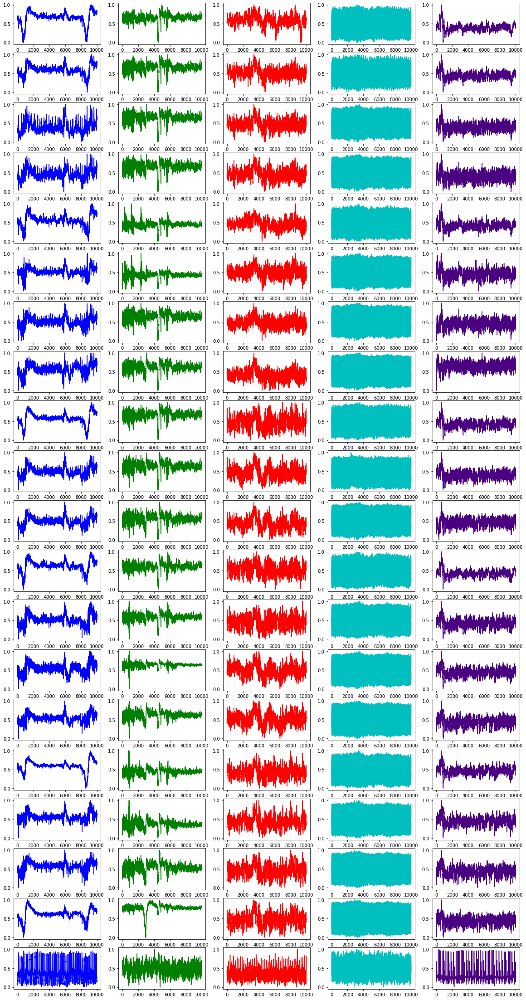

In [79]:
col_list = test_eeg.columns
eeg_list = [lrda_sub1, lrda_sub2, lrda_sub3, lrda_sub4, lrda_sub5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

Here it's the fourth sub EEG that seems to have errors.

**GRDA**

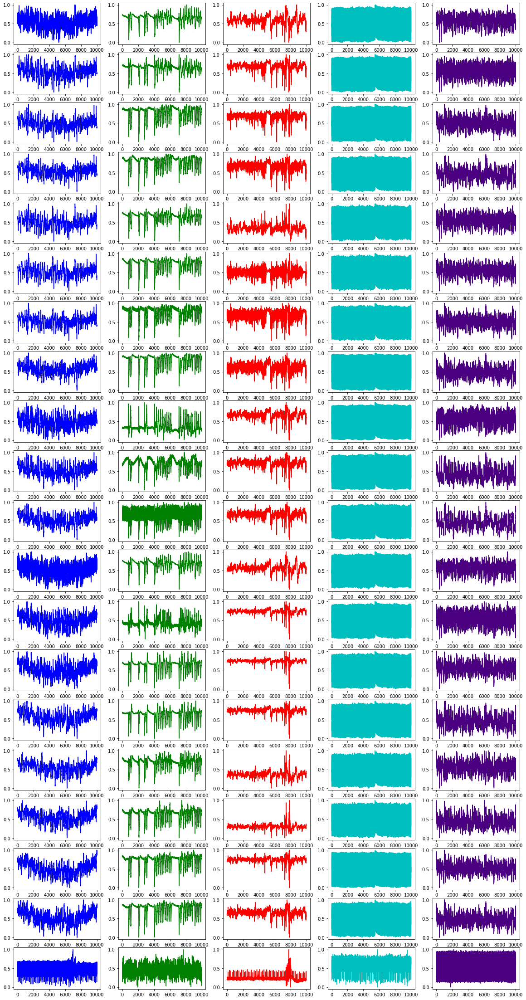

In [80]:
col_list = test_eeg.columns
eeg_list = [grda_sub1, grda_sub2, grda_sub3, grda_sub4, grda_sub5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

Again, it's the fourth sub EEG with this problem.

**Seizure**

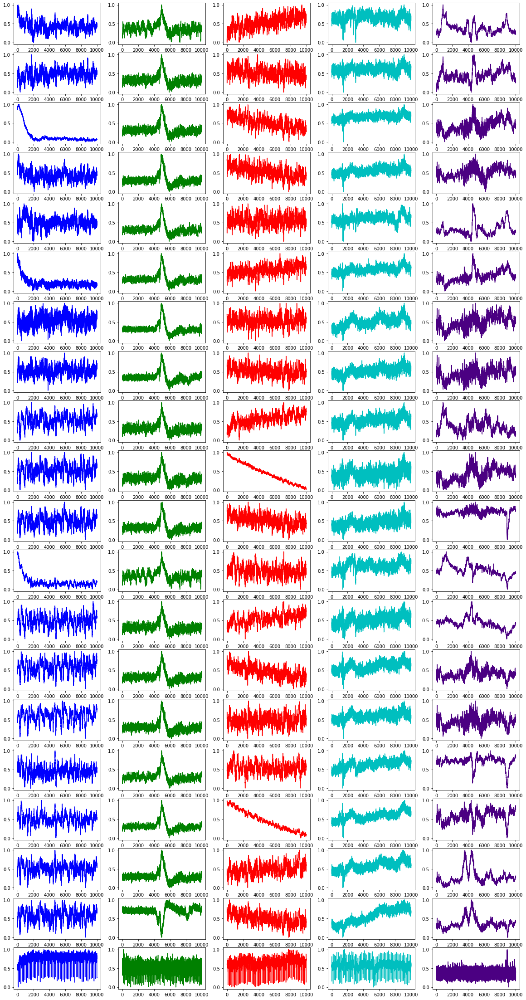

In [81]:
col_list = test_eeg.columns
eeg_list = [seizure_sub1, seizure_sub2, seizure_sub3, seizure_sub4, seizure_sub5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

In [82]:
other_standard = get_sub_eeg(other_df, 100)
lpd_standard = get_sub_eeg(lpd_df, 100)
gpd_standard = get_sub_eeg(gpd_df, 100)
lrda_standard = get_sub_eeg(lrda_df, 100)
grda_standard = get_sub_eeg(grda_df, 100)
seizure_standard = get_sub_eeg(seizure_df, 100)

In [83]:
other_standard = replace_nulls(other_standard)
lpd_standard = replace_nulls(lpd_standard)
gpd_standard = replace_nulls(gpd_standard)
lrda_standard = replace_nulls(lrda_standard)
grda_standard = replace_nulls(grda_standard)
seizure_standard = replace_nulls(seizure_standard)

In [84]:
other_standard = standardize(other_standard)
lpd_standard = standardize(lpd_standard)
gpd_standard = standardize(gpd_standard)
lrda_standard = standardize(lrda_standard)
grda_standard = standardize(grda_standard)
seizure_standard = standardize(seizure_standard)

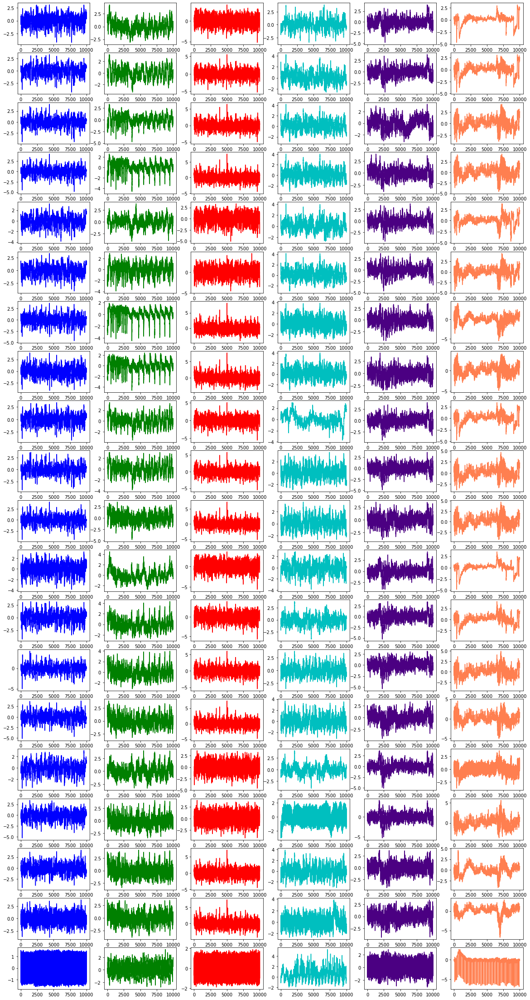

In [85]:
col_list = test_eeg.columns
eeg_list = [other_standard, lpd_standard, gpd_standard, lrda_standard, grda_standard, seizure_standard]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(20, 6)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

In [86]:
other_minmax = get_sub_eeg(other_df, 100)
lpd_minmax = get_sub_eeg(lpd_df, 100)
gpd_minmax = get_sub_eeg(gpd_df, 100)
lrda_minmax = get_sub_eeg(lrda_df, 100)
grda_minmax = get_sub_eeg(grda_df, 100)
seizure_minmax = get_sub_eeg(seizure_df, 100)

In [87]:
other_minmax = scale(other_minmax)
lpd_minmax = scale(lpd_minmax)
gpd_minmax = scale(gpd_minmax)
lrda_minmax = scale(lrda_minmax)
grda_minmax = scale(grda_minmax)
seizure_minmax = scale(seizure_minmax)

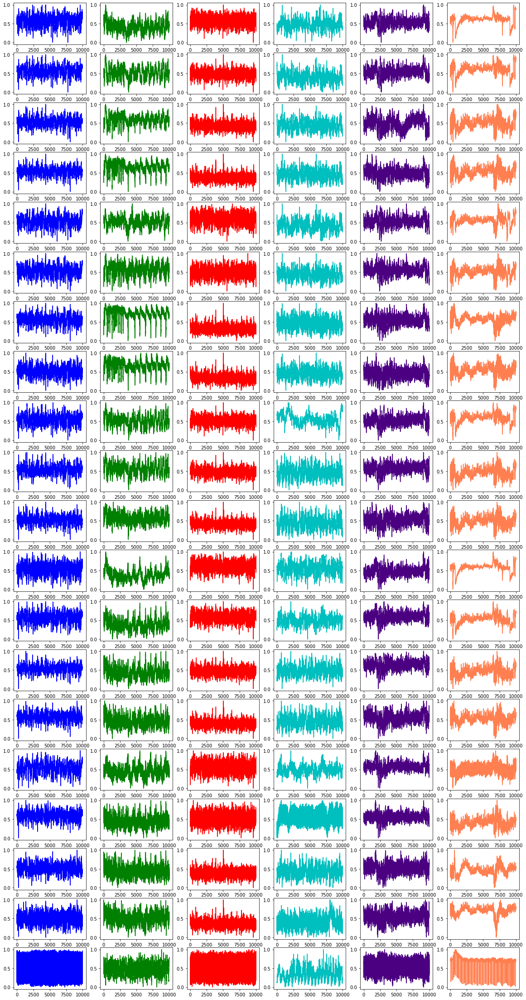

In [88]:
col_list = test_eeg.columns
eeg_list = [other_minmax, lpd_minmax, gpd_minmax, lrda_minmax, grda_minmax, seizure_minmax]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(20, 6)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

On the two plots above, I plotted the same set of sub EEGs across activity type using two different scaling methods. The first is standardization and the second is minmax scaling. I had been using the minmax scaler because I didn't want to change the shape of my data, but it doesn't really seem to change my data very much in that sense. Standardization should be better then because some of the functions and transformations used later work best after standardization.

### One More Set of Plots  
  
Before working on the feature extraction part of this problem, I want to generate sub EEGs for each class which may be more representative of the overall data for that class. To do this, I'll take in 1000 sub EEGs for each class and average them to get an average sub EEG for that class. Then I'll plot these to see how things change from what's been seen in the above plots.

This function checks for null values in the sub EEG.

In [89]:
def has_null(sub_eeg):
    col_sum = pd.isnull(sub_eeg).sum()
    null_sum = sum(col_sum)
    if null_sum > 0:
        return True
    else:
        False

This function takes a specified row and gets the sub EEG for that row.

This function takes in a specified number of rows, gets the sub EEG for those rows, adds them together, and then calculates the average.

In [90]:
def get_avg_eeg(data, num_rows):
    z = np.zeros((10000, 20))
    z = pd.DataFrame(z, columns = test_eeg.columns)
    for i in range(num_rows):
        sub_eeg = get_sub_eeg(data, i)
        if has_null(sub_eeg):
            sub_eeg = replace_nulls(sub_eeg)
        sub_eeg = scale(sub_eeg)
        z += sub_eeg
    avg_eeg = z / num_rows
    return avg_eeg

In [91]:
other_avg = get_avg_eeg(other_df, 1000)
lpd_avg = get_avg_eeg(lpd_df, 1000)
gpd_avg = get_avg_eeg(gpd_df, 1000)
lrda_avg = get_avg_eeg(lrda_df, 1000)
grda_avg = get_avg_eeg(grda_df, 1000)
seizure_avg = get_avg_eeg(seizure_df, 1000)

##### Key:  
  
**Blue** - Other  
**Green** - LPD  
**Red** - GPD  
**Cyan** - LRDA  
**Purple** - GRDA  
**Coral** - Seizure

In [92]:
mins = []
for col in seizure_avg.columns:
    mins.append(min(seizure_avg[col]))

In [93]:
maxs = []
for col in other_avg.columns:
    maxs.append(max(seizure_avg[col]))

In [94]:
max(maxs)

0.5415509101599455

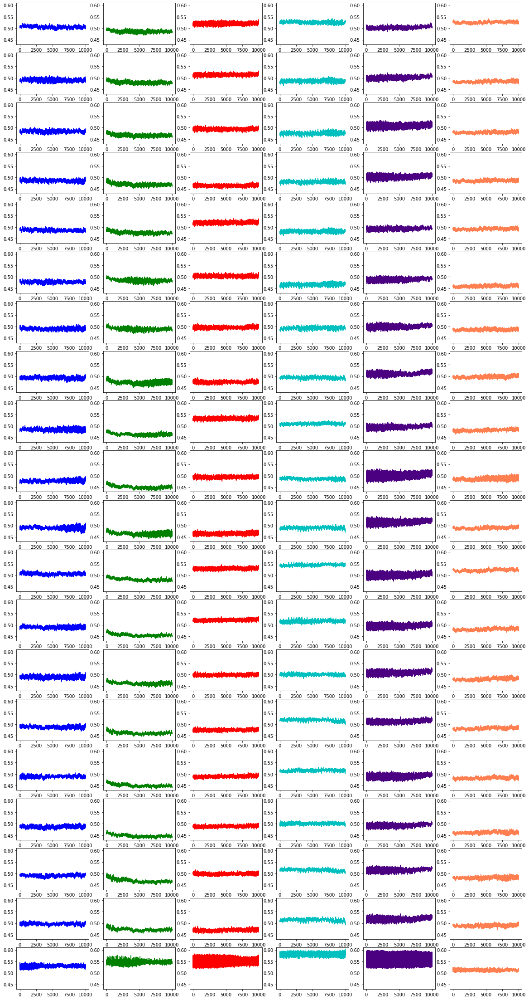

In [95]:
col_list = test_eeg.columns
eeg_list = [other_avg, lpd_avg, gpd_avg, lrda_avg, grda_avg, seizure_avg]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(20, 6)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(col_list)):
    for j in range(len(eeg_list)):
        axs[i][j].set_ylim(0.43, 0.61)
        axs[i][j].plot(eeg_list[j][col_list[i]], color = colors[j])
        
plt.show()

In order to better visualize the results above, I need to set the y axis to being from 0 to 1 instead of the limited range shown. There do appear to be trends, however. For example, the average seizure data shows a signal that gets larger over time. The average GRDA data shows a signal that starts large and gets smaller over time. The LPD data shows a thinner signal throughout that starts at higher values and decreases. In other words, the difference between high and low points doesn't appear to change as much as for seizure and GRDA activity. The interesting thing for the LPD signal is that as time moves forward, the averages signal decreases.

#### Checking Distribution of Target Variable After Trimming Dataset Different Amounts  
  
The reason to do this is that I was having difficulty loading in all of the EEGs before. Kernel dies when I try doing that. Processing them all individually will involve loading in the EEG, extracting the row's sub EEG, processing that sub EEG's data, passing that processed sub EEG to functions which will calculate feature data for it, and then appending that data into a list which will be turned into a dataframe to use for multiclass classification. I think I'm likely to run into the same problem doing things this way as I did trying to just load the EEGs into a list up front. This means I'll likely need to cut the overall dataset down significantly in order to do the problem.

In [96]:
training.shape[0] * 0.3

31941.0

In [97]:
df_10 = training.iloc[0:10647] # 10 Percent of Training Dataset
df_20 = training.iloc[0:21294] # 20 Percent of Training Dataset
df_30 = training.iloc[0:31941] # 30 Percent of Training Dataset

In [98]:
training.expert_consensus.value_counts(normalize = True)

expert_consensus
Seizure    0.195802
GRDA       0.176820
Other      0.175730
GPD        0.156532
LRDA       0.156100
LPD        0.139016
Name: proportion, dtype: float64

In [99]:
df_10.expert_consensus.value_counts(normalize = True)

expert_consensus
Seizure    0.207288
GRDA       0.169907
LRDA       0.163896
GPD        0.156570
Other      0.153377
LPD        0.148962
Name: proportion, dtype: float64

In [100]:
df_20.expert_consensus.value_counts(normalize = True)

expert_consensus
Seizure    0.201606
GRDA       0.182728
Other      0.165399
GPD        0.158965
LRDA       0.157603
LPD        0.133700
Name: proportion, dtype: float64

In [101]:
df_30.expert_consensus.value_counts(normalize = True)

expert_consensus
Seizure    0.198554
GPD        0.176200
Other      0.169719
LRDA       0.164741
GRDA       0.162518
LPD        0.128268
Name: proportion, dtype: float64

In [102]:
df_10.expert_consensus.value_counts()

expert_consensus
Seizure    2207
GRDA       1809
LRDA       1745
GPD        1667
Other      1633
LPD        1586
Name: count, dtype: int64

I can try the 20 and 30 percent datasets first, but the 10 percent dataset has a distribution similar to the full dataset and has enough rows in each category of the target variable to work with.

In [103]:
df_10

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10642,862310335,0,0.0,200303629,77,1194.0,2962311535,57480,Other,0,0,0,0,0,1
10643,3671962049,0,0.0,200303629,78,1466.0,323074244,57480,Other,0,0,0,0,0,1
10644,2357552740,0,0.0,200303629,79,1874.0,1993344137,57480,Seizure,3,0,0,0,0,0
10645,2357552740,1,6.0,200303629,80,1880.0,3714973024,57480,Seizure,3,0,0,0,0,0


In [104]:
def get_sub_eeg(data, row):
    eeg_id = data['eeg_id'][row]
    eeg = pd.read_parquet('train_eegs/{}.parquet'.format(eeg_id), engine = 'pyarrow')
    first_row = data['eeg_label_offset_seconds'][row] * 200
    first_row = int(first_row)
    last_row = first_row + 10000
    sub_eeg = eeg.iloc[first_row: last_row].reset_index()
    sub_eeg = sub_eeg.drop(columns = 'index')
    return sub_eeg

In [105]:
def peak_to_peak(data):
    first_row = [0, 2000, 4000, 6000, 8000]
    ptps = []
    for i in range(len(first_row)):
        segment = data.iloc[first_row[i]: (first_row[i] + 2000)]
        ptps.append(np.ptp(segment))
    return ptps

### Feature Building

One feature or set of features is statistical features like mean of the raw signal, variance of the raw signal, etc. The problem with this is that the EEG data has 20 columns. It wouldn't make much sense to take the mean of each individual column and then the mean of those column means in order to get a single datapoint, but without reducing the dimensions of the EEG data in some way, the result will be 20 datapoints for mean, 20 for variance, etc. If just using mean and variance and not using things like kurtosis and skewness, that's 40 features.  
  
I considered looking at column correlations by getting the correlation matrix for each sub EEG, averaging them together, and then seeing if combining some columns made sense, but I think the best thing to do is to go ahead and perform PCA, ICA, and Welch on the EEG data and then use the statistical feature idea with some of that data. The statistical feature I'll still use with the raw EEG data is the peak to peak feature. The average EEGs for each class show some trends in how the difference between high and low points change over time, so I want to divide the sub EEG recordings into different time intervals (maybe every 10 seconds) and record the peak to peak for that time interval.

In [106]:
def peak_to_peak(data):
    first_row = [0, 2000, 4000, 6000, 8000]
    ptps = []
    for i in range(len(first_row)):
        segment = data.iloc[first_row[i]: (first_row[i] + 2000)]
        ptp_list = []
        for col in test_eeg.columns:
            if col != 'EKG': # EKG data tends to be the least similar to the rest of the data
                ptp_list.append(np.ptp(segment[col]))
        ptps.append(ptp_list)
    return np.asarray(ptps)

Below I'm not calculating all of my ptp feature data. I'm just calculating data for the first 5000 sub EEGs in the training data. I get the ptp for each column except for the electrocardiogram column (EKG) because the EKG data is the least similar to the rest of the data. I get these ptp values in 10 second intervals. Then I take the mean of the column ptps for each interval. After that data is gathered, I plot the results by activity type for each 10 second interval.

In [107]:
ptp_data = []
for i in range(5000):
    sub_eeg = get_sub_eeg(training, i)
    interval_ptps = []
    ptps = peak_to_peak(sub_eeg)
    for i in range(len(ptps)):
        interval_ptps.append(ptps[i].mean())
    ptp_data.append(interval_ptps)

In [108]:
df_ptp = pd.DataFrame(ptp_data, columns = ['0-10s_ptp', '10-20s_ptp', '20-30s_ptp', '30-40s_ptp', '40-50s_ptp'])

In [109]:
df_ptp

,0-10s_ptp,10-20s_ptp,20-30s_ptp,30-40s_ptp,40-50s_ptp
0,121.758942,125.693703,153.972107,187.312622,192.286331
1,123.229477,137.614212,177.511047,209.594208,207.971069
2,122.875793,141.203690,199.053680,192.555252,211.474213
3,141.203690,199.053680,192.555252,211.474213,264.636841
4,169.758957,205.029480,198.810013,238.769974,208.774734
...,...,...,...,...,...
4995,1735.827271,1608.140991,1575.262085,1646.424194,1811.911621
4996,1741.116333,1591.070557,1566.952148,1768.848511,1787.959961
4997,1640.197266,1576.058960,1586.735840,1817.369507,1640.881714
4998,1608.140991,1575.262085,1646.424194,1811.911621,1633.172852


In [110]:
activity = [training['expert_consensus'][i] for i in range(5000)]

In [111]:
df_ptp['activity'] = activity

In [112]:
df_ptp

,0-10s_ptp,10-20s_ptp,20-30s_ptp,30-40s_ptp,40-50s_ptp,activity
0,121.758942,125.693703,153.972107,187.312622,192.286331,Seizure
1,123.229477,137.614212,177.511047,209.594208,207.971069,Seizure
2,122.875793,141.203690,199.053680,192.555252,211.474213,Seizure
3,141.203690,199.053680,192.555252,211.474213,264.636841,Seizure
4,169.758957,205.029480,198.810013,238.769974,208.774734,Seizure
...,...,...,...,...,...,...
4995,1735.827271,1608.140991,1575.262085,1646.424194,1811.911621,GRDA
4996,1741.116333,1591.070557,1566.952148,1768.848511,1787.959961,GRDA
4997,1640.197266,1576.058960,1586.735840,1817.369507,1640.881714,GRDA
4998,1608.140991,1575.262085,1646.424194,1811.911621,1633.172852,GRDA


In [113]:
df_ptp['activity'].value_counts()

activity
GPD        1257
GRDA        979
LRDA        818
Seizure     734
LPD         644
Other       568
Name: count, dtype: int64

In [114]:
other_ptp = df_ptp[df_ptp['activity'] == 'Other'].reset_index()
lpd_ptp = df_ptp[df_ptp['activity'] == 'LPD'].reset_index()
gpd_ptp = df_ptp[df_ptp['activity'] == 'GPD'].reset_index()
lrda_ptp = df_ptp[df_ptp['activity'] == 'LRDA'].reset_index()
grda_ptp = df_ptp[df_ptp['activity'] == 'GRDA'].reset_index()
seizure_ptp = df_ptp[df_ptp['activity'] == 'Seizure'].reset_index()

In [115]:
other_ptp = other_ptp.drop(columns = 'index')
lpd_ptp = lpd_ptp.drop(columns = 'index')
gpd_ptp = gpd_ptp.drop(columns = 'index')
lrda_ptp = lrda_ptp.drop(columns = 'index')
grda_ptp = grda_ptp.drop(columns = 'index')
seizure_ptp = seizure_ptp.drop(columns = 'index')

In [116]:
ptp_columns = df_ptp.drop(columns = 'activity').columns

In [117]:
ptp_columns

Index(['0-10s_ptp', '10-20s_ptp', '20-30s_ptp', '30-40s_ptp', '40-50s_ptp'], dtype='object')

A few trends to note in the plots below are the change in the distribution of **seizure** data. You get larger ptp values in starting in the 20-30s range. This fits what was mentioned about the plots of the average sub EEGs.  
  
The **GRDA** distribution tends to be in the lower range of ptp values except for during the middle of the EEG recording (20-30s).  
  
The **Other** distribution tends to be in the higher range across the EEG recording.  
  
The **LRDA** distribution is also seen on the higher end until the last 10 second interval of the EEG recording.  
  
The **GPD** distribution tends to be on the lower end, but is seen on the higher end in the last 10 second interval more than some of the other activity types.  
  
The **LPD** distribution also tends to be on the lower end relative to the other activity types. This matches what I mentioned about the average sub EEG plots I did above.

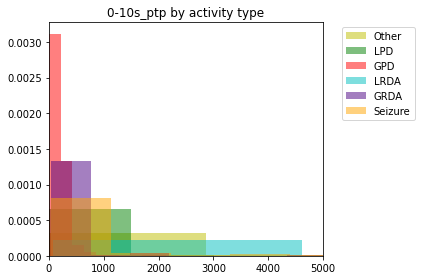

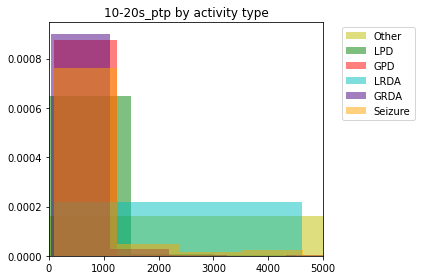

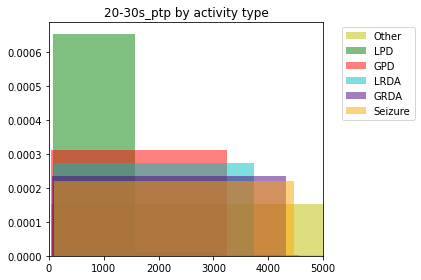

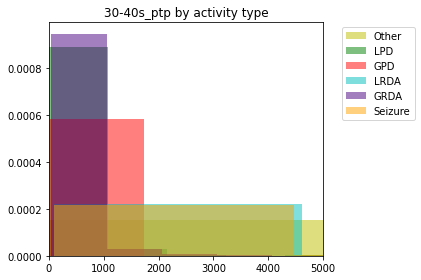

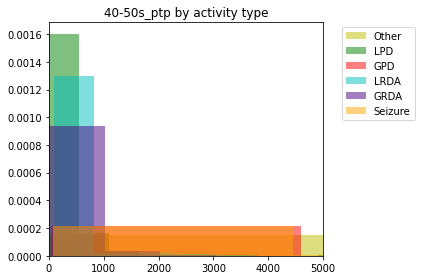

In [118]:
for col in ptp_columns:
    plt.hist(other_ptp[col], density = True, color = 'y', label = 'Other', alpha = 0.5)
    plt.hist(lpd_ptp[col], density = True, color = 'g', label = 'LPD', alpha = 0.5)
    plt.hist(gpd_ptp[col], density = True, color = 'r', label = 'GPD', alpha = 0.5)
    plt.hist(lrda_ptp[col], density = True, color = 'c', label = 'LRDA', alpha = 0.5)
    plt.hist(grda_ptp[col], density = True, color = 'indigo', label = 'GRDA', alpha = 0.5)
    plt.hist(seizure_ptp[col], density = True, color = 'orange', label = 'Seizure', alpha = 0.5)
    plt.xlim(0, 5000)
    plt.title('{} by activity type'.format(col))
    plt.legend(bbox_to_anchor = (1.05, 1), loc = 'upper left')
    plt.tight_layout()
    plt.show()

Below I get the ptp values for each column across the whole sub EEG recording instead of splitting the recording up by time interval. If there are specific electrode locations that stand out from the rest, it might make sense to use those at features.

In [119]:
col_ptps = []
for i in range(5000):
    sub_eeg = get_sub_eeg(training, i)
    col_ptp_list = []
    for col in test_eeg.columns:
        col_ptp_list.append(np.ptp(sub_eeg[col]))
    col_ptps.append(col_ptp_list)

In [120]:
len(col_ptps), len(col_ptps[0])

(5000, 20)

In [121]:
df_col_ptp = pd.DataFrame(col_ptps, columns = test_eeg.columns)

In [122]:
df_col_ptp['activity'] = activity

In [123]:
df_col_ptp

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,...,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG,activity
0,175.510010,167.589996,236.559998,145.750000,209.829987,157.089996,114.770004,227.589981,399.209991,262.200012,...,214.669998,228.860001,275.379974,493.660004,259.690002,300.619995,235.300003,160.279999,1825.840088,Seizure
1,201.370010,217.149994,258.760010,151.059998,222.130005,178.100006,123.559998,227.589981,428.670013,297.450012,...,214.669998,230.729996,312.219971,560.559998,286.169983,329.730011,260.330017,160.279999,1825.840088,Seizure
2,201.370010,217.369995,281.279999,151.059998,248.650009,187.410004,123.559998,227.589981,428.670013,297.450012,...,214.669998,230.729996,330.200012,560.559998,286.169983,329.730011,260.330017,160.279999,1825.840088,Seizure
3,222.230011,394.380005,666.750000,243.750000,276.880005,275.669983,133.329987,227.589981,461.709991,315.230011,...,219.070007,246.870010,382.659973,560.559998,288.100006,329.730011,293.950012,171.990005,1825.840088,Seizure
4,222.230011,394.380005,666.750000,243.750000,276.880005,275.669983,142.690002,231.489990,476.109985,316.620026,...,219.070007,246.870010,382.659973,560.559998,288.100006,329.730011,293.950012,171.990005,1825.840088,Seizure
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,966.319946,1001.150024,1134.069946,818.250000,1054.310059,971.369995,767.469971,694.369995,844.570007,824.099976,...,20027.750000,923.790039,885.510010,731.320007,1107.479980,740.089966,713.510010,705.270020,90910.984375,GRDA
4996,966.319946,1001.150024,1134.069946,818.250000,1054.310059,971.369995,767.469971,694.369995,844.570007,824.099976,...,20027.750000,923.790039,885.510010,731.320007,1002.739990,739.829956,713.510010,705.270020,90910.984375,GRDA
4997,966.319946,1001.150024,1134.069946,818.250000,1054.310059,971.369995,748.599976,694.369995,844.570007,824.099976,...,19433.070312,923.790039,885.510010,731.320007,1004.329956,739.829956,713.510010,705.270020,45951.011719,GRDA
4998,966.319946,1001.150024,1134.069946,818.250000,1054.310059,971.369995,748.599976,694.369995,811.070007,824.099976,...,19433.070312,923.790039,885.510010,731.320007,1004.329956,739.829956,713.510010,705.270020,45951.539062,GRDA


In [124]:
other_col_ptp = df_col_ptp[df_col_ptp['activity'] == 'Other'].reset_index()
lpd_col_ptp = df_col_ptp[df_col_ptp['activity'] == 'LPD'].reset_index()
gpd_col_ptp = df_col_ptp[df_col_ptp['activity'] == 'GPD'].reset_index()
lrda_col_ptp = df_col_ptp[df_col_ptp['activity'] == 'LRDA'].reset_index()
grda_col_ptp = df_col_ptp[df_col_ptp['activity'] == 'GRDA'].reset_index()
seizure_col_ptp = df_col_ptp[df_col_ptp['activity'] == 'Seizure'].reset_index()

In [125]:
other_col_ptp = other_col_ptp.drop(columns = 'index')
lpd_col_ptp = lpd_col_ptp.drop(columns = 'index')
gpd_col_ptp = gpd_col_ptp.drop(columns = 'index')
lrda_col_ptp = lrda_col_ptp.drop(columns = 'index')
grda_col_ptp = grda_col_ptp.drop(columns = 'index')
seizure_col_ptp = seizure_col_ptp.drop(columns = 'index')

**LPD** is most prominent on the low end across nearly every column.  
  
**Fp1** is the electrode where the data stands out the most. That and the **EKG** data. The rest appears to be similar for each electrode plot.

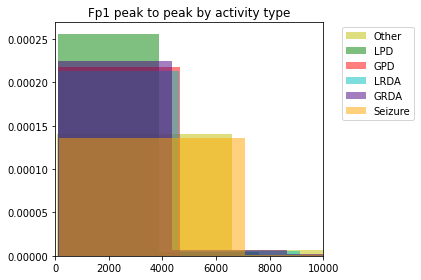

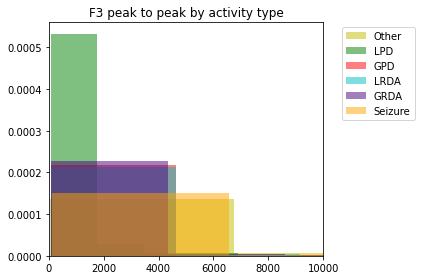

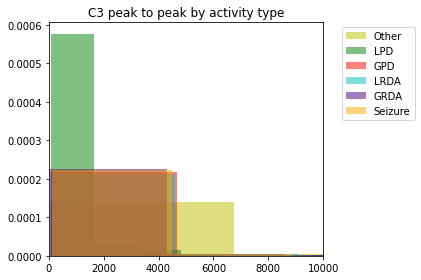

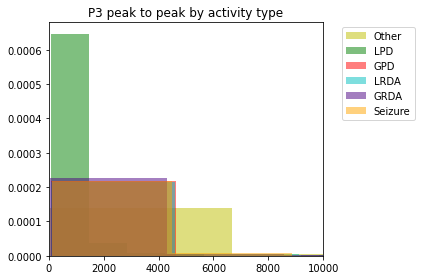

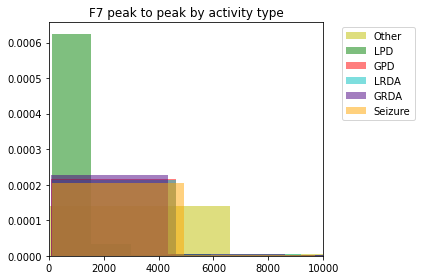

...

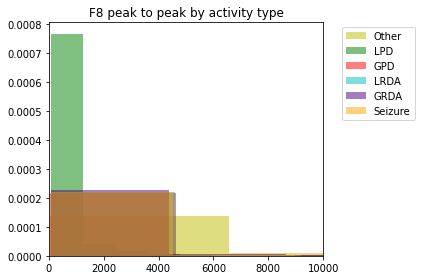

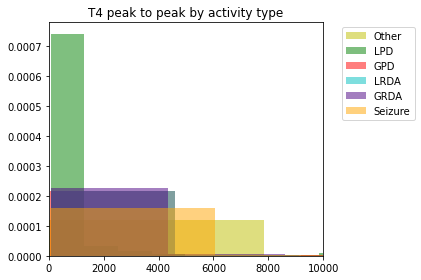

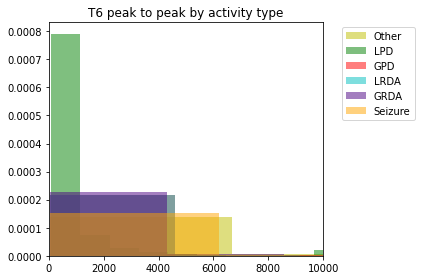

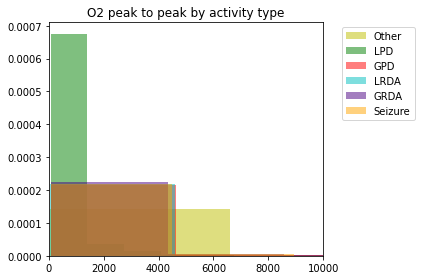

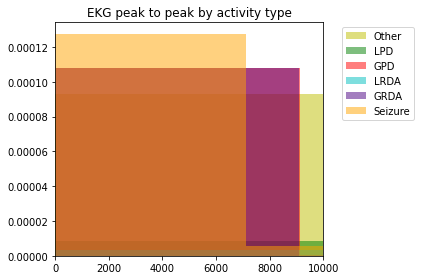

In [126]:
for col in test_eeg.columns:
    plt.hist(other_col_ptp[col], density = True, color = 'y', label = 'Other', alpha = 0.5)
    plt.hist(lpd_col_ptp[col], density = True, color = 'g', label = 'LPD', alpha = 0.5)
    plt.hist(gpd_col_ptp[col], density = True, color = 'r', label = 'GPD', alpha = 0.5)
    plt.hist(lrda_col_ptp[col], density = True, color = 'c', label = 'LRDA', alpha = 0.5)
    plt.hist(grda_col_ptp[col], density = True, color = 'indigo', label = 'GRDA', alpha = 0.5)
    plt.hist(seizure_col_ptp[col], density = True, color = 'orange', label = 'Seizure', alpha = 0.5)
    plt.xlim(0, 10000)
    plt.title('{} peak to peak by activity type'.format(col))
    plt.legend(bbox_to_anchor = (1.05, 1), loc = 'upper left')
    plt.tight_layout()
    plt.show()

I should reformat the above plots in a grid since there are 20 of them.

#### Scipy Welch

In [127]:
welch_eeg1 = get_sub_eeg(training, 20)

In [128]:
f, pxx = signal.welch(welch_eeg1['Fp1'], fs = 200)

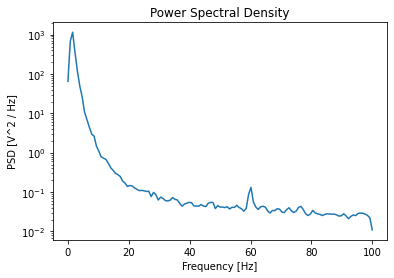

In [129]:
plt.semilogy(f, pxx)
plt.xlabel('Frequency [Hz]')
plt.ylabel('PSD [V^2 / Hz]')
plt.title('Power Spectral Density')
plt.show()

In [130]:
welch_eeg1 = replace_nulls(welch_eeg1)

In [131]:
standard = StandardScaler()

In [132]:
welch_eeg1 = standard.fit_transform(welch_eeg1)

In [133]:
welch_eeg1 = pd.DataFrame(welch_eeg1, columns = test_eeg.columns)

In [134]:
f2, pxx2 = signal.welch(welch_eeg1['Fp1'], fs = 200)

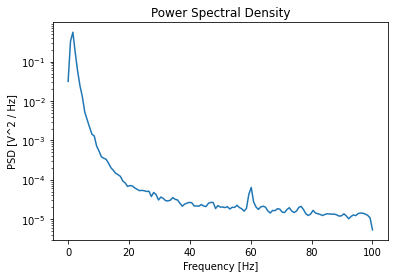

In [135]:
plt.semilogy(f2, pxx2)
plt.xlabel('Frequency [Hz]')
plt.ylabel('PSD [V^2 / Hz]')
plt.title('Power Spectral Density')
plt.show()

In [136]:
fpxx_list = []
for col in test_eeg.columns:
    f, pxx = signal.welch(welch_eeg1[col], fs = 200)
    fpxx_list.append((f, pxx))

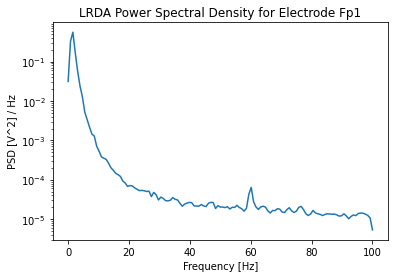

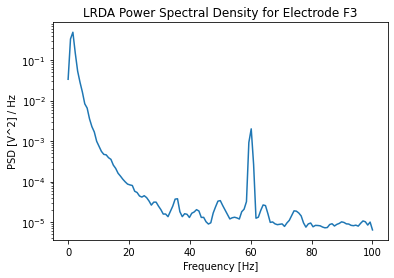

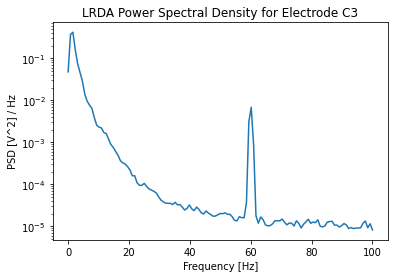

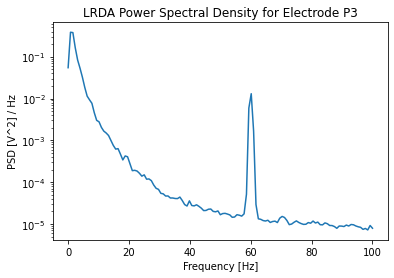

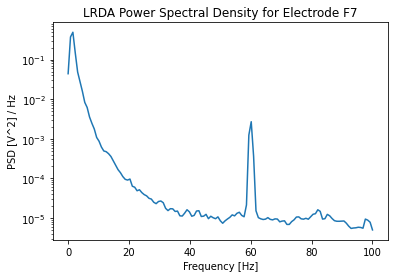

...

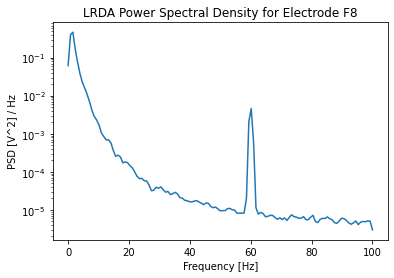

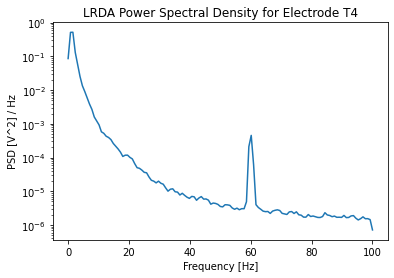

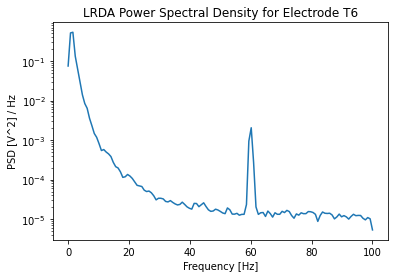

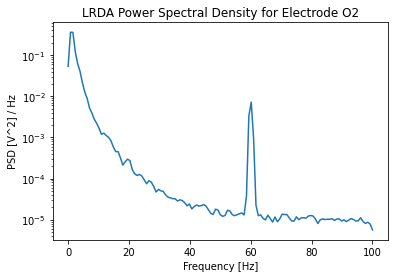

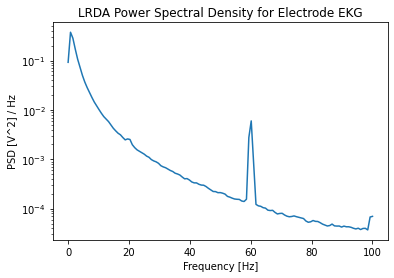

In [137]:
for i in range(len(fpxx_list)):
    plt.semilogy(fpxx_list[i][0], fpxx_list[i][1])
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('PSD [V^2] / Hz')
    plt.title('LRDA Power Spectral Density for Electrode {}'.format(test_eeg.columns[i]))
    plt.show()

For each column for this sub eeg I chose at random, the spike in the PSD plot is at 60 Hz.

In [138]:
training['expert_consensus'][20]

'LRDA'

That sub eeg was labelled as **LRDA** activity.

In [139]:
welch_eeg2 = get_sub_eeg(other_df, 25)
welch_eeg3 = get_sub_eeg(lpd_df, 25)
welch_eeg4 = get_sub_eeg(gpd_df, 25)
welch_eeg5 = get_sub_eeg(grda_df, 25)
welch_eeg6 = get_sub_eeg(seizure_df, 25)

In [140]:
welch_eeg2 = replace_nulls(welch_eeg2)
welch_eeg3 = replace_nulls(welch_eeg3)
welch_eeg4 = replace_nulls(welch_eeg4)
welch_eeg5 = replace_nulls(welch_eeg5)
welch_eeg6 = replace_nulls(welch_eeg6)

In [141]:
welch_eeg2 = standardize(welch_eeg2)
welch_eeg3 = standardize(welch_eeg3)
welch_eeg4 = standardize(welch_eeg4)
welch_eeg5 = standardize(welch_eeg5)
welch_eeg6 = standardize(welch_eeg6)

In [142]:
fpxx_list2 = []
for col in test_eeg.columns:
    f, pxx = signal.welch(welch_eeg2[col], fs = 200)
    fpxx_list2.append((f, pxx))

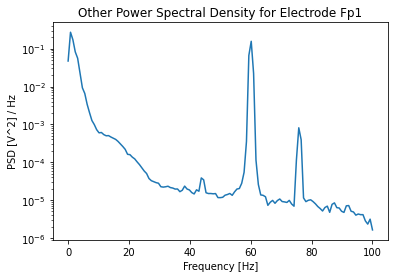

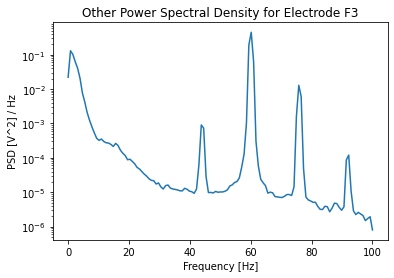

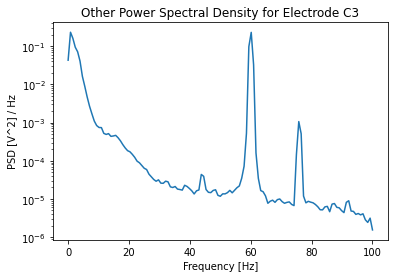

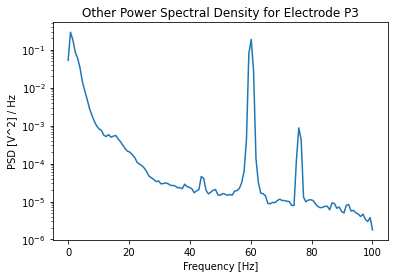

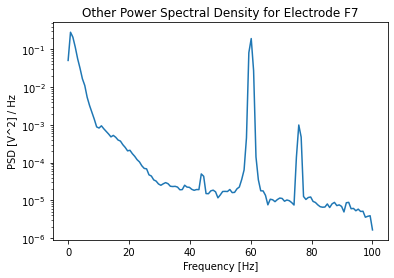

...

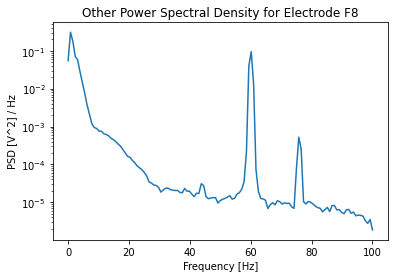

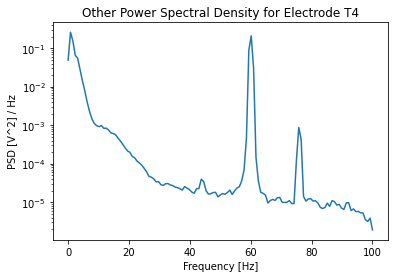

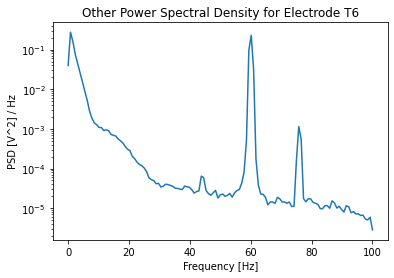

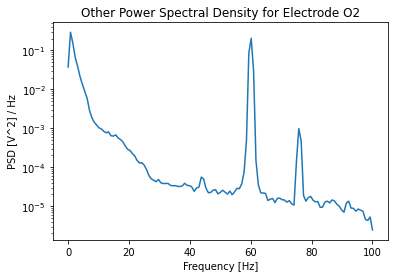

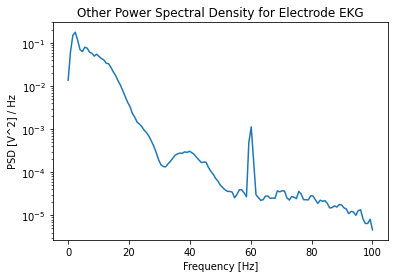

In [143]:
for i in range(len(fpxx_list2)):
    plt.semilogy(fpxx_list2[i][0], fpxx_list2[i][1])
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('PSD [V^2] / Hz')
    plt.title('Other Power Spectral Density for Electrode {}'.format(test_eeg.columns[i]))
    plt.show()

For this **Other** sub eeg, there are spikes at 60 and 80 Hz for most columns. Some columns have small spikes at a little over 40 Hz. There are a couple of columns with spikes close to 100 Hz.

In [144]:
fpxx_list3 = []
for col in test_eeg.columns:
    f, pxx = signal.welch(welch_eeg3[col], fs = 200)
    fpxx_list3.append((f, pxx))

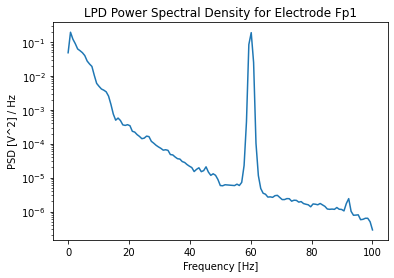

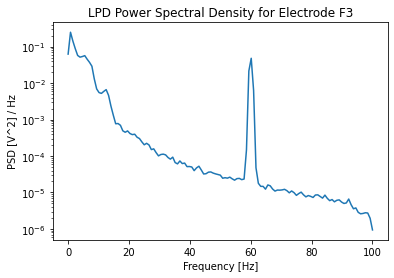

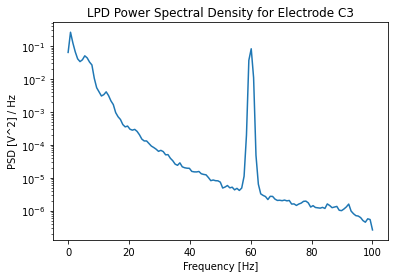

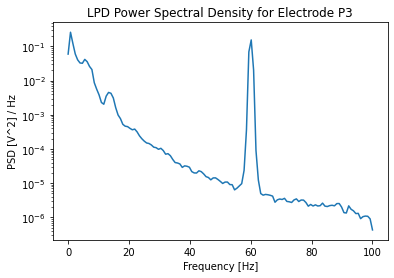

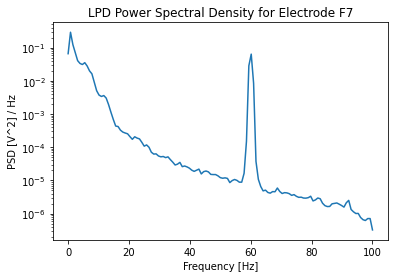

...

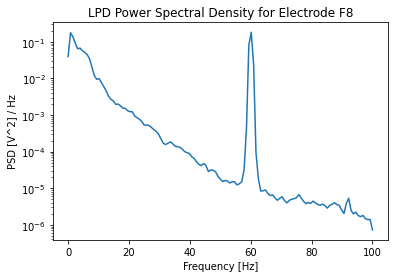

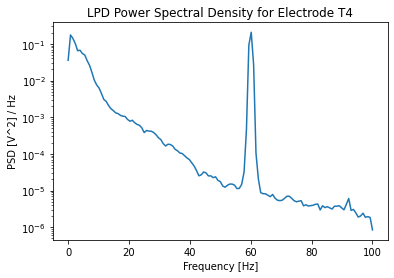

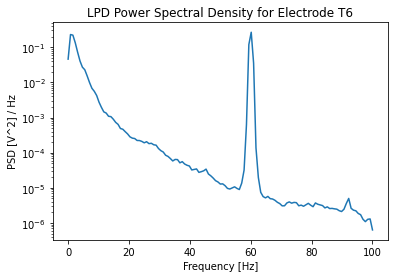

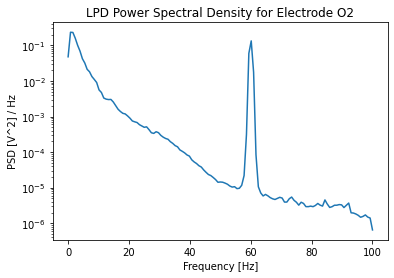

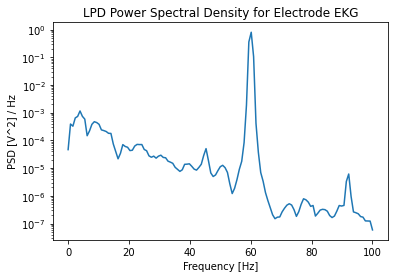

In [145]:
for i in range(len(fpxx_list3)):
    plt.semilogy(fpxx_list3[i][0], fpxx_list3[i][1])
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('PSD [V^2] / Hz')
    plt.title('LPD Power Spectral Density for Electrode {}'.format(test_eeg.columns[i]))
    plt.show()

For **LPD** the spikes are around 60 Hz. There are occasionally smaller spikes between 90 and 100 Hz.

In [146]:
fpxx_list4 = []
for col in test_eeg.columns:
    f, pxx = signal.welch(welch_eeg4[col], fs = 200)
    fpxx_list4.append((f, pxx))

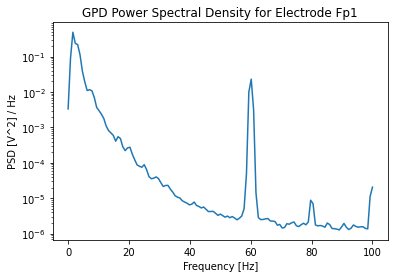

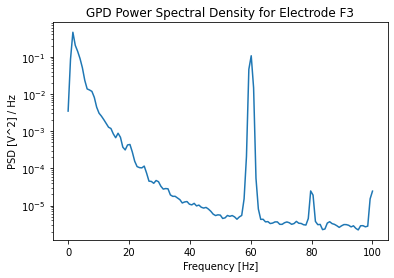

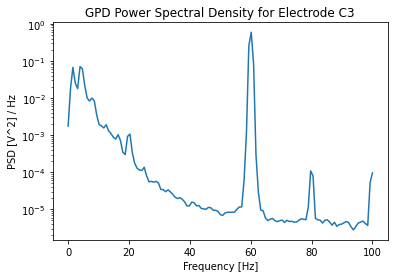

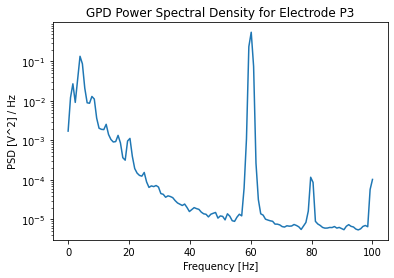

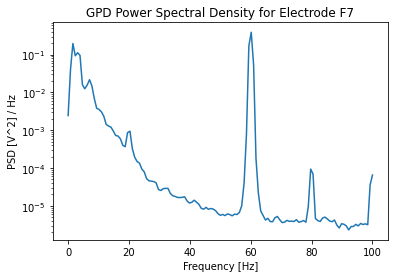

...

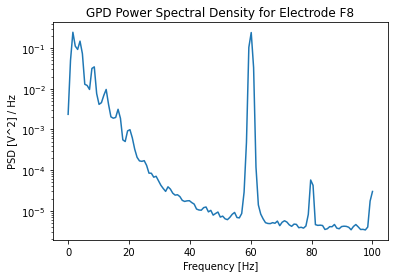

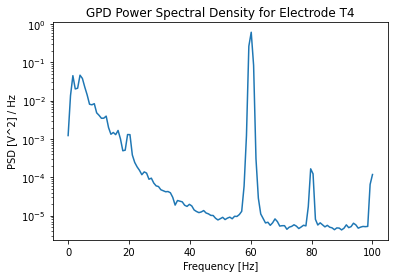

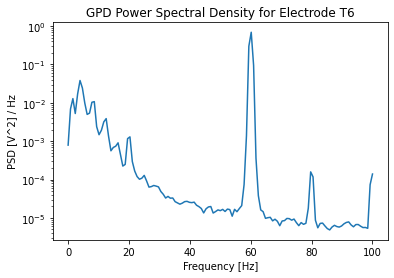

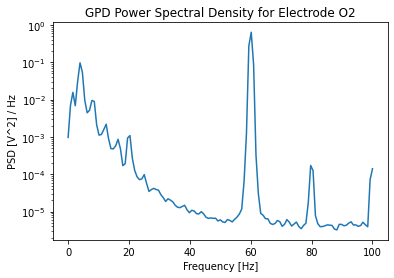

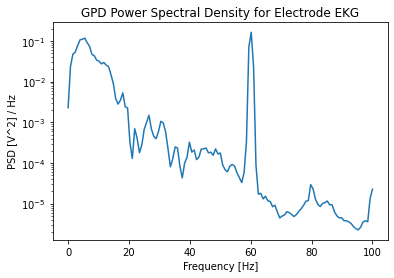

In [147]:
for i in range(len(fpxx_list4)):
    plt.semilogy(fpxx_list4[i][0], fpxx_list4[i][1])
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('PSD [V^2] / Hz')
    plt.title('GPD Power Spectral Density for Electrode {}'.format(test_eeg.columns[i]))
    plt.show()

For **GPD**, there are big spikes at 60 Hz again, then some medium spikes around 80 Hz, and the start of a spike at 100 Hz.

In [148]:
fpxx_list5 = []
for col in test_eeg.columns:
    f, pxx = signal.welch(welch_eeg5[col], fs = 200)
    fpxx_list5.append((f, pxx))

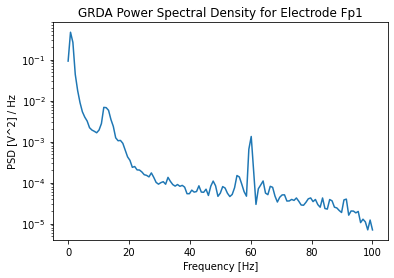

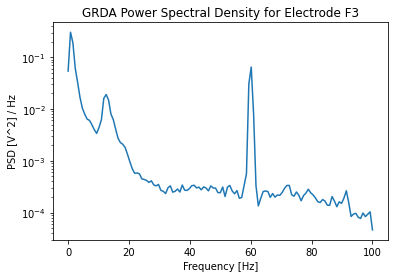

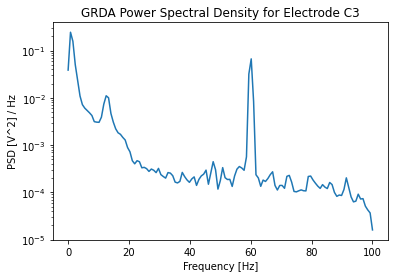

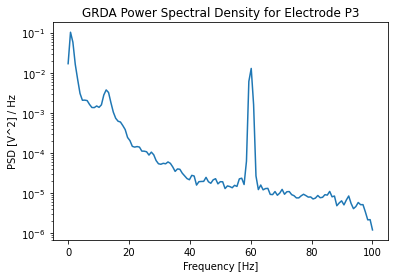

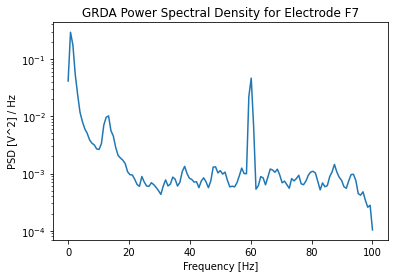

...

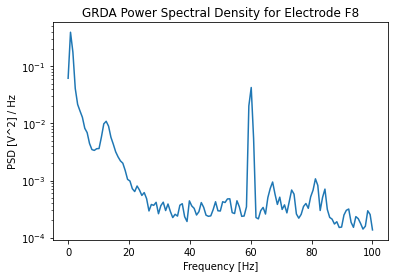

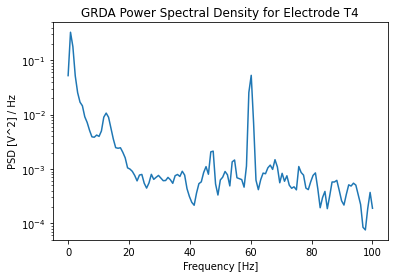

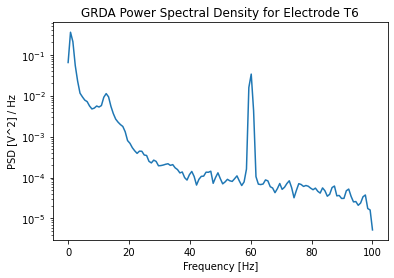

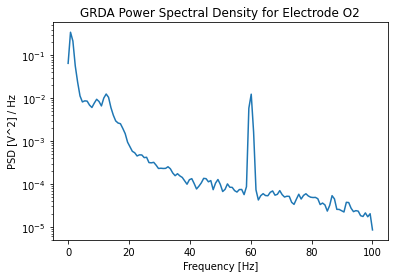

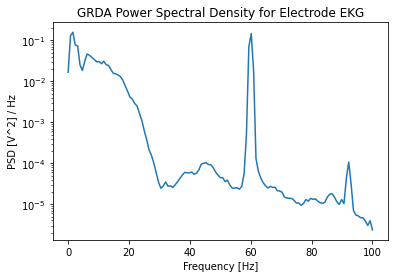

In [149]:
for i in range(len(fpxx_list5)):
    plt.semilogy(fpxx_list5[i][0], fpxx_list5[i][1])
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('PSD [V^2] / Hz')
    plt.title('GRDA Power Spectral Density for Electrode {}'.format(test_eeg.columns[i]))
    plt.show()

For **GRDA**, there is a large spike at 60 Hz and then smaller spikes around that for a number of columns from 40 to 60 Hz and from 60 to 100 Hz. 

In [150]:
fpxx_list6 = []
for col in test_eeg.columns:
    f, pxx = signal.welch(welch_eeg6[col], fs = 200)
    fpxx_list6.append((f, pxx))

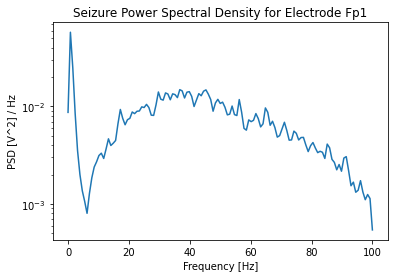

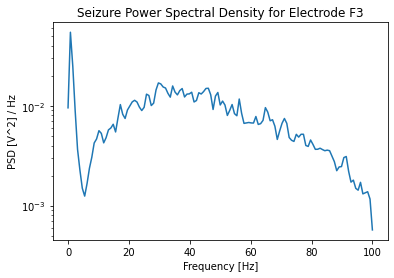

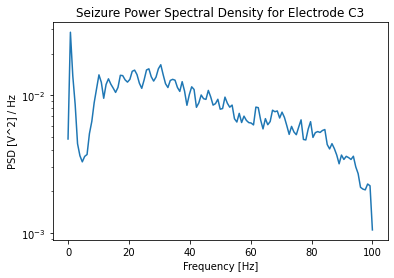

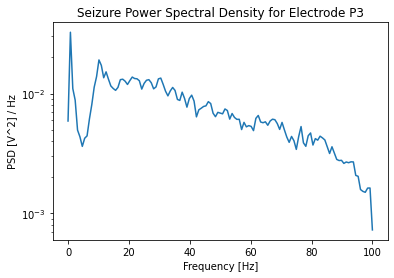

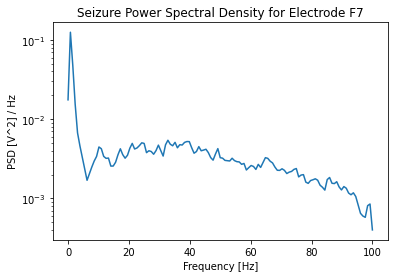

...

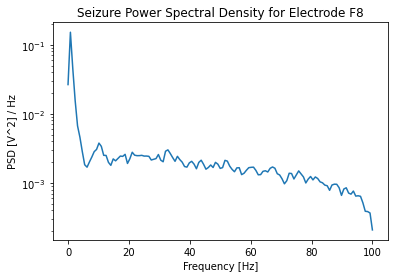

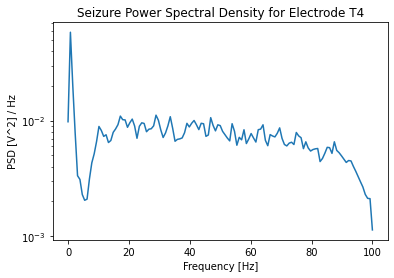

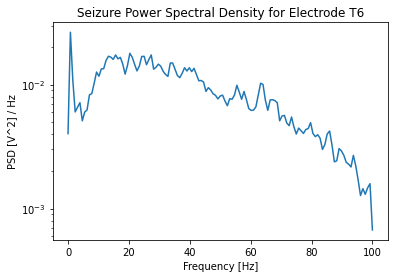

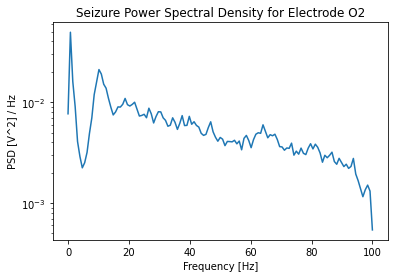

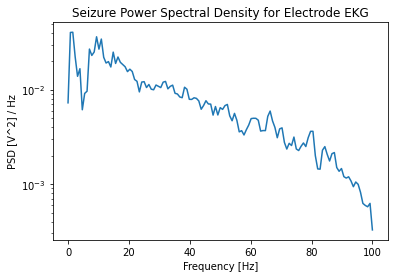

In [151]:
for i in range(len(fpxx_list6)):
    plt.semilogy(fpxx_list6[i][0], fpxx_list6[i][1])
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('PSD [V^2] / Hz')
    plt.title('Seizure Power Spectral Density for Electrode {}'.format(test_eeg.columns[i]))
    plt.show()

The **Seizure** data is by far the most unique. There is a spike immediately after the initial dip all of these plots show. This happens between 5 and 10 Hz. Then it doesn't come back down the way the others do. The decline is much more gradual and consists of many mini spikes along the way. Some electrodes show a curved shape almost like a wide parabola, and others show a more linear shape. 

In [152]:
def preprocess(sub_eeg):
    sub_eeg = replace_nulls(sub_eeg)
    sub_eeg = standardize(sub_eeg)
    return sub_eeg

In [153]:
other_welch2 = get_sub_eeg(other_df, 125)
lpd_welch2 = get_sub_eeg(lpd_df, 125)
gpd_welch2 = get_sub_eeg(gpd_df, 125)
lrda_welch2 = get_sub_eeg(lrda_df, 125)
grda_welch2 = get_sub_eeg(grda_df, 125)
seizure_welch2 = get_sub_eeg(seizure_df, 125)

In [154]:
other_welch2 = preprocess(other_welch2)
lpd_welch2 = preprocess(lpd_welch2)
gpd_welch2 = preprocess(gpd_welch2)
lrda_welch2 = preprocess(lrda_welch2)
grda_welch2 = preprocess(grda_welch2)
seizure_welch2 = preprocess(seizure_welch2)

In [155]:
def welch(data):
    f_list = []
    pxx_list = []
    for col in data.columns:
        f, pxx = signal.welch(data[col], fs = 200)
        f_list.append(f)
        pxx_list.append(pxx)
    return f_list, pxx_list

In [156]:
other_f2, other_pxx2 = welch(other_welch2)
lpd_f2, lpd_pxx2 = welch(lpd_welch2)
gpd_f2, gpd_pxx2 = welch(gpd_welch2)
lrda_f2, lrda_pxx2 = welch(lrda_welch2)
grda_f2, grda_pxx2 = welch(grda_welch2)
seizure_f2, seizure_pxx2 = welch(seizure_welch2)

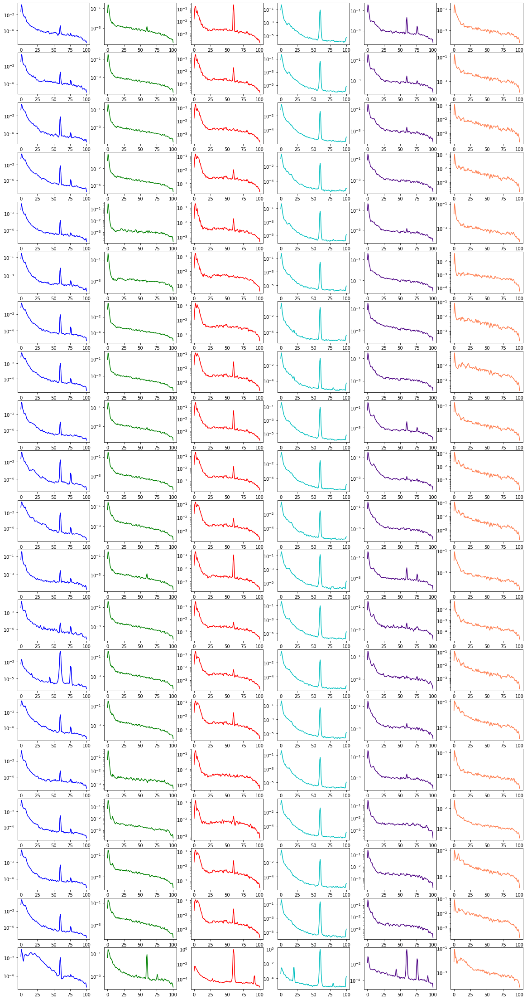

In [157]:
f_type = [other_f2, lpd_f2, gpd_f2, lrda_f2, grda_f2, seizure_f2]
pxx_type = [other_pxx2, lpd_pxx2, gpd_pxx2, lrda_pxx2, grda_pxx2, seizure_pxx2]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(20, 6)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f2)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

In [158]:
other_welch3 = get_sub_eeg(other_df, 200)
lpd_welch3 = get_sub_eeg(lpd_df, 200)
gpd_welch3 = get_sub_eeg(gpd_df, 200)
lrda_welch3 = get_sub_eeg(lrda_df, 200)
grda_welch3 = get_sub_eeg(grda_df, 200)
seizure_welch3 = get_sub_eeg(seizure_df, 200)

In [159]:
other_welch3 = preprocess(other_welch3)
lpd_welch3 = preprocess(lpd_welch3)
gpd_welch3 = preprocess(gpd_welch3)
lrda_welch3 = preprocess(lrda_welch3)
grda_welch3 = preprocess(grda_welch3)
seizure_welch3 = preprocess(seizure_welch3)

In [160]:
other_f3, other_pxx3 = welch(other_welch3)
lpd_f3, lpd_pxx3 = welch(lpd_welch3)
gpd_f3, gpd_pxx3 = welch(gpd_welch3)
lrda_f3, lrda_pxx3 = welch(lrda_welch3)
grda_f3, grda_pxx3 = welch(grda_welch3)
seizure_f3, seizure_pxx3 = welch(seizure_welch3)

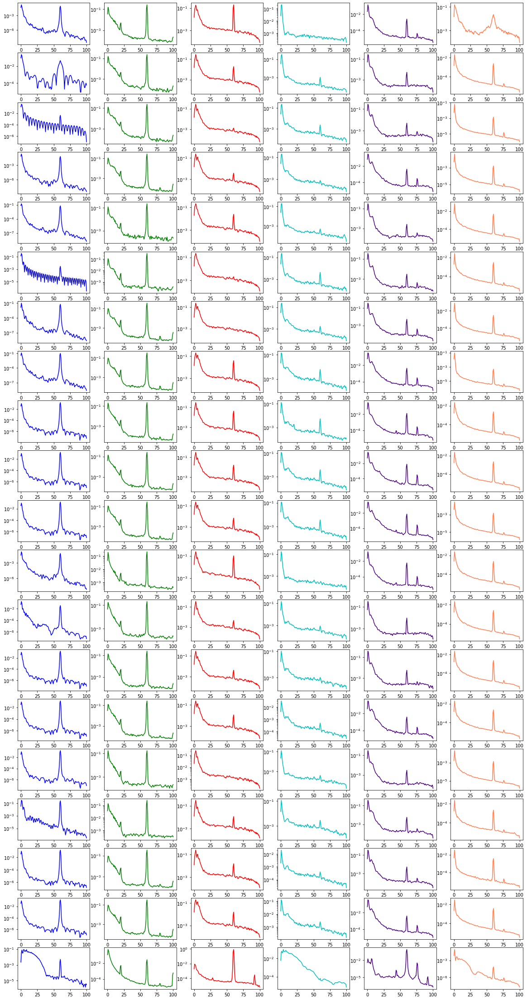

In [161]:
f_type = [other_f3, lpd_f3, gpd_f3, lrda_f3, grda_f3, seizure_f3]
pxx_type = [other_pxx3, lpd_pxx3, gpd_pxx3, lrda_pxx3, grda_pxx3, seizure_pxx3]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(20, 6)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f3)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

#### Notes on PSD Plot Grids  
  
This last set of plots is very different in some places from what was seen before. I'm going to grab two more of each activity type and do plots within activity type like I did above to get a better look at how much variability there is. I still think this data is useful as described above. There should be enough differences in the peak to peak values over specified frequency intervals between activity types that this is useful feature data, but this last set of plots stands out enough that I want to see more.

In [162]:
other_welch = preprocess(get_sub_eeg(other_df, 300))
lpd_welch = preprocess(get_sub_eeg(lpd_df, 300))
gpd_welch = preprocess(get_sub_eeg(gpd_df, 300))
lrda_welch = preprocess(get_sub_eeg(lrda_df, 300))
grda_welch = preprocess(get_sub_eeg(grda_df, 300))
seizure_welch = preprocess(get_sub_eeg(seizure_df, 300))

In [163]:
other_f, other_pxx = welch(other_welch)
lpd_f, lpd_pxx = welch(lpd_welch)
gpd_f, gpd_pxx = welch(gpd_welch)
lrda_f, lrda_pxx = welch(lrda_welch)
grda_f, grda_pxx = welch(grda_welch)
seizure_f, seizure_pxx = welch(seizure_welch)

In [164]:
other_welch4 = preprocess(get_sub_eeg(other_df, 1000))
lpd_welch4 = preprocess(get_sub_eeg(lpd_df, 1000))
gpd_welch4 = preprocess(get_sub_eeg(gpd_df, 1000))
lrda_welch4 = preprocess(get_sub_eeg(lrda_df, 1000))
grda_welch4 = preprocess(get_sub_eeg(grda_df, 1000))
seizure_welch4 = preprocess(get_sub_eeg(seizure_df, 1000))

In [165]:
other_f4, other_pxx4 = welch(other_welch4)
lpd_f4, lpd_pxx4 = welch(lpd_welch4)
gpd_f4, gpd_pxx4 = welch(gpd_welch4)
lrda_f4, lrda_pxx4 = welch(lrda_welch4)
grda_f4, grda_pxx4 = welch(grda_welch4)
seizure_f4, seizure_pxx4 = welch(seizure_welch4)

In [166]:
other_welch5 = preprocess(get_sub_eeg(other_df, 1750))
lpd_welch5 = preprocess(get_sub_eeg(lpd_df, 1750))
gpd_welch5 = preprocess(get_sub_eeg(gpd_df, 1750))
lrda_welch5 = preprocess(get_sub_eeg(lrda_df, 1750))
grda_welch5 = preprocess(get_sub_eeg(grda_df, 1750))
seizure_welch5 = preprocess(get_sub_eeg(seizure_df, 1750))

In [167]:
other_f5, other_pxx5 = welch(other_welch5)
lpd_f5, lpd_pxx5 = welch(lpd_welch5)
gpd_f5, gpd_pxx5 = welch(gpd_welch5)
lrda_f5, lrda_pxx5 = welch(lrda_welch5)
grda_f5, grda_pxx5 = welch(grda_welch5)
seizure_f5, seizure_pxx5 = welch(seizure_welch5)

**Other**

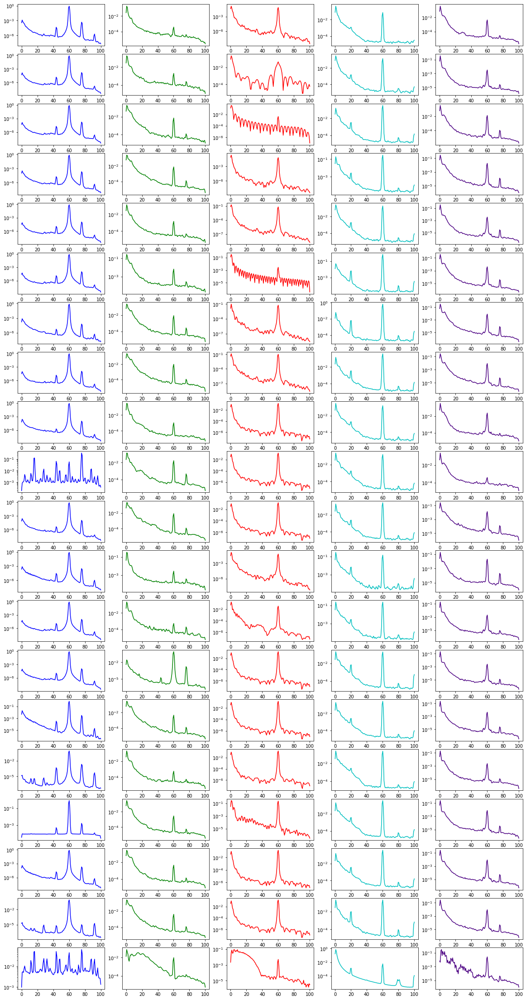

In [168]:
f_type = [other_f, other_f2, other_f3, other_f4, other_f5]
pxx_type = [other_pxx, other_pxx2, other_pxx3, other_pxx4, other_pxx5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

**LPD**

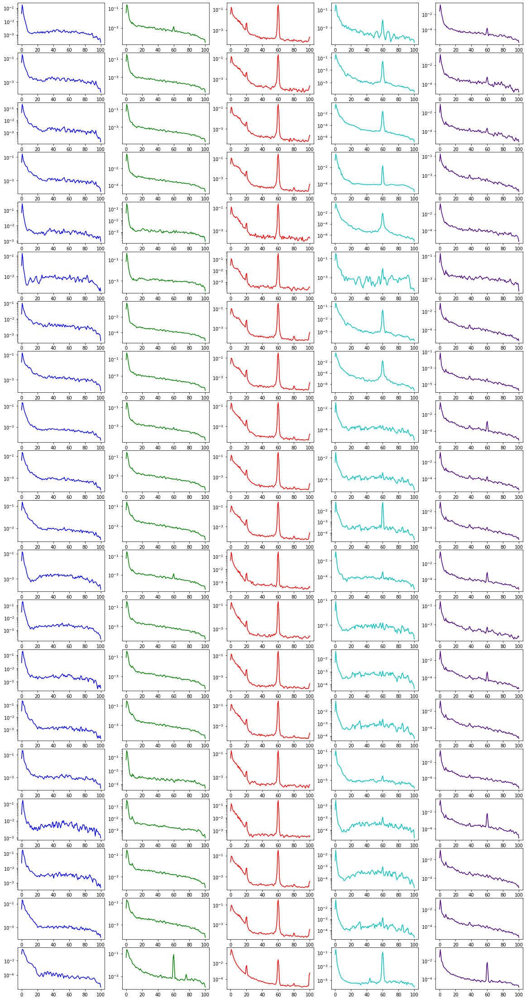

In [169]:
f_type = [lpd_f, lpd_f2, lpd_f3, lpd_f4, lpd_f5]
pxx_type = [lpd_pxx, lpd_pxx2, lpd_pxx3, lpd_pxx4, lpd_pxx5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

**GPD**

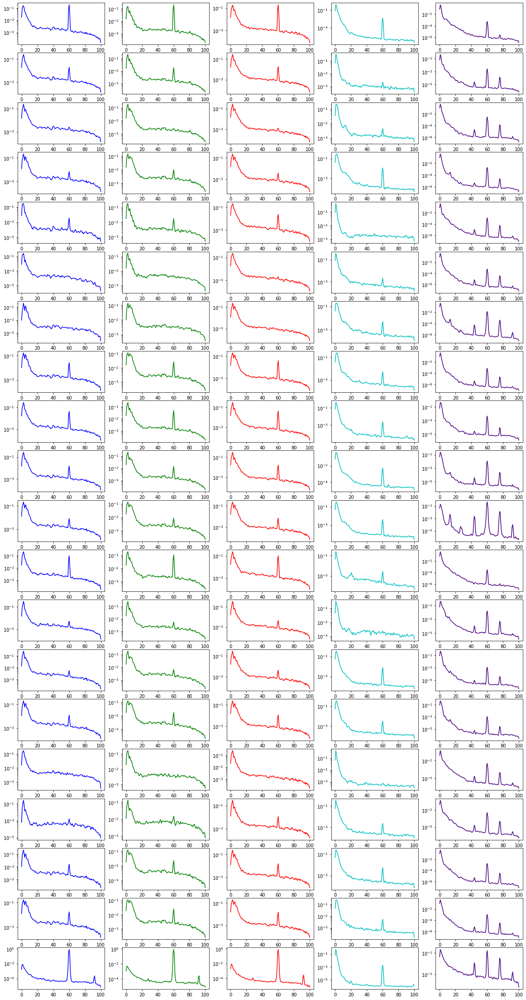

In [170]:
f_type = [gpd_f, gpd_f2, gpd_f3, gpd_f4, gpd_f5]
pxx_type = [gpd_pxx, gpd_pxx2, gpd_pxx3, gpd_pxx4, gpd_pxx5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

**LRDA**

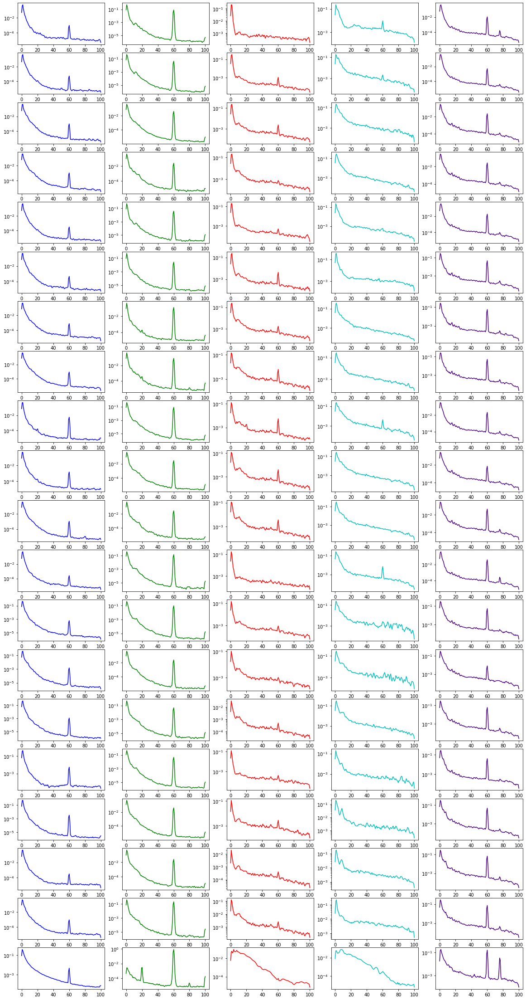

In [171]:
f_type = [lrda_f, lrda_f2, lrda_f3, lrda_f4, lrda_f5]
pxx_type = [lrda_pxx, lrda_pxx2, lrda_pxx3, lrda_pxx4, lrda_pxx5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

**GRDA**

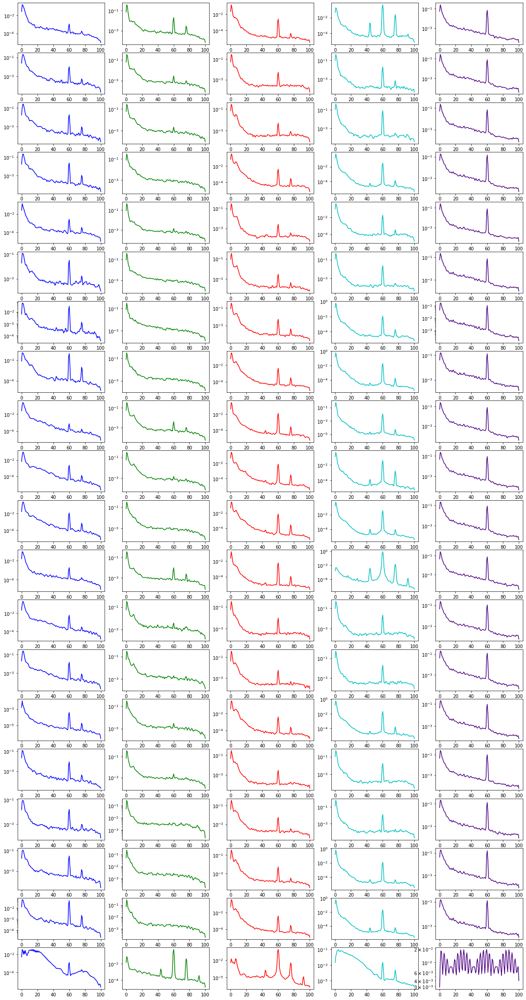

In [172]:
f_type = [grda_f, grda_f2, grda_f3, grda_f4, grda_f5]
pxx_type = [grda_pxx, grda_pxx2, grda_pxx3, grda_pxx4, grda_pxx5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

**Seizure**

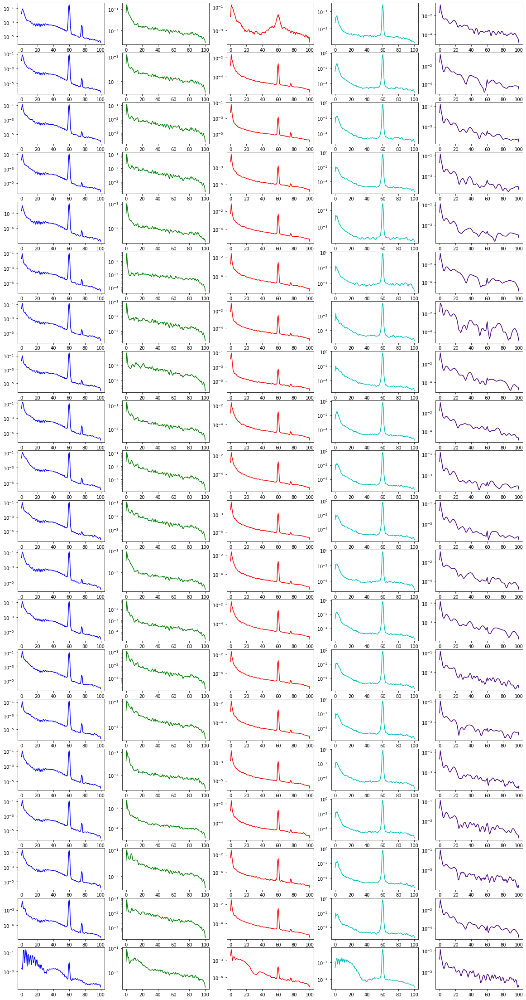

In [173]:
f_type = [seizure_f, seizure_f2, seizure_f3, seizure_f4, seizure_f5]
pxx_type = [seizure_pxx, seizure_pxx2, seizure_pxx3, seizure_pxx4, seizure_pxx5]
colors = ['b', 'g', 'r', 'c', 'indigo']
fig, axs = plt.subplots(20, 5)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(other_f)):
    for j in range(len(f_type)):
        axs[i][j].semilogy(f_type[j][i], pxx_type[j][i], color = colors[j])
        
plt.show()

#### On the Above Grids  
  
There is definitely some variability within activity type. The hope is going to be that over a large enough number of sub EEGs there will be enough difference in the trends between activity type that peak to peak data over different frequency intervals works as a feature. I'd also like to take some simple summary statistic information over specified frequency intervals from this data and see if there's anything there.  
  
The frequency at which spikes occur the most and with the greatest magnitude is 60 Hz by far. This is true for each activity type. There are other frequencies at which spikes tend to occur and there is some difference here between activity type looking at the above grids. For example, 80 Hz and **GRDA**.  
  
For some activity types, some oddities show up. The general flow for most plots is PSD begins high, has a steeper decline which levels out a bit, very few real spikes until about 40 Hz at the earliest where there could be a few spikes in that 40-100 Hz range. **Other** and **Seizure** activity produce some PSD plots which differ quite a bit from this trend. The first column in the grid for **Other** doesn't start as high or drop as much and has more spikes than is typical for the above grids. The last column of the **Seizure** data is more variable throughout the plot than is typical for the above grids.  
  
**A Correction After More Work:**  

The relevant range for band power analysis is 1-30 Hz. Spikes outside of this range isn't relevant to the present analysis and is apparently often the result of errors. The spikes at 60 Hz were said to be errors with the electrodes being used when I looked it up. There are ways to remove these errors, but I couldn't figure out how to properly do that.  
  
The example I saw of this was removing blink artifacts from EEG using PCA and ICA. He reduced his EEG data with PCA from 64 columns to 21 (so, the data was structured a bit differently than the data I have). He then ran ICA on his reduced EEG data and removed the independent components which seemed to correspond with the artifacts he was seeing in the overall data (spikes in the signal at specific points). I don't know how to correctly do this with my data and the errors I have, so I'll be restricting the frequency range of my PSD data to the relevant 1-30 Hz range.

#### FastICA

I ended up not using ICA, and I think that worked out for the best. The peak to peak and variance features I would have pulled from this data performed worse than the rest of the features I gathered.

In [174]:
from sklearn.decomposition import FastICA

In [175]:
other_ica = get_sub_eeg(other_df, 50)
lpd_ica = get_sub_eeg(lpd_df, 50)
gpd_ica = get_sub_eeg(gpd_df, 50)
lrda_ica = get_sub_eeg(lrda_df, 50)
grda_ica = get_sub_eeg(grda_df, 50)
seizure_ica = get_sub_eeg(seizure_df, 50)

In [176]:
other_ica = standardize(other_ica)
lpd_ica = standardize(lpd_ica)
gpd_ica = standardize(gpd_ica)
lrda_ica = standardize(lrda_ica)
grda_ica = standardize(grda_ica)
seizure_ica = standardize(seizure_ica)

In [177]:
def fast_ica(sub_eeg):
    fica = FastICA()
    return fica.fit_transform(sub_eeg)

In [178]:
other_ica = fast_ica(other_ica)
lpd_ica = fast_ica(lpd_ica)
gpd_ica = fast_ica(gpd_ica)
lrda_ica = fast_ica(lrda_ica)
grda_ica = fast_ica(grda_ica)
seizure_ica = fast_ica(seizure_ica)

/home/clay/.local/lib/python3.8/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
/home/clay/.local/lib/python3.8/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
/home/clay/.local/lib/python3.8/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
/home/clay/.local/lib/python3.8/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


In [179]:
ica_cols = ['component{}'.format(i) for i in range(20)]

In [180]:
other_ica = pd.DataFrame(other_ica, columns = ica_cols)
lpd_ica = pd.DataFrame(lpd_ica, columns = ica_cols)
gpd_ica = pd.DataFrame(gpd_ica, columns = ica_cols)
lrda_ica = pd.DataFrame(lrda_ica, columns = ica_cols)
grda_ica = pd.DataFrame(grda_ica, columns = ica_cols)
seizure_ica = pd.DataFrame(seizure_ica, columns = ica_cols)

The grid of plots below shows the results of the ICA transformation on the sub EEGs I passed FastICA. Each column is an activity type and each row is a component from the ICA. I left everything defaulted, so FastICA returned 20 components. One for each column of the sub EEG.

##### Key:  
  
**Blue** - Other  
**Green** - LPD  
**Red** - GPD  
**Cyan** - LRDA  
**Purple** - GRDA  
**Coral** - Seizure

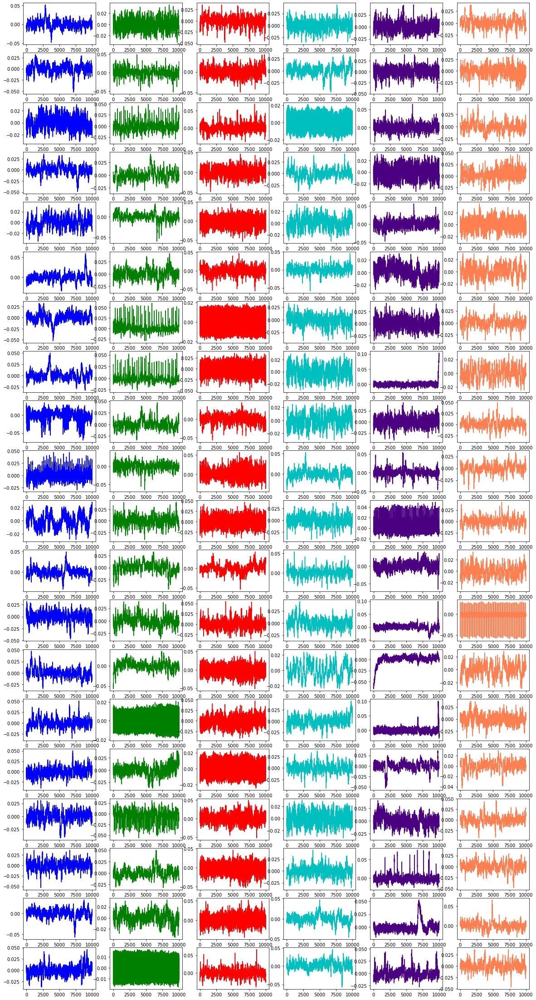

In [181]:
ica_list = [other_ica, lpd_ica, gpd_ica, lrda_ica, grda_ica, seizure_ica]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(20, 6)
fig.set_figheight(40)
fig.set_figwidth(20)
for i in range(len(ica_cols)):
    for j in range(len(ica_list)):
        axs[i][j].plot(ica_list[j][ica_cols[i]], color = colors[j])
        
plt.show()

In the plots above, the component plots don't seem to have similar activity across activity type and this was my hang up with determining how to remove a component to correct an error in the data. I will probably still use ICA and calculate some features from the independent components, but I'm not going to be using ICA to correct errors. Before I use ICA to calculate any feature data, I'll be reducing my EEG dimensions with PCA. You can use ICA to reduce dimensionality, but PCA is easier to evaluate. It returns the total variance explained by your principal components and the variance explained by individual principal components. This can be used to decide on an optimal number of components.

### Dimensionality Reduction with PCA

In [183]:
from sklearn.decomposition import PCA

In [184]:
def principal_components(data, n):
    pca_cols = ['component{}'.format(i + 1) for i in range(n)]
    pca = PCA(n_components = n)
    pca.fit(data)
    pca_eeg = pca.transform(data)
    explained_variance_ratio = pca.explained_variance_ratio_
    return pd.DataFrame(pca_eeg, columns = pca_cols), explained_variance_ratio

Below I am running PCA on 500 sub EEGs. I'll do this with a few different inputs for n_components and determine from the percentage of variance explained on average how many components I want to run PCA with to reduce the dimensionality of my EEG data.

In [185]:
evr_sums = []
evrs = []
for i in range(500):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    pca_eeg, evr = principal_components(sub_eeg, 7)
    evrs.append(evr)
    evr_sums.append(evr.sum())

In [186]:
np.mean(evr_sums)

0.9571415

In [187]:
evr_sums2 = []
evrs2 = []
for i in range(500):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    pca_eeg, evr = principal_components(sub_eeg, 8)
    evrs2.append(evr)
    evr_sums2.append(evr.sum())

In [188]:
np.mean(evr_sums2)

0.9687924

In [189]:
evr_sums3 = []
evrs3 = []
for i in range(500):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    pca_eeg, evr = principal_components(sub_eeg, 9)
    evrs3.append(evr)
    evr_sums3.append(evr.sum())

In [190]:
np.mean(evr_sums3)

0.9773851

In [191]:
evr_sums4 = []
evrs4 = []
for i in range(500):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    pca_eeg, evr = principal_components(sub_eeg, 10)
    evrs4.append(evr)
    evr_sums4.append(evr.sum())

In [192]:
np.mean(evr_sums4)

0.98330027

In [193]:
evr_sums5 = []
evrs5 = []
for i in range(500):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    pca_eeg, evr = principal_components(sub_eeg, 11)
    evrs5.append(evr)
    evr_sums5.append(evr.sum())

In [194]:
np.mean(evr_sums5)

0.98767614

In [195]:
evr_sums6 = []
evrs6 = []
for i in range(500):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    pca_eeg, evr = principal_components(sub_eeg, 12)
    evrs6.append(evr)
    evr_sums6.append(evr.sum())

In [196]:
np.mean(evr_sums6)

0.9909568

Seeing weaker and weaker returns with the difference in explained variance. I'm going to run PCA with 8 components. This cuts more than half of my columns out and explains about 97% of the variance on average. Any additional components explain less than 1% of the variance and ensure that the number of features I'm working with after extracting features from the EEG data will be even larger. PTP data produces 5 datapoints per column, there will be multiple datapoints pulled from each column of the PSD data, and any info gathered from doing independent component analysis will be even more per column.

#### Feature Data and Plots

Now that I've determined I want to use n_components = 8 for my PCA, I'll calculate feature data for the first 500 sub EEGs in order to plot the feature data by target variable class. Plots will be histograms to identify differences in the distributions by class to verify that the chosen features will be useful.  
  
**Preprocessing:**  

Preprocessing of the sub EEG data will be done with the preprocess function above. It takes in a sub EEG, replaces missing values with the column median, and then standardizes the data with sklearn's StandardScaler. Before I had been MinMaxScaling data, but standardization is necessary for principal component analysis and PCA is a common method of dimensionality reduction for EEG data and analysis.  
  
**Statistical Time Domain Features After PCA:**  
  
For features, I'm going to calculate some statistical time domain features by taking the mean, variance, peak to peak of the EEG signal data over specified intervals. Each sub EEG is a 50 second recording. 200 rows of data per second. I'll gather statistical time domain features from every 10 second interval of my sub EEG data. I plotted some peak to peak data from these intervals above and compared target variable class. That was before PCA, however. This will be done after dimensionality reduction with PCA.  
    
**Hjorth Parameters:**  
  
These are features that give information about the frequency domain from the time domain. In other words, they tell you something about the signal data without having to transform time series data into frequency data. There will be a fuller explanation below.  
  
**Frequency Domain Features from Power Spectral Density:**  
  
The last set of data will be gathered from the power spectral density which is calculated with scipy's welch function. The most relevant bands for this EEG analysis are alpha (8-12 Hz) and Beta (12-30 Hz). The other relevant bands are Delta (1-4 Hz) and Theta (4-8 Hz). In the plots done for the PSD data above, I was seeing spikes at frequencies well outside of this range, but the bulk of the area under the curve did seem to fall in this 1-30 Hz range typically.  
  
From the bit of searching I did on why there were spikes at such high frequencies, I found that this is often due to some set of errors. At 60 Hz, it's apparently common for there to have been an error with the electrode being used. I don't know how likely this is given these spikes happened at nearly every electrode for every sub EEG and every category of brain activity, but that does suggest to me they're likely due to error. There are ways to address these errors. I saw one example using ICA to identify blink artifacts in the EEG signal data and then removing the corresponding components, but I don't understand how to implement that for that purpose, so I'll restrict the frequency range I'm looking at to the relevant frequency range and get data for the alpha and beta bands.  
  
**Fractal Dimension Features:**  
  
There are a few fractal dimension algorithms that are commonly used for EEG analysis. I ended up trying Higuchi and Katz algorithms which I saw paper showed effectiveness for with respect to identifying epilepsies in EEG signals. They ended up being useful, but the Hjorth Parameters and Band Power Features were the most useful.

In [197]:
def interval_ptp(data, first_row):
    ptps = []
    segment = data.iloc[first_row: (first_row + 2000)]
    for col in segment.columns:
        ptps.append(np.ptp(segment[col]))
    return np.asarray(ptps)

In [198]:
i10_ptps = []
for i in range(50):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    i10_ptps.append(interval_ptp(reduced_eeg, 0))

In [199]:
i10_cols = ['Component{}_10s_ptp'.format(i + 1) for i in range(reduced_eeg.shape[1])]
i10_df = pd.DataFrame(i10_ptps, columns = i10_cols)

In [200]:
ptps_10s = []
ptps_20s = []
ptps_30s = []
ptps_40s = []
ptps_50s = []    

In [201]:
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    ptps_10s.append(interval_ptp(reduced_eeg, 0))

In [202]:
cols_10s = ['{}_10s_ptp'.format(col) for col in reduced_eeg.columns]

In [203]:
df_ptp_10s = pd.DataFrame(ptps_10s, columns = cols_10s)

In [204]:
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    ptps_20s.append(interval_ptp(reduced_eeg, 2000))

In [205]:
cols_20s = ['{}_20s_ptp'.format(col) for col in reduced_eeg.columns]

In [206]:
df_ptp_20s = pd.DataFrame(ptps_20s, columns = cols_20s)

In [207]:
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    ptps_30s.append(interval_ptp(reduced_eeg, 4000))

In [208]:
cols_30s = ['{}_30s_ptp'.format(col) for col in reduced_eeg.columns]

In [209]:
df_ptp_30s = pd.DataFrame(ptps_30s, columns = cols_30s)

In [210]:
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    ptps_40s.append(interval_ptp(reduced_eeg, 6000))

In [211]:
cols_40s = ['{}_40s_ptp'.format(col) for col in reduced_eeg.columns]

In [212]:
df_ptp_40s = pd.DataFrame(ptps_40s, columns = cols_40s)

In [213]:
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    ptps_50s.append(interval_ptp(reduced_eeg, 8000))

In [214]:
cols_50s = ['{}_50s_ptp'.format(col) for col in reduced_eeg.columns]

In [215]:
df_ptp_50s = pd.DataFrame(ptps_50s, columns = cols_50s)

In [216]:
t = training.iloc[0:2000]

In [217]:
activity = t['expert_consensus']

In [218]:
df_ptp_10s['activity'] = activity
df_ptp_20s['activity'] = activity
df_ptp_30s['activity'] = activity
df_ptp_40s['activity'] = activity
df_ptp_50s['activity'] = activity

In [219]:
df_10s_cols = df_ptp_10s.drop(columns = 'activity').columns
df_20s_cols = df_ptp_20s.drop(columns = 'activity').columns
df_30s_cols = df_ptp_30s.drop(columns = 'activity').columns
df_40s_cols = df_ptp_40s.drop(columns = 'activity').columns
df_50s_cols = df_ptp_50s.drop(columns = 'activity').columns

### PTP Interval Histograms

##### Key for Below Histograms  
  
**Other** - Blue  
**LPD** - Green  
**GPD** - Red  
**LRDA** - Cyan  
**GRDA** - Purple  
**Seizure** - Coral  
  
Every row of plots represents a principal component. There are 8. Every column represents a type of brain activity. There are 6. They are represented by the colors listed above.

#### 0-10s PTP Histograms

In [220]:
other_10s = df_ptp_10s[df_ptp_10s['activity'] == 'Other']
lpd_10s = df_ptp_10s[df_ptp_10s['activity'] == 'LPD']
gpd_10s = df_ptp_10s[df_ptp_10s['activity'] == 'GPD']
lrda_10s = df_ptp_10s[df_ptp_10s['activity'] == 'LRDA']
grda_10s = df_ptp_10s[df_ptp_10s['activity'] == 'GRDA']
seizure_10s = df_ptp_10s[df_ptp_10s['activity'] == 'Seizure']

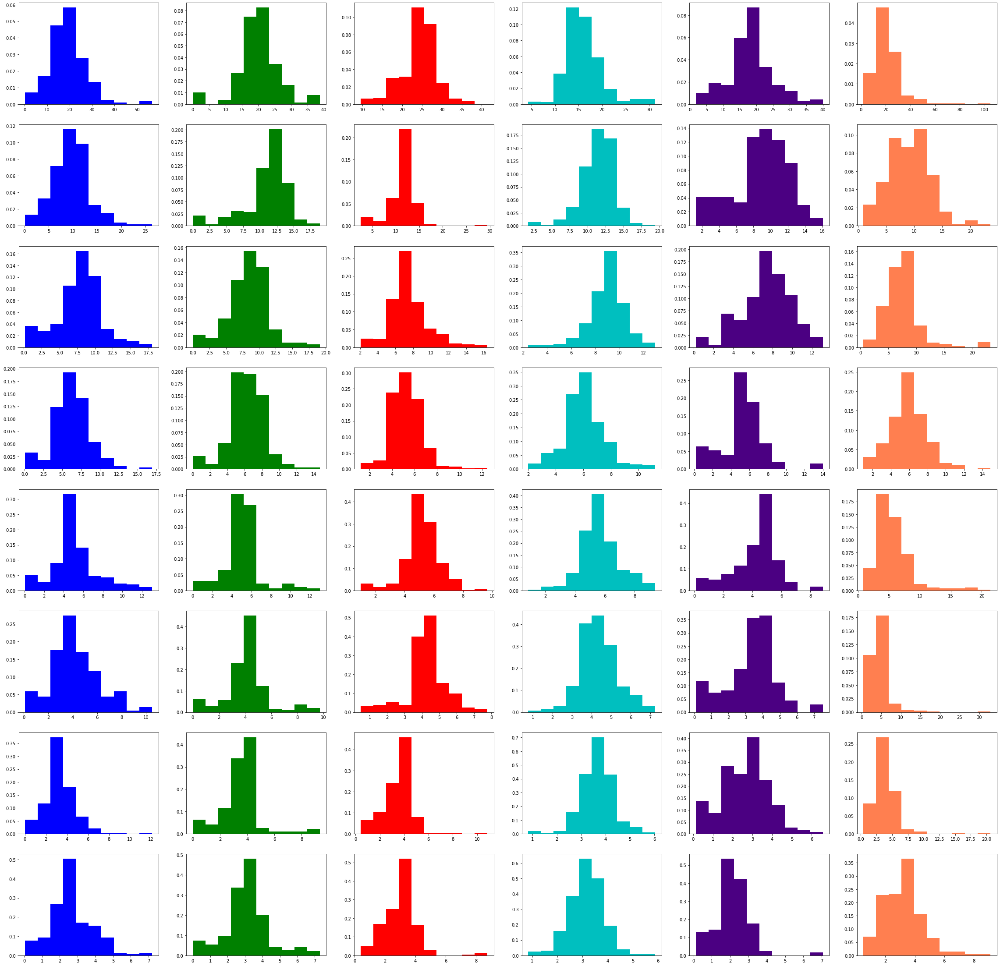

In [221]:
activity_10s = [other_10s, lpd_10s, gpd_10s, lrda_10s, grda_10s, seizure_10s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(df_10s_cols)):
    for j in range(len(activity_10s)):
        axs[i][j].hist(activity_10s[j][df_10s_cols[i]], density = True, color = colors[j])
        
plt.show()

#### 10-20s PTP Histograms

In [222]:
other_20s = df_ptp_20s[df_ptp_20s['activity'] == 'Other']
lpd_20s = df_ptp_20s[df_ptp_20s['activity'] == 'LPD']
gpd_20s = df_ptp_20s[df_ptp_20s['activity'] == 'GPD']
lrda_20s = df_ptp_20s[df_ptp_20s['activity'] == 'LRDA']
grda_20s = df_ptp_20s[df_ptp_20s['activity'] == 'GRDA']
seizure_20s = df_ptp_20s[df_ptp_20s['activity'] == 'Seizure']

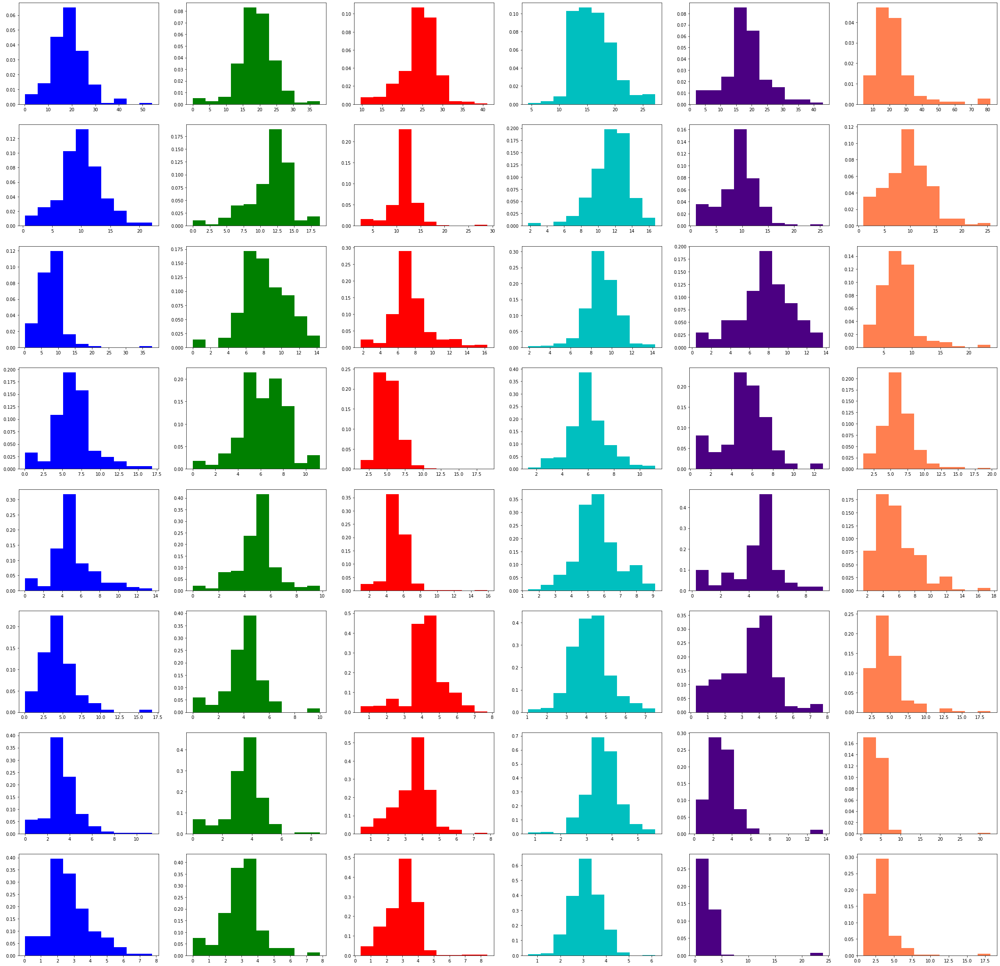

In [223]:
activity_20s = [other_20s, lpd_20s, gpd_20s, lrda_20s, grda_20s, seizure_20s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(df_20s_cols)):
    for j in range(len(activity_20s)):
        axs[i][j].hist(activity_20s[j][df_20s_cols[i]], density = True, color = colors[j])
        
plt.show()

#### 20-30s PTP Histograms

In [224]:
other_30s = df_ptp_30s[df_ptp_30s['activity'] == 'Other']
lpd_30s = df_ptp_30s[df_ptp_30s['activity'] == 'LPD']
gpd_30s = df_ptp_30s[df_ptp_30s['activity'] == 'GPD']
lrda_30s = df_ptp_30s[df_ptp_30s['activity'] == 'LRDA']
grda_30s = df_ptp_30s[df_ptp_30s['activity'] == 'GRDA']
seizure_30s = df_ptp_30s[df_ptp_30s['activity'] == 'Seizure']

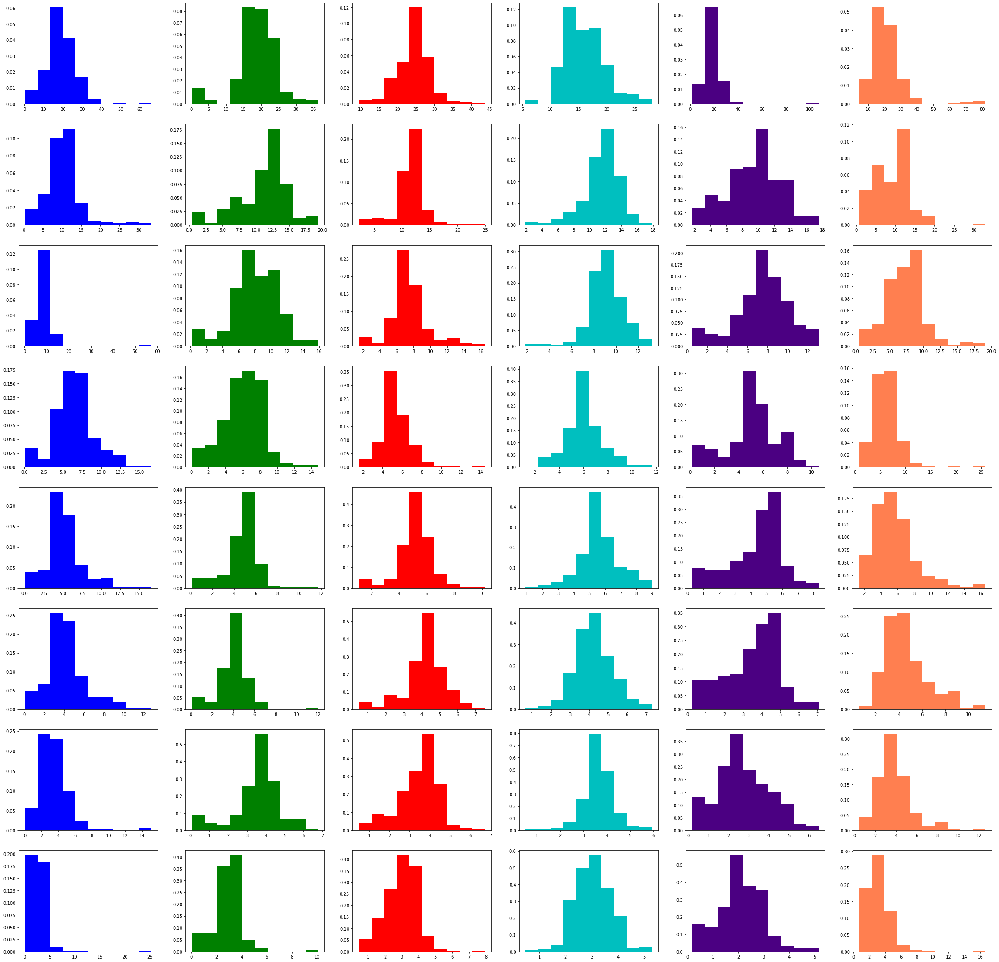

In [225]:
activity_30s = [other_30s, lpd_30s, gpd_30s, lrda_30s, grda_30s, seizure_30s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(df_30s_cols)):
    for j in range(len(activity_30s)):
        axs[i][j].hist(activity_30s[j][df_30s_cols[i]], density = True, color = colors[j])
        
plt.show()

#### 30-40s PTP Histograms

In [226]:
other_40s = df_ptp_40s[df_ptp_40s['activity'] == 'Other']
lpd_40s = df_ptp_40s[df_ptp_40s['activity'] == 'LPD']
gpd_40s = df_ptp_40s[df_ptp_40s['activity'] == 'GPD']
lrda_40s = df_ptp_40s[df_ptp_40s['activity'] == 'LRDA']
grda_40s = df_ptp_40s[df_ptp_40s['activity'] == 'GRDA']
seizure_40s = df_ptp_40s[df_ptp_40s['activity'] == 'Seizure']

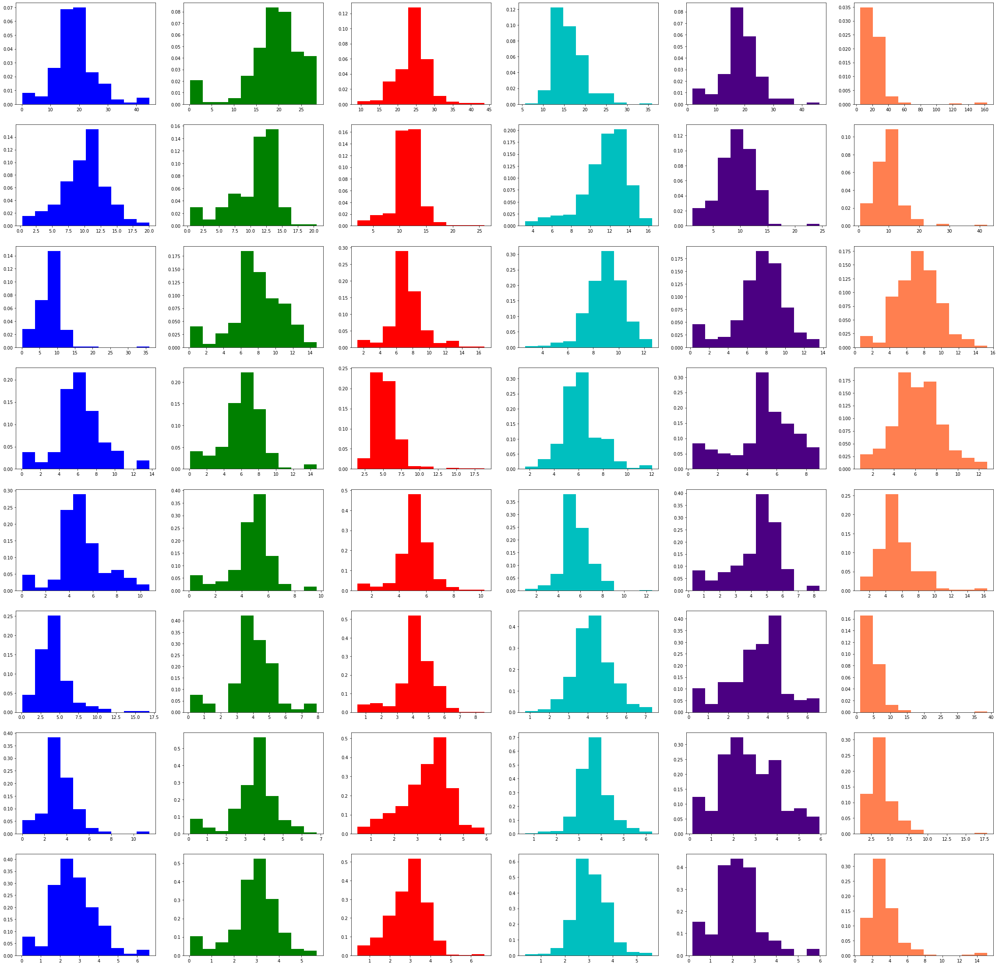

In [227]:
activity_40s = [other_40s, lpd_40s, gpd_40s, lrda_40s, grda_40s, seizure_40s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(df_40s_cols)):
    for j in range(len(activity_40s)):
        axs[i][j].hist(activity_40s[j][df_40s_cols[i]], density = True, color = colors[j])
        
plt.show()

#### 40-50s PTP Histograms

In [228]:
other_50s = df_ptp_50s[df_ptp_50s['activity'] == 'Other']
lpd_50s = df_ptp_50s[df_ptp_50s['activity'] == 'LPD']
gpd_50s = df_ptp_50s[df_ptp_50s['activity'] == 'GPD']
lrda_50s = df_ptp_50s[df_ptp_50s['activity'] == 'LRDA']
grda_50s = df_ptp_50s[df_ptp_50s['activity'] == 'GRDA']
seizure_50s = df_ptp_50s[df_ptp_50s['activity'] == 'Seizure']

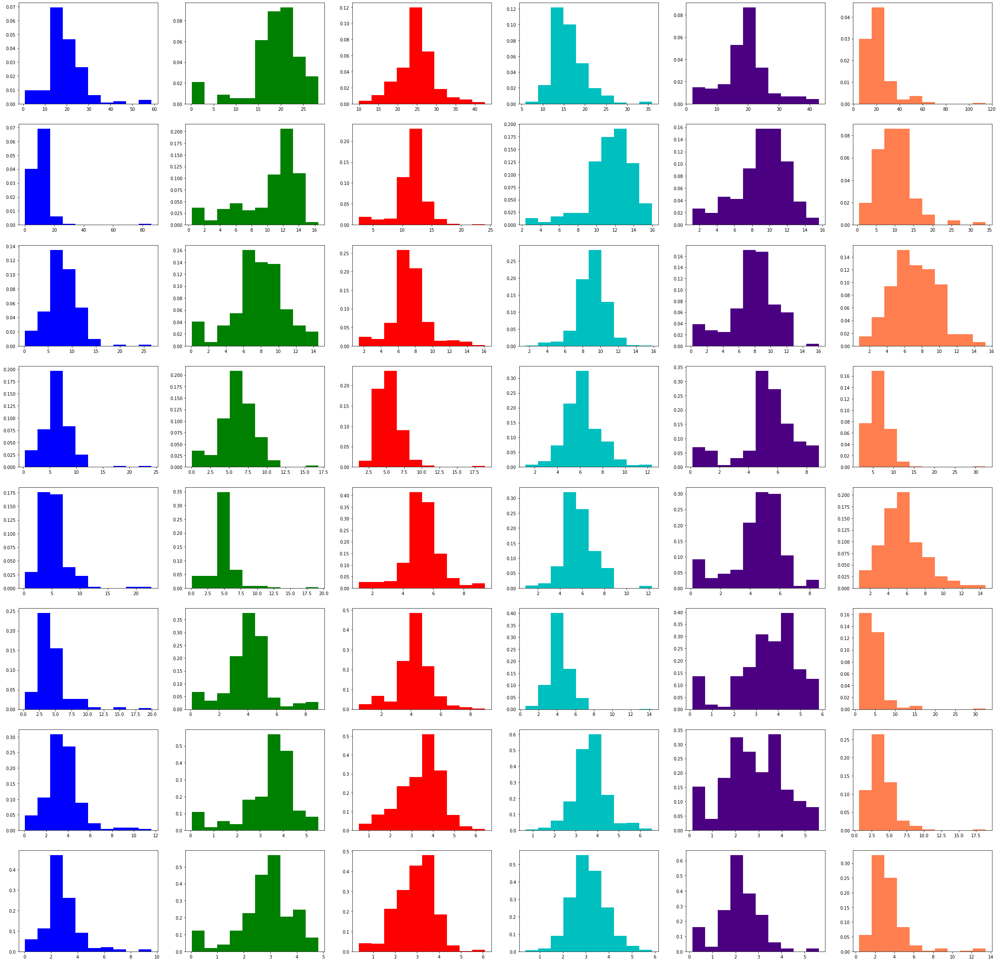

In [229]:
activity_50s = [other_50s, lpd_50s, gpd_50s, lrda_50s, grda_50s, seizure_50s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(df_50s_cols)):
    for j in range(len(activity_50s)):
        axs[i][j].hist(activity_50s[j][df_50s_cols[i]], density = True, color = colors[j])
        
plt.show()

#### Notes on the Above Histograms  
  
**0-10s**  
  
**GRDA** differentiates itself with components 2 and 3. Large chunk of its data in the right half of the histograms. The seizure data falls mostly on the low end across each component. The **LPD** and **LRDA** data are both more centered.  
  
**10-20s**  
  
The most interesting things that stand out to me are that you start seeing an increase in ptp values for **LPD** and **LRDA**. You also have an increase in the ptp values for the seizure data, but more in the first 5 components than in the last 3.  
  
**20-30s**  
  
**LRDA** and **GRDA** distributions more even whereas **Other** and **GPD** show a very high bin and much smaller bins around it. Seizure data continues the trend of increasing ptp values.  
  
**30-40s**  
  
Components 3 and 4 of the **Seizure** data stand out. Higher ptp values and distribution more evenly spread. Looks like an increase in **LPD** and **LRDA** ptp values and an increase in ptp values for the **Other** category, as well. In the last interval, the **Other** data was mostly on the far left of the histogram. For a few components the distribution has spread out more and shown an increase in ptp values.  
  
**40-50s**  
  
Components 3 and 5 stand out the most for the **Seizure** data this time. The **Other** data is back to being confined to the far left of the histogram. For each interval the **GRDA** data had multiple columns with data more spread out. That can be seen in components 6 and 7 of the **GRDA** data.  
  
**Overall Thoughts**  
  
I'm not sure how useful this data is going to be. There aren't a lot of major patterns that stand out clearly. There are a few, and there are certainly differences between activity types within each interval, but it isn't the case that each components has ptp values trending up or down over the course of the 5 intervals, for example.

In [230]:
def interval_var(data, first_row):
    variances = []
    segment = data.iloc[first_row: (first_row + 2000)]
    for col in segment.columns:
        variances.append(np.var(segment[col]))
    return np.asarray(variances)

In [231]:
var_10s = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    var_10s.append(interval_var(reduced_eeg, 0))

In [232]:
cv_10s = ['{}_10s_var'.format(col) for col in reduced_eeg.columns]

In [233]:
df_var_10s = pd.DataFrame(var_10s, columns = cv_10s)

In [234]:
var_20s = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    var_20s.append(interval_var(reduced_eeg, 2000))

In [235]:
cv_20s = ['{}_20s_var'.format(col) for col in reduced_eeg.columns]

In [236]:
df_var_20s = pd.DataFrame(var_20s, columns = cv_20s)

In [237]:
var_30s = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    var_30s.append(interval_var(reduced_eeg, 4000))

In [238]:
cv_30s = ['{}_30s_var'.format(col) for col in reduced_eeg.columns]

In [239]:
df_var_30s = pd.DataFrame(var_30s, columns = cv_30s)

In [240]:
var_40s = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    var_40s.append(interval_var(reduced_eeg, 6000))

In [241]:
cv_40s = ['{}_40s_var'.format(col) for col in reduced_eeg.columns]

In [242]:
df_var_40s = pd.DataFrame(var_40s, columns = cv_40s)

In [243]:
var_50s = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    var_50s.append(interval_var(reduced_eeg, 8000))

In [244]:
cv_50s = ['{}_50s_var'.format(col) for col in reduced_eeg.columns]

In [245]:
df_var_50s = pd.DataFrame(var_50s, columns = cv_50s)

### Variance Histograms Across Activity Type

In [246]:
df_var_10s['activity'] = activity
df_var_20s['activity'] = activity
df_var_30s['activity'] = activity
df_var_40s['activity'] = activity
df_var_50s['activity'] = activity

#### 0-10s Variance

In [247]:
other_var_10s = df_var_10s[df_var_10s['activity'] == 'Other']
lpd_var_10s = df_var_10s[df_var_10s['activity'] == 'LPD']
gpd_var_10s = df_var_10s[df_var_10s['activity'] == 'GPD']
lrda_var_10s = df_var_10s[df_var_10s['activity'] == 'LRDA']
grda_var_10s = df_var_10s[df_var_10s['activity'] == 'GRDA']
seizure_var_10s = df_var_10s[df_var_10s['activity'] == 'Seizure']

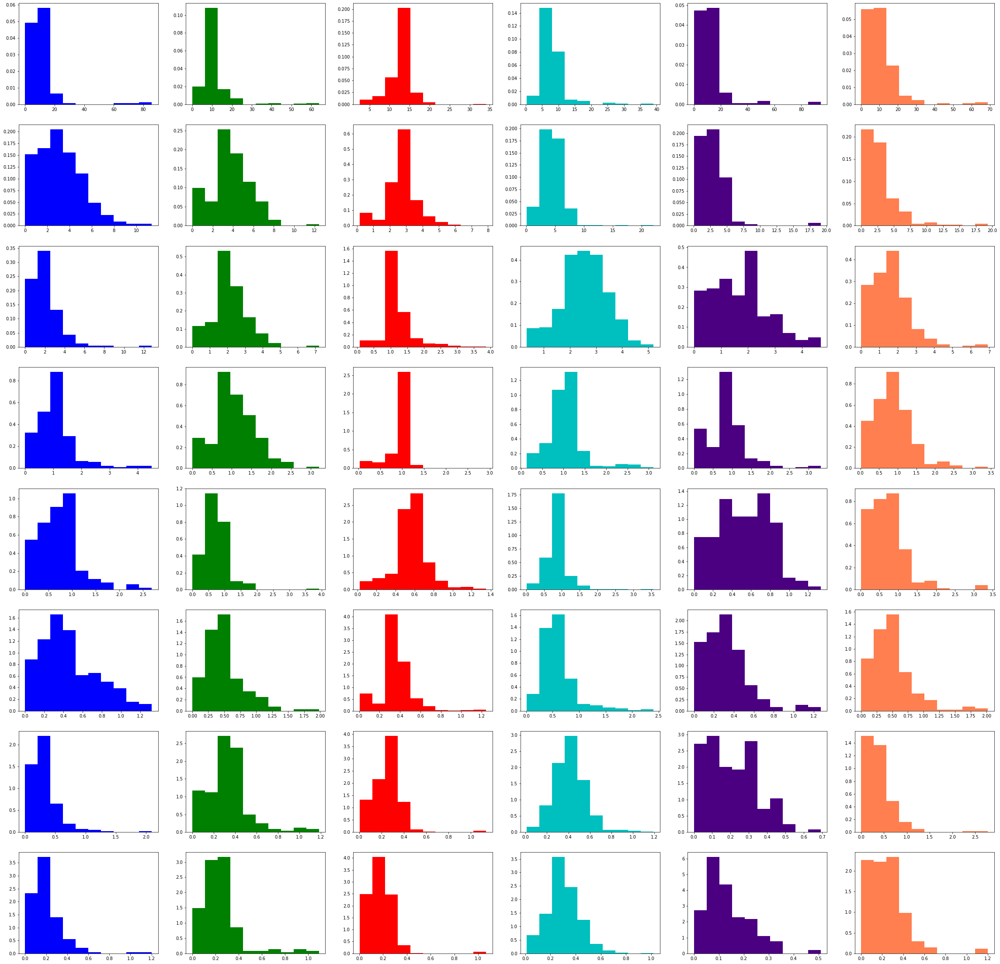

In [248]:
act_var_10s = [other_var_10s, lpd_var_10s, gpd_var_10s, lrda_var_10s, grda_var_10s, seizure_var_10s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(cv_10s)):
    for j in range(len(act_var_10s)):
        axs[i][j].hist(act_var_10s[j][cv_10s[i]], density = True, color = colors[j])

plt.show()

#### 10-20s Variance

In [249]:
other_var_20s = df_var_20s[df_var_20s['activity'] == 'Other']
lpd_var_20s = df_var_20s[df_var_20s['activity'] == 'LPD']
gpd_var_20s = df_var_20s[df_var_20s['activity'] == 'GPD']
lrda_var_20s = df_var_20s[df_var_20s['activity'] == 'LRDA']
grda_var_20s = df_var_20s[df_var_20s['activity'] == 'GRDA']
seizure_var_20s = df_var_20s[df_var_20s['activity'] == 'Seizure']

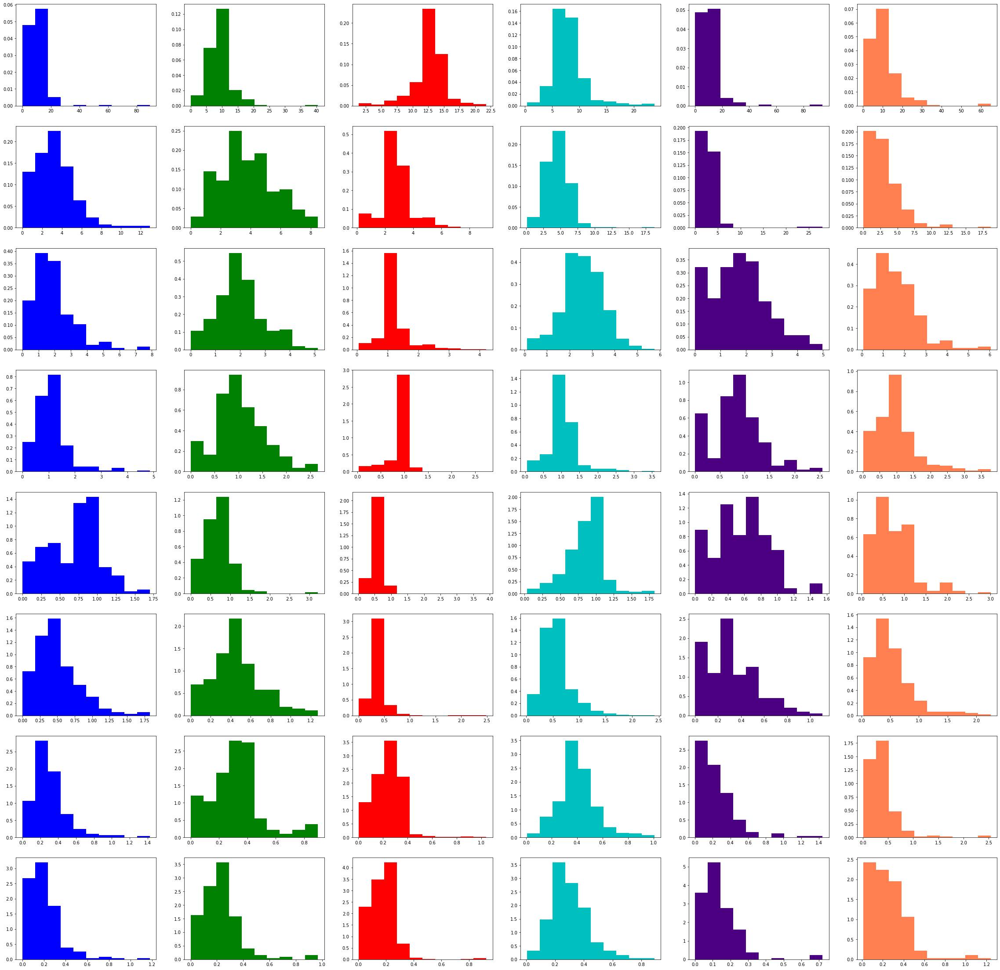

In [250]:
act_var_20s = [other_var_20s, lpd_var_20s, gpd_var_20s, lrda_var_20s, grda_var_20s, seizure_var_20s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(cv_20s)):
    for j in range(len(act_var_20s)):
        axs[i][j].hist(act_var_20s[j][cv_20s[i]], density = True, color = colors[j])

plt.show()

#### 20-30s Variance

In [251]:
other_var_30s = df_var_30s[df_var_30s['activity'] == 'Other']
lpd_var_30s = df_var_30s[df_var_30s['activity'] == 'LPD']
gpd_var_30s = df_var_30s[df_var_30s['activity'] == 'GPD']
lrda_var_30s = df_var_30s[df_var_30s['activity'] == 'LRDA']
grda_var_30s = df_var_30s[df_var_30s['activity'] == 'GRDA']
seizure_var_30s = df_var_30s[df_var_30s['activity'] == 'Seizure']

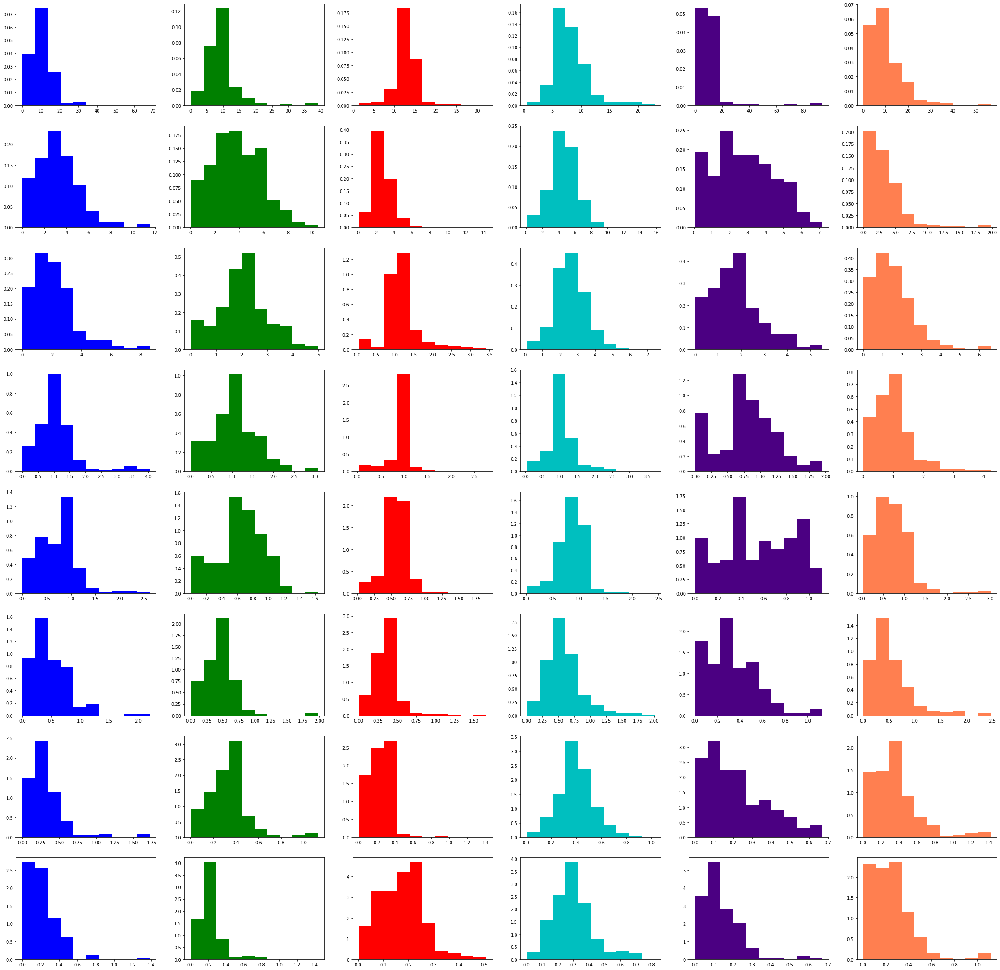

In [252]:
act_var_30s = [other_var_30s, lpd_var_30s, gpd_var_30s, lrda_var_30s, grda_var_30s, seizure_var_30s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(cv_30s)):
    for j in range(len(act_var_30s)):
        axs[i][j].hist(act_var_30s[j][cv_30s[i]], density = True, color = colors[j])

plt.show()

#### 30-40s Variance

In [253]:
other_var_40s = df_var_40s[df_var_40s['activity'] == 'Other']
lpd_var_40s = df_var_40s[df_var_40s['activity'] == 'LPD']
gpd_var_40s = df_var_40s[df_var_40s['activity'] == 'GPD']
lrda_var_40s = df_var_40s[df_var_40s['activity'] == 'LRDA']
grda_var_40s = df_var_40s[df_var_40s['activity'] == 'GRDA']
seizure_var_40s = df_var_40s[df_var_40s['activity'] == 'Seizure']

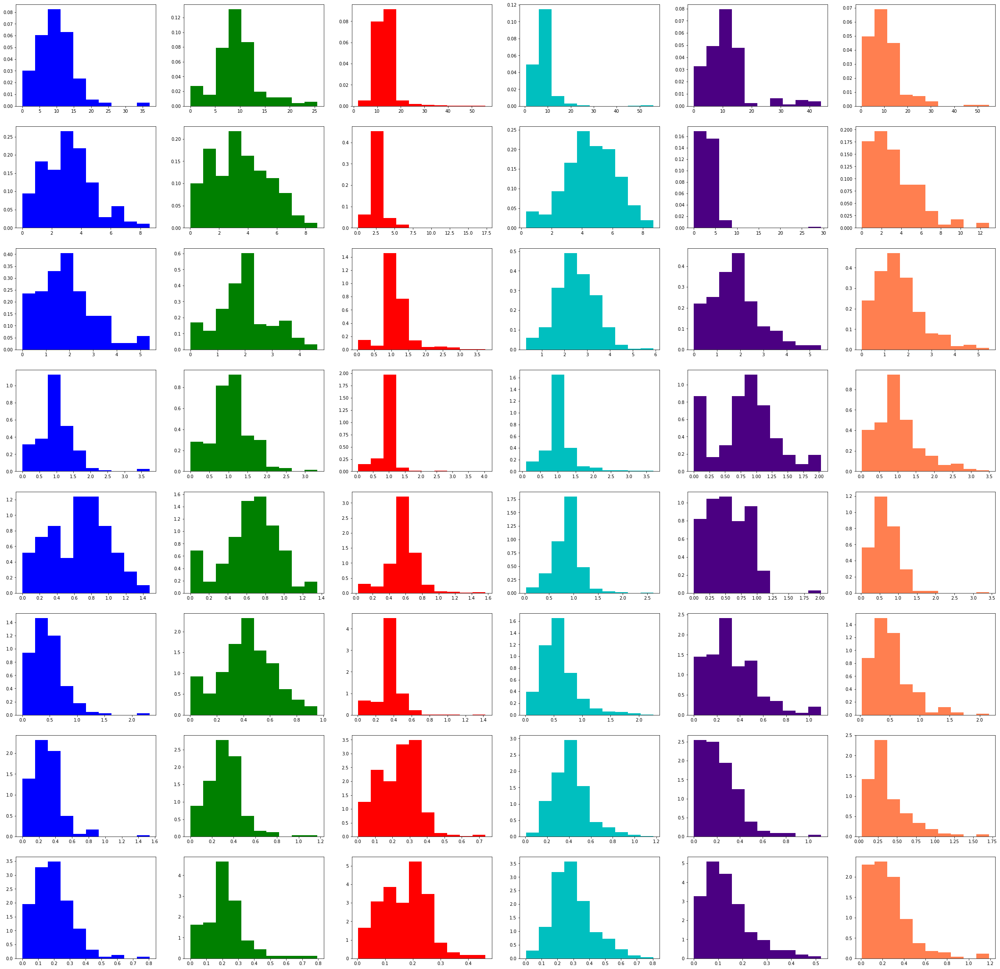

In [254]:
act_var_40s = [other_var_40s, lpd_var_40s, gpd_var_40s, lrda_var_40s, grda_var_40s, seizure_var_40s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(cv_40s)):
    for j in range(len(act_var_40s)):
        axs[i][j].hist(act_var_40s[j][cv_40s[i]], density = True, color = colors[j])

plt.show()

#### 40-50s Variance

In [255]:
other_var_50s = df_var_50s[df_var_50s['activity'] == 'Other']
lpd_var_50s = df_var_50s[df_var_50s['activity'] == 'LPD']
gpd_var_50s = df_var_50s[df_var_50s['activity'] == 'GPD']
lrda_var_50s = df_var_50s[df_var_50s['activity'] == 'LRDA']
grda_var_50s = df_var_50s[df_var_50s['activity'] == 'GRDA']
seizure_var_50s = df_var_50s[df_var_50s['activity'] == 'Seizure']

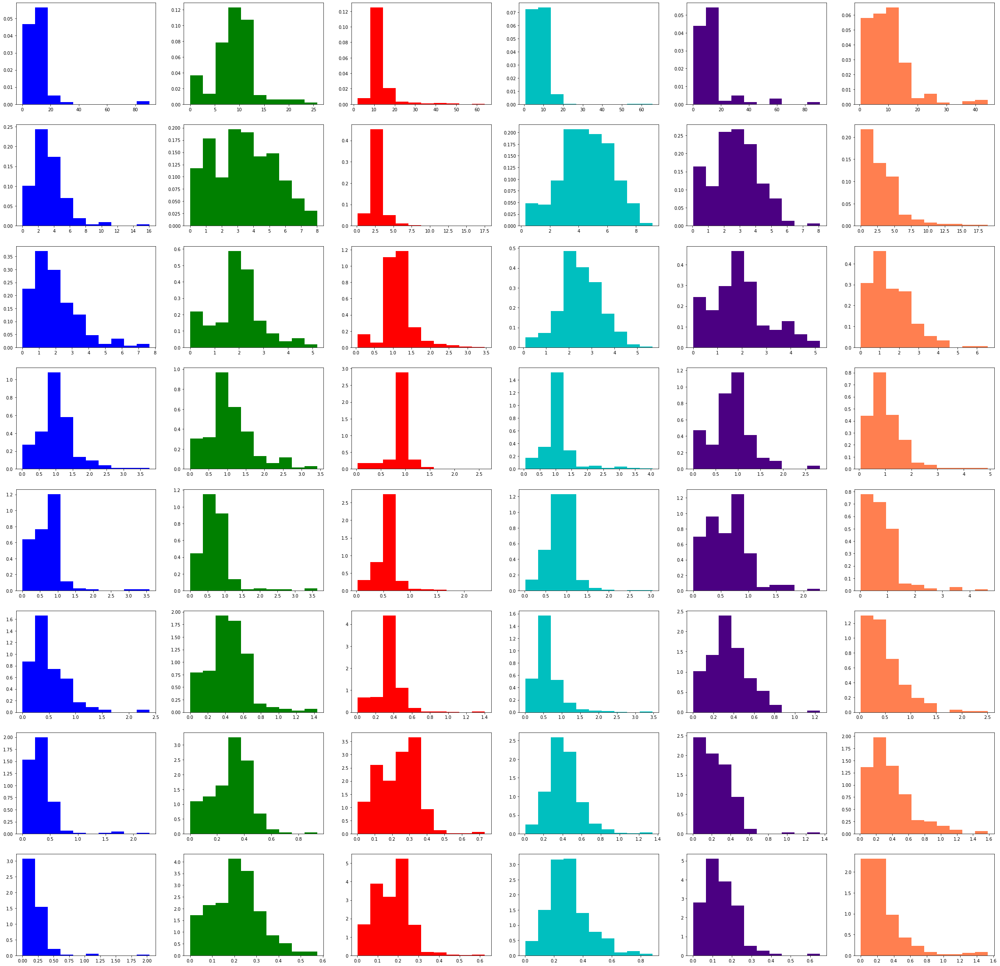

In [256]:
act_var_50s = [other_var_50s, lpd_var_50s, gpd_var_50s, lrda_var_50s, grda_var_50s, seizure_var_50s]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(cv_50s)):
    for j in range(len(act_var_50s)):
        axs[i][j].hist(act_var_50s[j][cv_50s[i]], density = True, color = colors[j])

plt.show()

#### Notes on the Above Histograms

**General Thoughts:**  
  
To make note of some interesting results above, the **Seizure** (coral) data tends to have variances distributed in the left half of the histograms at each interval for each component. The **GPD** data (red) has most of its variances confined to a small number of bins in the center left of the histogram. This holds for the first 5 or 6 components across each time interval. The **Other** data (blue) tends to fall further left on the histogram. The **GRDA** data (purple) has variances with larger distributions. The values are more spread out across the histogram for many of its components.  
  
The data tends to be fairly similar at each time interval within activity types. Occasionally there's a sharp change in the data for a particular component. This data may be useful given there are differences between activity type across time intervals.  
  
Because the distributions tend to be so similar across time intervals, it may be worth just looking at the variance of the overall sub EEG rather than splitting into time intervals for this data.

### Means of Principal Components by Activity Type

In [257]:
def mean(data):
    means = []
    for col in data.columns:
        means.append(np.mean(data[col]))
    return np.asarray(means)

In [258]:
means = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    means.append(mean(reduced_eeg))

In [259]:
mean_cols = ['{}_mean'.format(col) for col in reduced_eeg.columns]
df_means = pd.DataFrame(means, columns = mean_cols)

In [260]:
df_means['activity'] = activity

In [261]:
other_means = df_means[df_means['activity'] == 'Other']
lpd_means = df_means[df_means['activity'] == 'LPD']
gpd_means = df_means[df_means['activity'] == 'GPD']
lrda_means = df_means[df_means['activity'] == 'LRDA']
grda_means = df_means[df_means['activity'] == 'GRDA']
seizure_means = df_means[df_means['activity'] == 'Seizure']

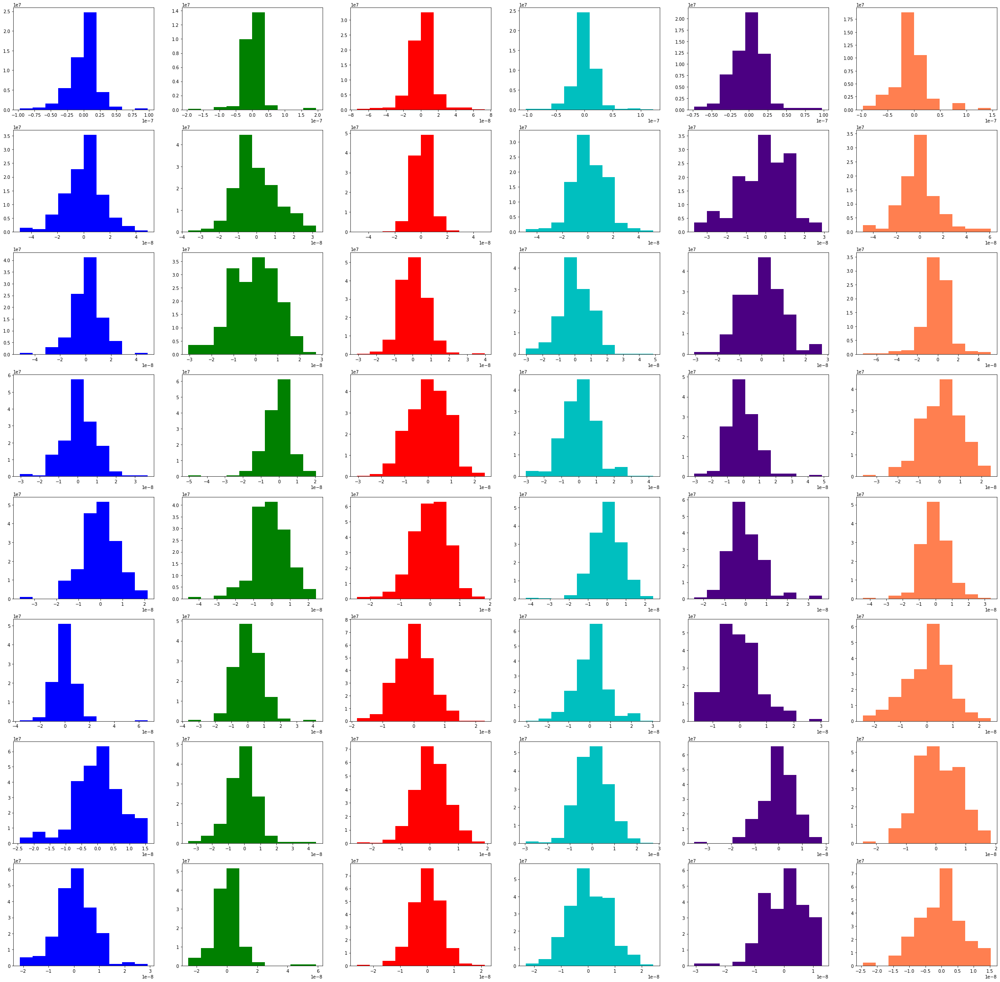

In [262]:
act_means = [other_means, lpd_means, gpd_means, lrda_means, grda_means, seizure_means]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(mean_cols)):
    for j in range(len(act_means)):
        axs[i][j].hist(act_means[j][mean_cols[i]], density = True, color = colors[j])

plt.show()

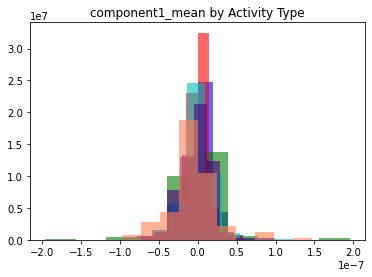

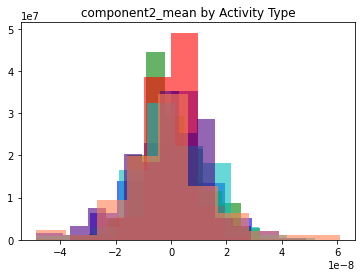

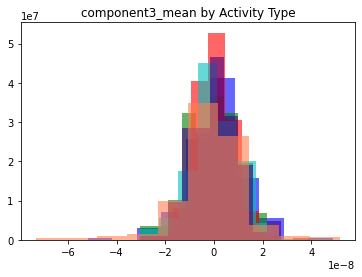

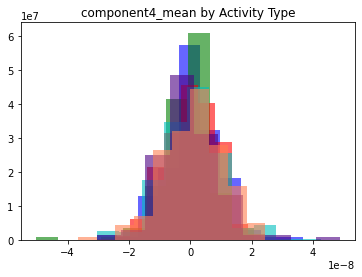

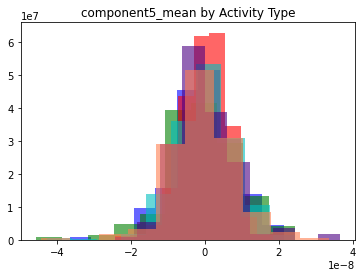

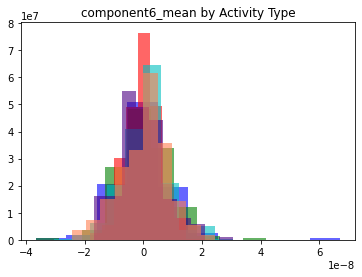

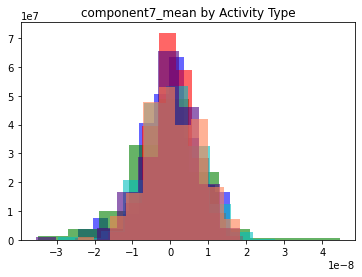

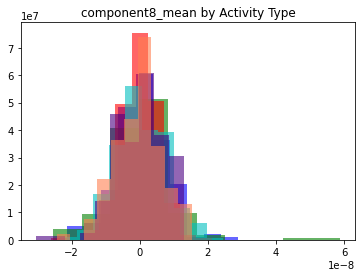

In [263]:
for col in mean_cols:
    plt.hist(other_means[col], density = True, color = 'b', alpha = 0.6)
    plt.hist(lpd_means[col], density = True, color = 'g', alpha = 0.6)
    plt.hist(gpd_means[col], density = True, color = 'r', alpha = 0.6)
    plt.hist(lrda_means[col], density = True, color = 'c', alpha = 0.6)
    plt.hist(grda_means[col], density = True, color = 'indigo', alpha = 0.6)
    plt.hist(seizure_means[col], density = True, color = 'coral', alpha = 0.6)
    plt.title('{} by Activity Type'.format(col))
    plt.show()`

#### Notes on the Above Histograms

The mean data overlaps across activity type substantially for each component. This doesn't seem like it will be useful as a feature and so, I'll exclude this data and move on to other feature data.

### Welch and Frequency Domain Features

Band power analysis is one of the most common ways EEG analysis is done. This involves transforming the time series data (the raw EEG signals) into frequency data and calculating the power spectral density. The transformation is often done via Fast Fourier Transform or Short-Time Fourier Transform.  
  
Scipy has functions for both of these, but it also has a function called Welch which runs multiple FFTs on each column of data with different start points for each FFT (if I understood the explanation correctly). Then it averages results and that's the transformation. I believe the purpose of this is that EEG signal data is so noisy, running multiple FFTs and averaging is more likely to give accurate results than running an FFT once. Welch's function returns the power spectral density data. The frequency range returned is half the sampling frequency. So, my data has a sampling frequency of 200 Hz. The frequency range will be 0-100 Hz. The relevant range for band power analysis is 1-30 Hz as mentioned before.  
  
The feature data I'm going to pull is going to consist of the area under the curve for each of the relevant frequency bands. Typically, data preprocessing would include removing any artifacts that alter the EEG signal. This can result in errors like the consistent spikes at 60 Hz shown in the initial PSD data plots. There are a few ways to implement this, but I'm not familiar enough with EEG analysis to do this correctly. The examples I've found often use EEG data structured differently than the data I have (different sampline frequency, different number of columns/channels) and also have different goals (removing blink artifacts, or doing sleep analysis with EEG data). If I had even more time, I'd figure out how to implement the functions in the MNE package which is specifically for EEG analysis.

In [266]:
band_test = preprocess(get_sub_eeg(training, 3000))
band_test, evr = principal_components(band_test, 8)

In [269]:
test_f, test_pxx = welch(band_test)

In [277]:
alpha_band = [8, 12]
beta_band = [12, 30]

alpha = np.trapz(test_pxx[0][(test_f[0] >=alpha_band[0]) & (test_f[0] <= alpha_band[1])], test_f[0][(test_f[0] >= alpha_band[0]) & (test_f[0] <= alpha_band[1])])
beta = np.trapz(test_pxx[0][(test_f[0] >=beta_band[0]) & (test_f[0] <= beta_band[1])], test_f[0][(test_f[0] >= beta_band[0]) & (test_f[0] <= beta_band[1])])

In [278]:
alpha, beta

(0.4344834014773369, 3.474308375734836)

There are four relevant bands typically for EEG Analysis: Delta (1-4 Hz), Theta (4-8 Hz), Alpha (8-12 Hz), and Beta (12-30 Hz). The especially important bands for this specific problem are the Alpha and Beta bands. I'm going to use np.trapz to get integrate between these two frequency ranges.

In [279]:
def get_band_features(f, pxx):
    alpha_band = [8, 12]
    beta_band = [12, 30]
    alphas, betas = [], []
    for i in range(len(f)):
        a = np.trapz(pxx[i][(f[i] >= alpha_band[0]) & (f[i] <= alpha_band[1])], f[i][(f[i] >= alpha_band[0]) & (f[i] <= alpha_band[1])])
        b = np.trapz(pxx[i][(f[i] >= beta_band[0]) & (f[i] <= beta_band[1])], f[i][(f[i] >= beta_band[0]) & (f[i] <= beta_band[1])])
        alphas.append(a)
        betas.append(b)
    return alphas, betas

In [299]:
alphas, betas = [], []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    f, pxx = welch(reduced_eeg)
    a, b = get_band_features(f, pxx)
    alphas.append(a)
    betas.append(b)

In [301]:
alpha_df = pd.DataFrame(alphas, columns = acols)
beta_df = pd.DataFrame(betas, columns = bcols)

In [302]:
alpha_df['activity'] = activity
beta_df['activity'] = activity

In [303]:
other_alpha = alpha_df[alpha_df['activity'] == 'Other']
other_beta = beta_df[beta_df['activity'] == 'Other']
lpd_alpha = alpha_df[alpha_df['activity'] == 'LPD']
lpd_beta = beta_df[beta_df['activity'] == 'LPD']
gpd_alpha = alpha_df[alpha_df['activity'] == 'GPD']
gpd_beta = beta_df[beta_df['activity'] == 'GPD']
lrda_alpha = alpha_df[alpha_df['activity'] == 'LRDA']
lrda_beta = beta_df[beta_df['activity'] == 'LRDA']
grda_alpha = alpha_df[alpha_df['activity'] == 'GRDA']
grda_beta = beta_df[beta_df['activity'] == 'GRDA']
seizure_alpha = alpha_df[alpha_df['activity'] == 'Seizure']
seizure_beta = beta_df[beta_df['activity'] == 'Seizure']

### Alpha Histograms

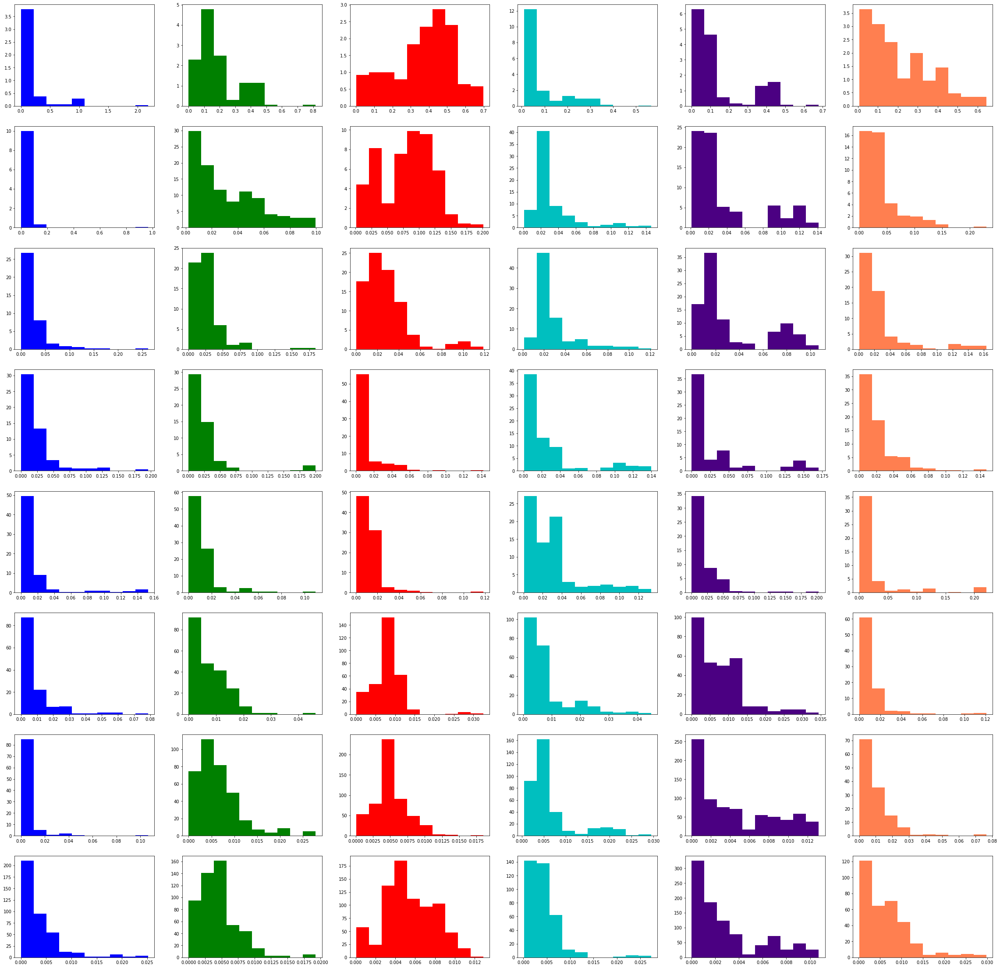

In [304]:
act_alphas = [other_alpha, lpd_alpha, gpd_alpha, lrda_alpha, grda_alpha, seizure_alpha]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(acols)):
    for j in range(len(act_alphas)):
        axs[i][j].hist(act_alphas[j][acols[i]], density = True, color = colors[j])

plt.show()

### Beta Histograms

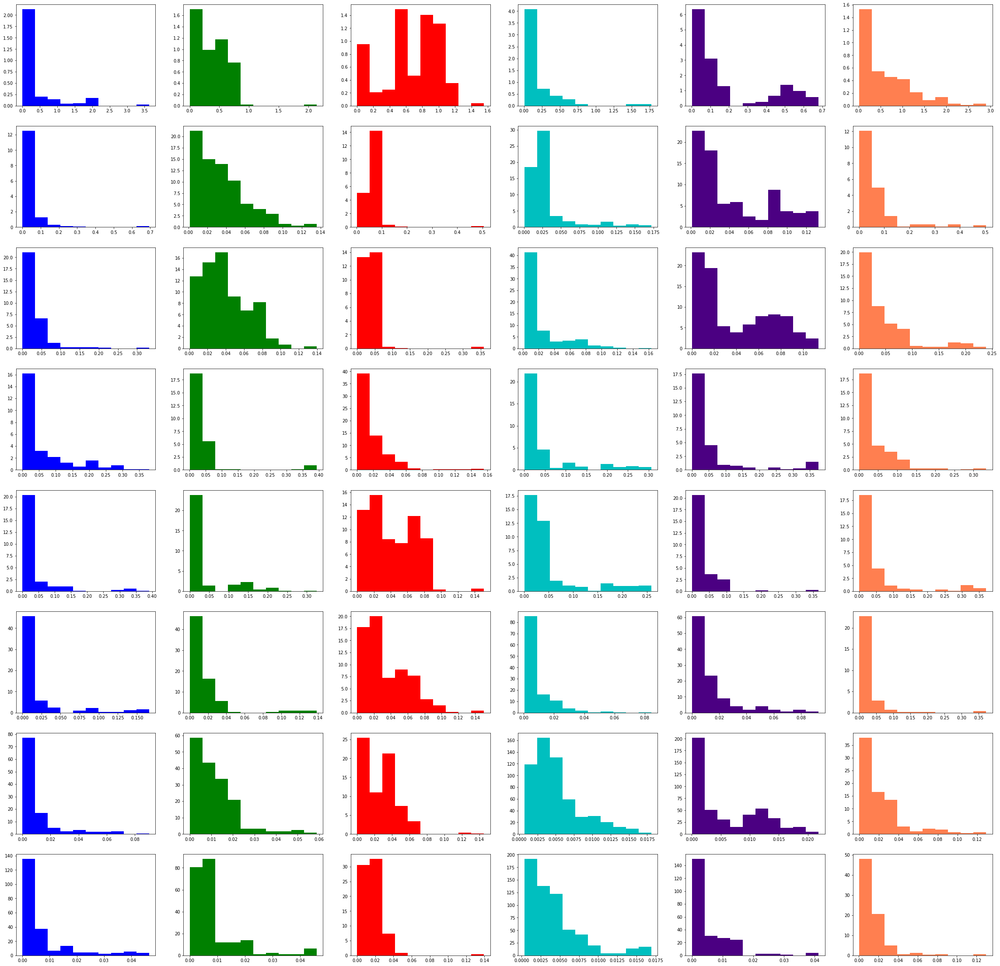

In [305]:
act_betas = [other_beta, lpd_beta, gpd_beta, lrda_beta, grda_beta, seizure_beta]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(bcols)):
    for j in range(len(act_betas)):
        axs[i][j].hist(act_betas[j][bcols[i]], density = True, color = colors[j])

plt.show()

### Plotting These Histograms Overlapping

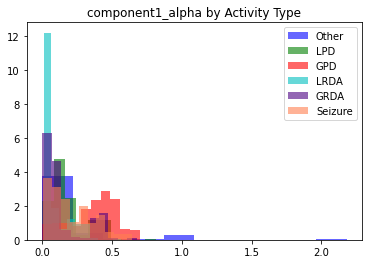

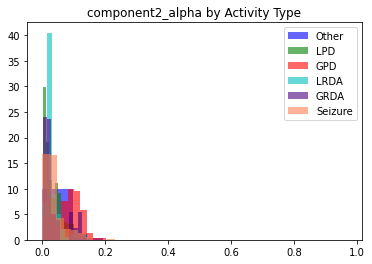

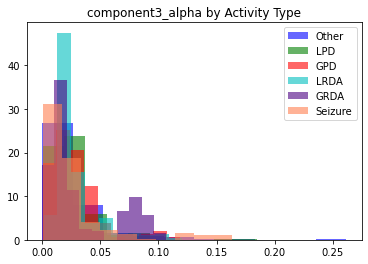

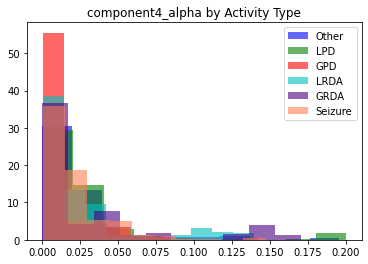

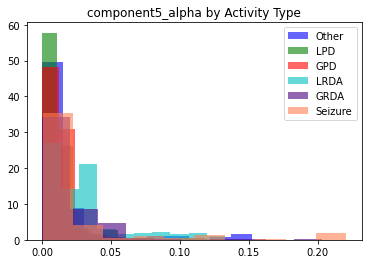

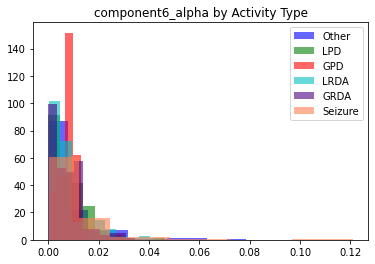

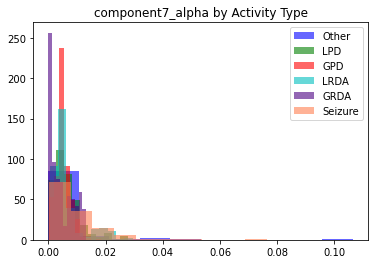

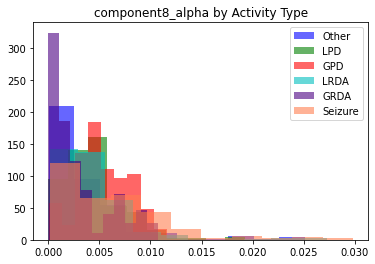

In [310]:
for col in acols:
    plt.hist(other_alpha[col], density = True, color = 'b', alpha = 0.6, label = 'Other')
    plt.hist(lpd_alpha[col], density = True, color = 'g', alpha = 0.6, label = 'LPD')
    plt.hist(gpd_alpha[col], density = True, color = 'r', alpha = 0.6, label = 'GPD')
    plt.hist(lrda_alpha[col], density = True, color = 'c', alpha = 0.6, label = 'LRDA')
    plt.hist(grda_alpha[col], density = True, color = 'indigo', alpha = 0.6, label = 'GRDA')
    plt.hist(seizure_alpha[col], density = True, color = 'coral', alpha = 0.6, label = 'Seizure')
    plt.title('{} by Activity Type'.format(col))
    plt.legend()
    plt.show()

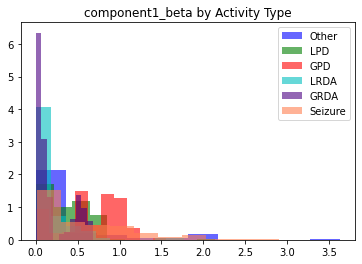

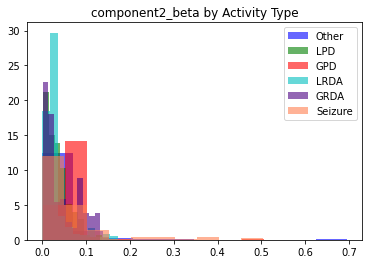

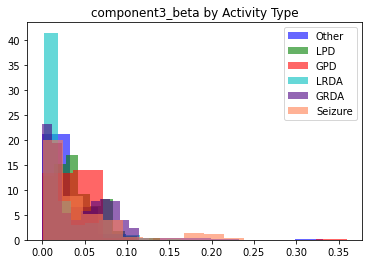

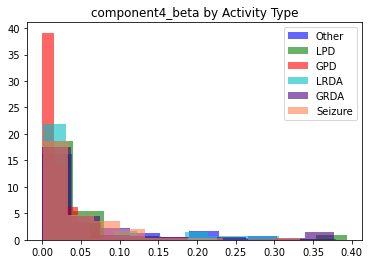

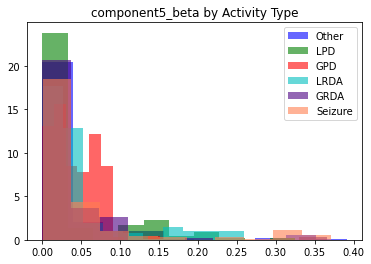

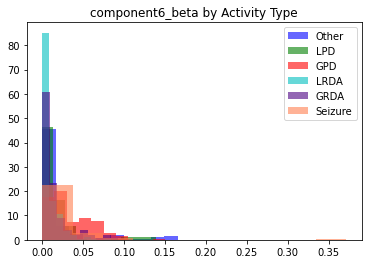

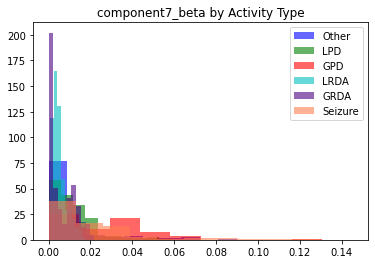

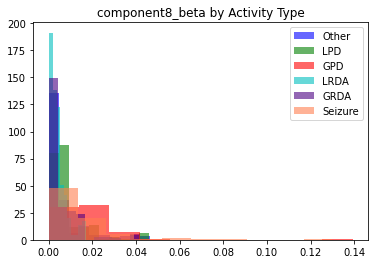

In [309]:
for col in bcols:
    plt.hist(other_beta[col], density = True, color = 'b', alpha = 0.6, label = 'Other')
    plt.hist(lpd_beta[col], density = True, color = 'g', alpha = 0.6, label = 'LPD')
    plt.hist(gpd_beta[col], density = True, color = 'r', alpha = 0.6, label = 'GPD')
    plt.hist(lrda_beta[col], density = True, color = 'c', alpha = 0.6, label = 'LRDA')
    plt.hist(grda_beta[col], density = True, color = 'indigo', alpha = 0.6, label = 'GRDA')
    plt.hist(seizure_beta[col], density = True, color = 'coral', alpha = 0.6, label = 'Seizure')
    plt.title('{} by Activity Type'.format(col))
    plt.legend()
    plt.show()

There are some differences between activity types in both the alpha and beta plots, but I  think I should expect more significant differences. There's a lot of overlap and most of the data is confined to the left end of the histogram. This might be because I was unable to remove the artifacts causing spikes at frequencies outside of this range. Certainly that would change the values some and the area under the curve in the 1-30 Hz range would be greater, but I don't know if that would produce significant differences between activity type or if it would just change the distribution of each activity type in the same way since, at least in the case of the spike at 60 Hz, the high frequency spikes showed up fairly often and across multiple different activity types.

### Hjorth Parameters

There is a package called antropy which has a function that calculates two of three hjorth parameters for EEG analysis. The returns are mobility and complexity. It will give one mobility calculation and one complexity calculation per column. So, after PCA, each sub EEG will get 16 features. 8 mobilities and 8 complexities.  
  
The documentation for the function gives the following explanation:  
  
Hjorth Parameters are indicators of statistical properties used in signal processing in the time domain introduced by Bo Hjorth in 1970. The parameters are activity, mobility, and complexity. EntroPy only returns the mobility and complexity parameters, since activity is simply the variance of x, which can be computed easily.  
  
The **mobility** parameter represents the mean frequency or the proportion of standard deviation of the power spectrum. This is defined as the square root of variance of the first derivative of x divided by the variance of x.  
  
The **complexity** gives an estimate of the bandwidth of the signal, which indicates the similarity of the shape of the signal to a pure sine wave (where the value converges to 1). Complexity is defined as the ratio of the mobility of the first derivative of x to the mobility of x.

I've already calculated variance over specified intervals for each sub EEG, but I can also easily calculate overall variance by column for each sub EEG and use that as a feature, as well.

### Mobility and Complexity

In [311]:
import antropy as ant

In [312]:
hjorth_test = preprocess(get_sub_eeg(training, 225))
hjorth_test, evr = principal_components(hjorth_test, 8)

In [313]:
mobs, coms = [], []
for col in hjorth_test.columns:
    mob, com = ant.hjorth_params(hjorth_test[col])
    mobs.append(mob)
    coms.append(com)

In [314]:
mobs, coms

([0.58035785,
  0.19239463,
  1.47979,
  0.2627654,
  1.4683421,
  0.2869604,
  0.27404574,
  0.3409409],
 [2.7199717,
  4.969899,
  1.0925142,
  4.331692,
  1.1007499,
  3.567973,
  3.9525166,
  4.1812577])

In [315]:
mobility = []
complexity = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    mobs, coms = [], []
    for col in reduced_eeg.columns:
        mob, com = ant.hjorth_params(reduced_eeg[col])
        mobs.append(mob)
        coms.append(com)
    mobility.append(mobs)
    complexity.append(coms)

In [316]:
mcols = ['{}_mobility'.format(col) for col in reduced_eeg.columns]
ccols = ['{}_complexity'.format(col) for col in reduced_eeg.columns]

In [317]:
mobility_df = pd.DataFrame(mobility, columns = mcols)
complexity_df = pd.DataFrame(complexity, columns = ccols)
mobility_df['activity'] = activity
complexity_df['activity'] = activity

In [318]:
other_mob = mobility_df[mobility_df['activity'] == 'Other']
other_com = complexity_df[complexity_df['activity'] == 'Other']
lpd_mob = mobility_df[mobility_df['activity'] == 'LPD']
lpd_com = complexity_df[complexity_df['activity'] == 'LPD']
gpd_mob = mobility_df[mobility_df['activity'] == 'GPD']
gpd_com = complexity_df[complexity_df['activity'] == 'GPD']
lrda_mob = mobility_df[mobility_df['activity'] == 'LRDA']
lrda_com = complexity_df[complexity_df['activity'] == 'LRDA']
grda_mob = mobility_df[mobility_df['activity'] == 'GRDA']
grda_com = complexity_df[complexity_df['activity'] == 'GRDA']
seizure_mob = mobility_df[mobility_df['activity'] == 'Seizure']
seizure_com = complexity_df[complexity_df['activity'] == 'Seizure']

### Hjorth Mobility Histograms

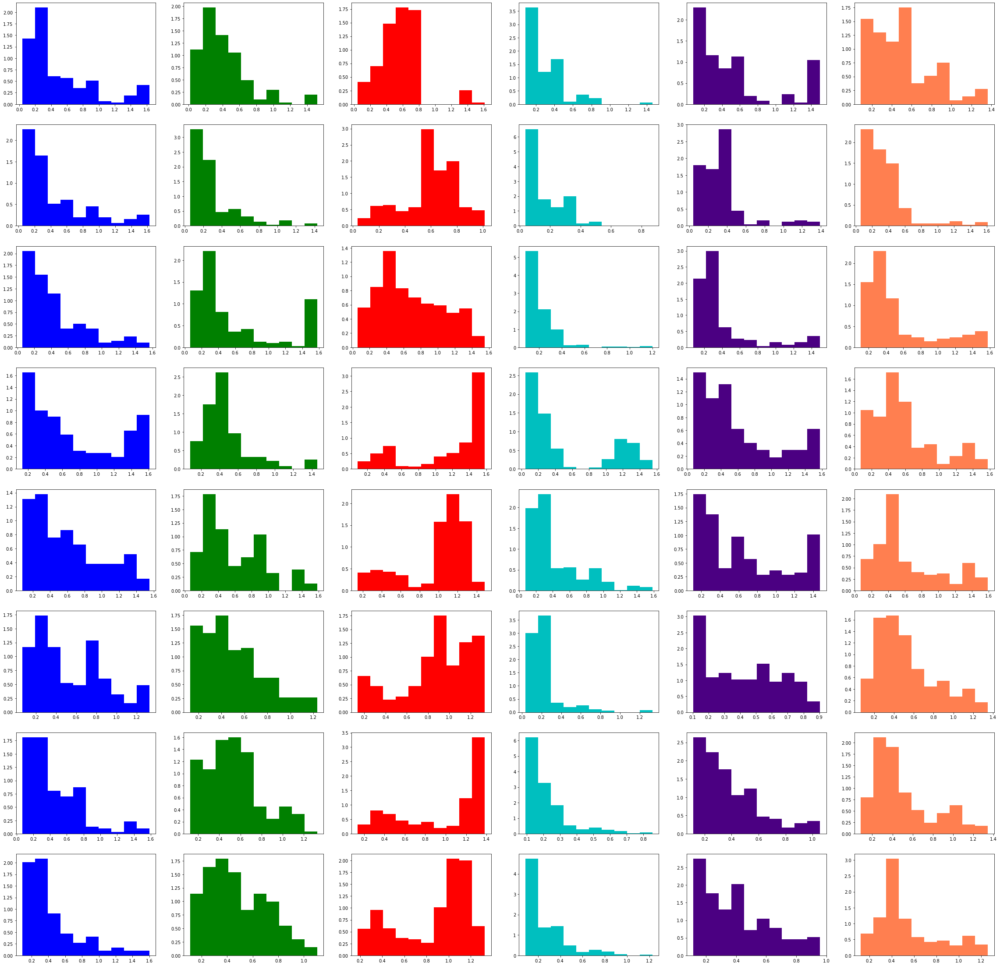

In [319]:
act_mobs = [other_mob, lpd_mob, gpd_mob, lrda_mob, grda_mob, seizure_mob]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(mcols)):
    for j in range(len(act_mobs)):
        axs[i][j].hist(act_mobs[j][mcols[i]], density = True, color = colors[j])

plt.show()

### Hjorth Complexity Histograms

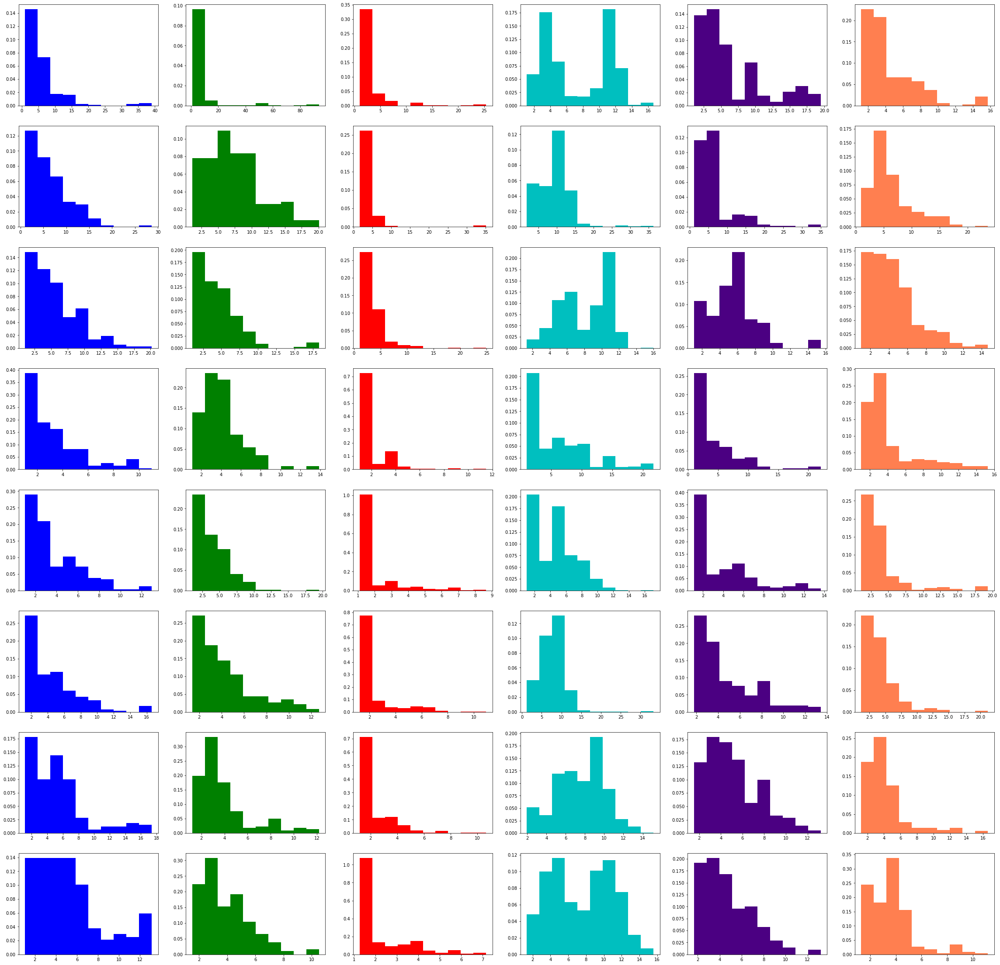

In [320]:
act_coms = [other_com, lpd_com, gpd_com, lrda_com, grda_com, seizure_com]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(ccols)):
    for j in range(len(act_coms)):
        axs[i][j].hist(act_coms[j][ccols[i]], density = True, color = colors[j])

plt.show()

These two parameters look useful. There are some distinct differences, especially for a few components. The last component of the complexity deta is a good example of this with Other and LRDA standing out as well. GPD is consistently low complexity across each component. GPD has very high mobility at a few components and Other and LRDA tend to have very low mobility.

### Higuchi Fractal Dimension  
  
This will be the last feature I calculate. I have variance at different intervals, I have peak to peak data, I have band power data, and I have Hjorth mobility and complexity. All of this together gives me more than 100 features. That number will need to be reduced in the feature selection stage, but having this many gives me a better chance of having useful features and getting solid results. If I had more time, I might get ICA features and test a couple of other fractal dimension functions out, but I need to get to the point where I've run a model.  
  
The Higuchi Fractal Dimension function also comes from antropy. This is something I've seen mentioned as being used to do EEG analysis and antropy having a built in function to calculate it made me think I should see what kind of results I get with it at least.  
  
One paper I came across compared Katz's algorithm, Higuchi's algorithm, and Petrosian algorithm in identifying properties of onset epilepsy from EEG signals. Katz and Higuchi were both listed as effective. Petrosian depended on the type of binary sequence.

In [321]:
from antropy import fractal

In [324]:
hfds = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    col_hfds = []
    for col in reduced_eeg.columns:
        hfd = fractal.higuchi_fd(reduced_eeg[col])
        col_hfds.append(hfd)
    hfds.append(col_hfds)

In [325]:
higuchi_cols = ['{}_higuchi'.format(col) for col in reduced_eeg.columns]
higuchi_df = pd.DataFrame(hfds, columns = higuchi_cols)
higuchi_df['activity'] = activity

In [327]:
other_hfd = higuchi_df[higuchi_df['activity'] == 'Other']
lpd_hfd = higuchi_df[higuchi_df['activity'] == 'LPD']
gpd_hfd = higuchi_df[higuchi_df['activity'] == 'GPD']
lrda_hfd = higuchi_df[higuchi_df['activity'] == 'LRDA']
grda_hfd = higuchi_df[higuchi_df['activity'] == 'GRDA']
seizure_hfd = higuchi_df[higuchi_df['activity'] == 'Seizure']

### Higuchi Fractal Histograms

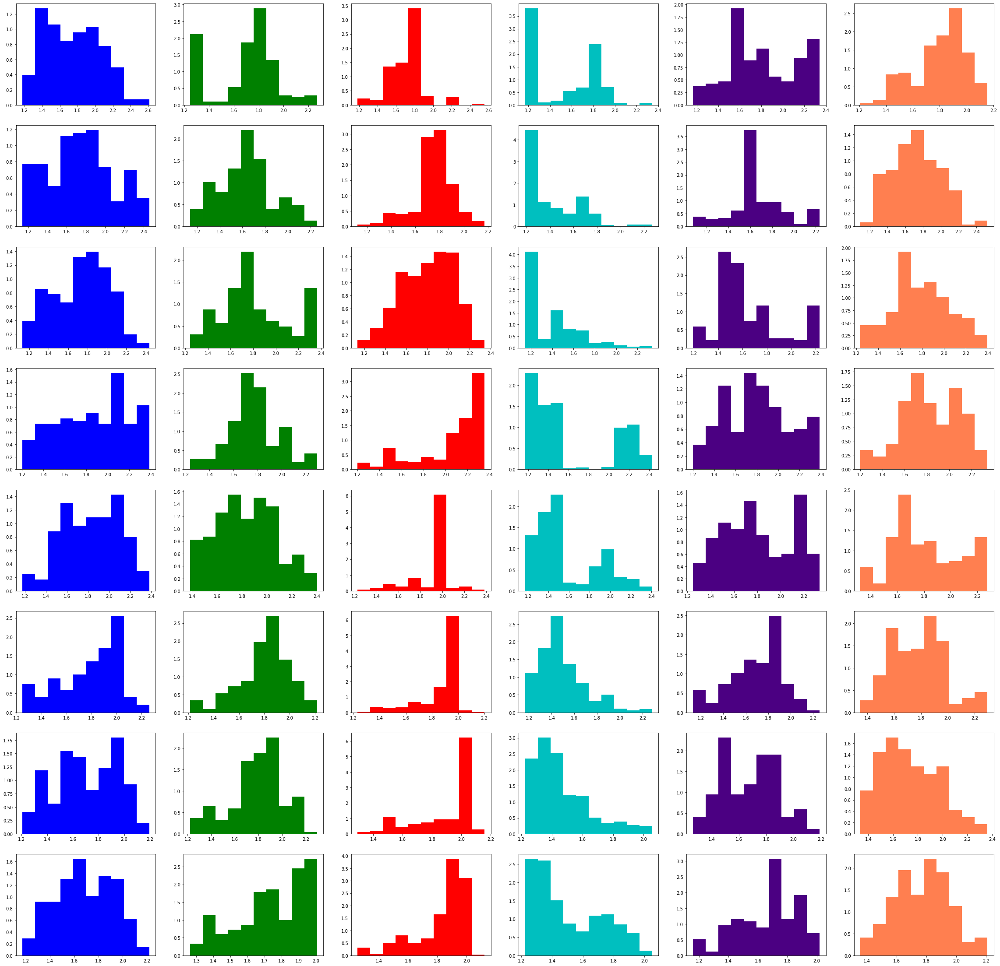

In [328]:
act_hfds = [other_hfd, lpd_hfd, gpd_hfd, lrda_hfd, grda_hfd, seizure_hfd]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(higuchi_cols)):
    for j in range(len(act_hfds)):
        axs[i][j].hist(act_hfds[j][higuchi_cols[i]], density = True, color = colors[j])

plt.show()

### Katz Fractal Dimension  
  
The Higuchi calculation didn't take too long, so I'm going to try Katz, too.

In [331]:
kfds = []
for i in range(2000):
    sub_eeg = preprocess(get_sub_eeg(training, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    col_kfds = []
    for col in reduced_eeg.columns:
        kfd = fractal.katz_fd(reduced_eeg[col])
        col_kfds.append(kfd)
    kfds.append(col_kfds)

In [332]:
kcols = ['{}_katz'.format(col) for col in reduced_eeg.columns]
katz_df = pd.DataFrame(kfds, columns = kcols)
katz_df['activity'] = activity

In [333]:
other_katz = katz_df[katz_df['activity'] == 'Other']
lpd_katz = katz_df[katz_df['activity'] == 'LPD']
gpd_katz = katz_df[katz_df['activity'] == 'GPD']
lrda_katz = katz_df[katz_df['activity'] == 'LRDA']
grda_katz = katz_df[katz_df['activity'] == 'GRDA']
seizure_katz = katz_df[katz_df['activity'] == 'Seizure']

### Katz Fractal Histograms

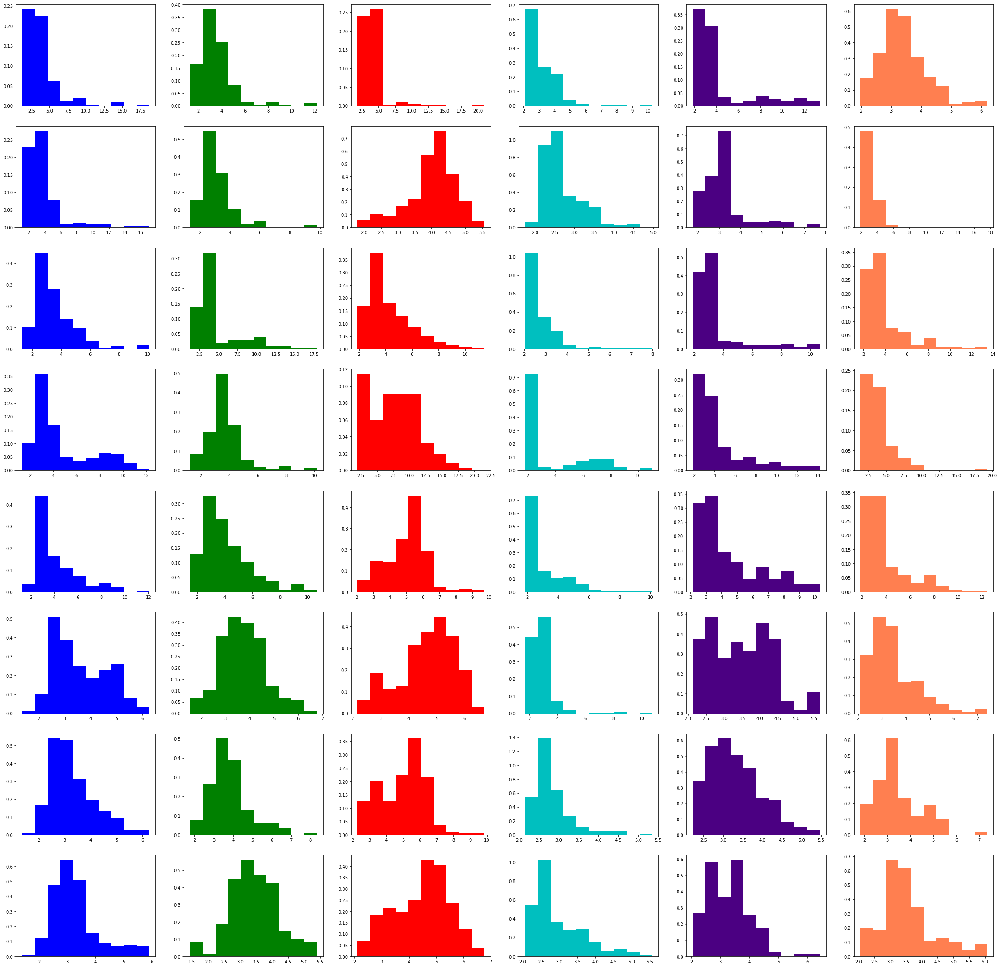

In [334]:
act_kfds = [other_katz, lpd_katz, gpd_katz, lrda_katz, grda_katz, seizure_katz]
colors = ['b', 'g', 'r', 'c', 'indigo', 'coral']
fig, axs = plt.subplots(8, 6)
fig.set_figheight(40)
fig.set_figwidth(40)
for i in range(len(kcols)):
    for j in range(len(act_kfds)):
        axs[i][j].hist(act_kfds[j][kcols[i]], density = True, color = colors[j])

plt.show()

Based on the histogram, it seems like there's more consistent difference between activity type in the Higuchi data than in the Katz data, but they both look likely to be useful.

### Machine Learning

**Problem Formulation:**  
  
The problem formulation section for machine learning for this project will require less work because the features are chosen and extracted from the given data and not given up front. There won't be duplicate columns or one hot encoded features. It's all extracted from highly variable continuous data. The little bit of problem formulation work will be feature selection. I plan to run a model with all of my features first (unless something stands out as useless in the above plots), and then do feature selection using one of the methods provided by sklearn.  
  
I will have to encode the target variable potentially. That will be determined by the model I choose. Some sklearn models handle categorical target variables and so encoding (which would be done via label encoding) should probably be avoided in those instances.

#### Splitting the Data  
  
My computer won't process all 17k of the EEGs, so what I need to do instead is take a percentage of the data that preserves the spread of the target variable. The plan is to start with 10%. That's more than 10k rows. I've had problems processing less data than that while doing this, so if it doesn't work, I'll reduce the number of rows even more. The thought right now is that 5000 will work. A 60/20/20 train/validation/test split of that would be 3000/1000/1000. It isn't ideal, but the spread of the target variable over 5000 rows should be close to the spread of the target variable over the entire dataset.

In [338]:
df_10

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10642,862310335,0,0.0,200303629,77,1194.0,2962311535,57480,Other,0,0,0,0,0,1
10643,3671962049,0,0.0,200303629,78,1466.0,323074244,57480,Other,0,0,0,0,0,1
10644,2357552740,0,0.0,200303629,79,1874.0,1993344137,57480,Seizure,3,0,0,0,0,0
10645,2357552740,1,6.0,200303629,80,1880.0,3714973024,57480,Seizure,3,0,0,0,0,0


In [433]:
X = df_10.drop(columns = 'expert_consensus')
y = df_10['expert_consensus']

In [434]:
from sklearn.model_selection import train_test_split

In [435]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.4)

In [436]:
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size = 0.5)

In [437]:
len(X_val), len(X_test)

(2129, 2130)

In [438]:
y_train.value_counts(normalize = True)

expert_consensus
Seizure    0.206011
GRDA       0.173137
Other      0.159518
LRDA       0.159205
GPD        0.153882
LPD        0.148247
Name: proportion, dtype: float64

In [439]:
y_val.value_counts(normalize = True)

expert_consensus
Seizure    0.210897
LRDA       0.172381
GPD        0.163457
GRDA       0.162987
LPD        0.147487
Other      0.142790
Name: proportion, dtype: float64

In [440]:
y_test.value_counts(normalize = True)

expert_consensus
Seizure    0.207512
LRDA       0.169484
GRDA       0.167136
GPD        0.157746
LPD        0.152582
Other      0.145540
Name: proportion, dtype: float64

In [441]:
training['expert_consensus'].value_counts(normalize = True)

expert_consensus
Seizure    0.195802
GRDA       0.176820
Other      0.175730
GPD        0.156532
LRDA       0.156100
LPD        0.139016
Name: proportion, dtype: float64

This does change the ordering of which categories have the most data, but the percentages are very close.

In [442]:
X_train = X_train.reset_index()
X_val = X_val.reset_index()
X_test = X_test.reset_index()
y_train = y_train.reset_index()
y_val = y_val.reset_index()
y_test = y_test.reset_index()

In [443]:
X_train = X_train.drop(columns = 'index')
X_val = X_val.drop(columns = 'index')
X_test = X_test.drop(columns = 'index')
y_train = y_train.drop(columns = 'index')
y_val = y_val.drop(columns = 'index')
y_test = y_test.drop(columns = 'index')

### Generating My Dataframes 

**Features:**  
  
Interval Peak to Peak (5 per component, 40 per sub EEG)  
Interval Variance (5 per component, 40 per sub EEG)  
Alpha Band Power (1 per component, 8 per sub EEG)  
Beta Band Power (1 per component, 8 per sub EEG)  
Hjorth Mobility (1 per component, 8 per sub EEG)  
Hjorth Complexity (1 per component, 8 per sub EEG)  
Higuchi Fractal Dimension (1 per component, 8 per sub EEG)  
Katz Fractal Dimension (1 per component, 8 per sub EEG)  
  
Looping over each of these functions might kill the kernel, so I may end up having to loop over them separately like I did above.

In [444]:
def interval_ptp(data, first_row):
    ptps = []
    segment = data.iloc[first_row: (first_row + 2000)]
    for col in segment.columns:
        ptps.append(np.ptp(segment[col]))
    return np.asarray(ptps)

In [445]:
def interval_var(data, first_row):
    variances = []
    segment = data.iloc[first_row: (first_row + 2000)]
    for col in segment.columns:
        variances.append(np.var(segment[col]))
    return np.asarray(variances)

In [446]:
def get_band_features(f, pxx):
    alpha_band = [8, 12]
    beta_band = [12, 30]
    alphas, betas = [], []
    for i in range(len(f)):
        a = np.trapz(pxx[i][(f[i] >= alpha_band[0]) & (f[i] <= alpha_band[1])], f[i][(f[i] >= alpha_band[0]) & (f[i] <= alpha_band[1])])
        b = np.trapz(pxx[i][(f[i] >= beta_band[0]) & (f[i] <= beta_band[1])], f[i][(f[i] >= beta_band[0]) & (f[i] <= beta_band[1])])
        alphas.append(a)
        betas.append(b)
    return alphas, betas

In [447]:
def mobility_complexity(data):
    mobs, coms = [], []
    for col in data.columns:
        mob, com = ant.hjorth_params(data[col])
        mobs.append(mob)
        coms.append(com)
    return mobs, coms

In [448]:
def higuchi(data):
    hfds = []
    for col in data.columns:
        hfd = fractal.higuchi_fd(data[col])
        hfds.append(hfd)
    return hfds

In [449]:
def katz(data):
    kfds = []
    for col in data.columns:
        katz = fractal.katz_fd(data[col])
        kfds.append(katz)
    return kfds

### Training Features

In [450]:
ptp_10s, ptp_20s, ptp_30s, ptp_40s, ptp_50s = [], [], [], [], []
var_10s, var_20s, var_30s, var_40s, var_50s = [], [], [], [], []
alpha_power, beta_power = [], []
mobility, complexity = [], []
higuchi_fds = []
katz_fds = []

for i in range(X_train.shape[0]):
    sub_eeg = preprocess(get_sub_eeg(X_train, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    f, pxx = welch(reduced_eeg)
    ptp_10s.append(interval_ptp(reduced_eeg, 0))
    ptp_20s.append(interval_ptp(reduced_eeg, 2000))
    ptp_30s.append(interval_ptp(reduced_eeg, 4000))
    ptp_40s.append(interval_ptp(reduced_eeg, 6000))
    ptp_50s.append(interval_ptp(reduced_eeg, 8000))
    var_10s.append(interval_var(reduced_eeg, 0))
    var_20s.append(interval_var(reduced_eeg, 2000))
    var_30s.append(interval_var(reduced_eeg, 4000))
    var_40s.append(interval_var(reduced_eeg, 6000))
    var_50s.append(interval_var(reduced_eeg, 8000))
    alphas, betas = get_band_features(f, pxx)
    alpha_power.append(alphas)
    beta_power.append(betas)
    m, c = mobility_complexity(reduced_eeg)
    mobility.append(m)
    complexity.append(c)
    hfd = higuchi(reduced_eeg)
    higuchi_fds.append(hfd)
    kfd = katz(reduced_eeg)
    katz_fds.append(kfd)

### Validation Features

In [451]:
v_ptp_10s, v_ptp_20s, v_ptp_30s, v_ptp_40s, v_ptp_50s = [], [], [], [], []
v_var_10s, v_var_20s, v_var_30s, v_var_40s, v_var_50s = [], [], [], [], []
v_alpha_power, v_beta_power = [], []
v_mobility, v_complexity = [], []
v_higuchi_fds = []
v_katz_fds = []

for i in range(X_val.shape[0]):
    sub_eeg = preprocess(get_sub_eeg(X_val, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    f, pxx = welch(reduced_eeg)
    v_ptp_10s.append(interval_ptp(reduced_eeg, 0))
    v_ptp_20s.append(interval_ptp(reduced_eeg, 2000))
    v_ptp_30s.append(interval_ptp(reduced_eeg, 4000))
    v_ptp_40s.append(interval_ptp(reduced_eeg, 6000))
    v_ptp_50s.append(interval_ptp(reduced_eeg, 8000))
    v_var_10s.append(interval_var(reduced_eeg, 0))
    v_var_20s.append(interval_var(reduced_eeg, 2000))
    v_var_30s.append(interval_var(reduced_eeg, 4000))
    v_var_40s.append(interval_var(reduced_eeg, 6000))
    v_var_50s.append(interval_var(reduced_eeg, 8000))
    alphas, betas = get_band_features(f, pxx)
    v_alpha_power.append(alphas)
    v_beta_power.append(betas)
    m, c = mobility_complexity(reduced_eeg)
    v_mobility.append(m)
    v_complexity.append(c)
    hfd = higuchi(reduced_eeg)
    v_higuchi_fds.append(hfd)
    kfd = katz(reduced_eeg)
    v_katz_fds.append(kfd)

### Testing Features

In [452]:
test_ptp_10s, test_ptp_20s, test_ptp_30s, test_ptp_40s, test_ptp_50s = [], [], [], [], []
test_var_10s, test_var_20s, test_var_30s, test_var_40s, test_var_50s = [], [], [], [], []
test_alpha_power, test_beta_power = [], []
test_mobility, test_complexity = [], []
test_higuchi_fds = []
test_katz_fds = []

for i in range(X_test.shape[0]):
    sub_eeg = preprocess(get_sub_eeg(X_test, i))
    reduced_eeg, evr = principal_components(sub_eeg, 8)
    f, pxx = welch(reduced_eeg)
    test_ptp_10s.append(interval_ptp(reduced_eeg, 0))
    test_ptp_20s.append(interval_ptp(reduced_eeg, 2000))
    test_ptp_30s.append(interval_ptp(reduced_eeg, 4000))
    test_ptp_40s.append(interval_ptp(reduced_eeg, 6000))
    test_ptp_50s.append(interval_ptp(reduced_eeg, 8000))
    test_var_10s.append(interval_var(reduced_eeg, 0))
    test_var_20s.append(interval_var(reduced_eeg, 2000))
    test_var_30s.append(interval_var(reduced_eeg, 4000))
    test_var_40s.append(interval_var(reduced_eeg, 6000))
    test_var_50s.append(interval_var(reduced_eeg, 8000))
    alphas, betas = get_band_features(f, pxx)
    test_alpha_power.append(alphas)
    test_beta_power.append(betas)
    m, c = mobility_complexity(reduced_eeg)
    test_mobility.append(m)
    test_complexity.append(c)
    hfd = higuchi(reduced_eeg)
    test_higuchi_fds.append(hfd)
    kfd = katz(reduced_eeg)
    test_katz_fds.append(kfd)

**Column Names**

In [453]:
pcol_10s = ['{}_ptp10'.format(col) for col in reduced_eeg]
pcol_20s = ['{}_ptp20'.format(col) for col in reduced_eeg]
pcol_30s = ['{}_ptp30'.format(col) for col in reduced_eeg]
pcol_40s = ['{}_ptp40'.format(col) for col in reduced_eeg]
pcol_50s = ['{}_ptp50'.format(col) for col in reduced_eeg]
vcol_10s = ['{}_var10'.format(col) for col in reduced_eeg]
vcol_20s = ['{}_var20'.format(col) for col in reduced_eeg]
vcol_30s = ['{}_var30'.format(col) for col in reduced_eeg]
vcol_40s = ['{}_var40'.format(col) for col in reduced_eeg]
vcol_50s = ['{}_var50'.format(col) for col in reduced_eeg]
alphacols = ['{}_alpha'.format(col) for col in reduced_eeg]
betacols = ['{}_beta'.format(col) for col in reduced_eeg]
mobcols = ['{}_mobility'.format(col) for col in reduced_eeg]
comcols = ['{}_complexity'.format(col) for col in reduced_eeg]
hcols = ['{}_higuchi'.format(col) for col in reduced_eeg]
kcols = ['{}_katz'.format(col) for col in reduced_eeg]

**DataFrames**

In [454]:
df_ptp10 = pd.DataFrame(ptp_10s, columns = pcol_10s)
df_ptp20 = pd.DataFrame(ptp_20s, columns = pcol_20s)
df_ptp30 = pd.DataFrame(ptp_30s, columns = pcol_30s)
df_ptp40 = pd.DataFrame(ptp_40s, columns = pcol_40s)
df_ptp50 = pd.DataFrame(ptp_50s, columns = pcol_50s)
df_var10 = pd.DataFrame(var_10s, columns = vcol_10s)
df_var20 = pd.DataFrame(var_20s, columns = vcol_20s)
df_var30 = pd.DataFrame(var_30s, columns = vcol_30s)
df_var40 = pd.DataFrame(var_40s, columns = vcol_40s)
df_var50 = pd.DataFrame(var_50s, columns = vcol_50s)
df_alpha = pd.DataFrame(alpha_power, columns = alphacols)
df_beta = pd.DataFrame(beta_power, columns = betacols)
df_mob = pd.DataFrame(mobility, columns = mobcols)
df_com = pd.DataFrame(complexity, columns = comcols)
df_higuchi = pd.DataFrame(higuchi_fds, columns = hcols)
df_katz = pd.DataFrame(katz_fds, columns = kcols)

In [455]:
vdf_ptp10 = pd.DataFrame(v_ptp_10s, columns = pcol_10s)
vdf_ptp20 = pd.DataFrame(v_ptp_20s, columns = pcol_20s)
vdf_ptp30 = pd.DataFrame(v_ptp_30s, columns = pcol_30s)
vdf_ptp40 = pd.DataFrame(v_ptp_40s, columns = pcol_40s)
vdf_ptp50 = pd.DataFrame(v_ptp_50s, columns = pcol_50s)
vdf_var10 = pd.DataFrame(v_var_10s, columns = vcol_10s)
vdf_var20 = pd.DataFrame(v_var_20s, columns = vcol_20s)
vdf_var30 = pd.DataFrame(v_var_30s, columns = vcol_30s)
vdf_var40 = pd.DataFrame(v_var_40s, columns = vcol_40s)
vdf_var50 = pd.DataFrame(v_var_50s, columns = vcol_50s)
vdf_alpha = pd.DataFrame(v_alpha_power, columns = alphacols)
vdf_beta = pd.DataFrame(v_beta_power, columns = betacols)
vdf_mob = pd.DataFrame(v_mobility, columns = mobcols)
vdf_com = pd.DataFrame(v_complexity, columns = comcols)
vdf_higuchi = pd.DataFrame(v_higuchi_fds, columns = hcols)
vdf_katz = pd.DataFrame(v_katz_fds, columns = kcols)

In [456]:
test_df_ptp10 = pd.DataFrame(test_ptp_10s, columns = pcol_10s)
test_df_ptp20 = pd.DataFrame(test_ptp_20s, columns = pcol_20s)
test_df_ptp30 = pd.DataFrame(test_ptp_30s, columns = pcol_30s)
test_df_ptp40 = pd.DataFrame(test_ptp_40s, columns = pcol_40s)
test_df_ptp50 = pd.DataFrame(test_ptp_50s, columns = pcol_50s)
test_df_var10 = pd.DataFrame(test_var_10s, columns = vcol_10s)
test_df_var20 = pd.DataFrame(test_var_20s, columns = vcol_20s)
test_df_var30 = pd.DataFrame(test_var_30s, columns = vcol_30s)
test_df_var40 = pd.DataFrame(test_var_40s, columns = vcol_40s)
test_df_var50 = pd.DataFrame(test_var_50s, columns = vcol_50s)
test_df_alpha = pd.DataFrame(test_alpha_power, columns = alphacols)
test_df_beta = pd.DataFrame(test_beta_power, columns = betacols)
test_df_mob = pd.DataFrame(test_mobility, columns = mobcols)
test_df_com = pd.DataFrame(test_complexity, columns = comcols)
test_df_higuchi = pd.DataFrame(test_higuchi_fds, columns = hcols)
test_df_katz = pd.DataFrame(test_katz_fds, columns = kcols)

In [457]:
xtrain = pd.concat([df_ptp10, df_ptp20, df_ptp30, df_ptp40, df_ptp50, df_var10,
                        df_var20, df_var30, df_var40, df_var50, df_alpha, df_beta,
                        df_mob, df_com, df_higuchi, df_katz], axis = 1)

In [458]:
xval = pd.concat([vdf_ptp10, vdf_ptp20, vdf_ptp30, vdf_ptp40, vdf_ptp50, vdf_var10,
                        vdf_var20, vdf_var30, vdf_var40, vdf_var50, vdf_alpha, vdf_beta,
                        vdf_mob, vdf_com, vdf_higuchi, vdf_katz], axis = 1)

In [459]:
xtest = pd.concat([test_df_ptp10, test_df_ptp20, test_df_ptp30, test_df_ptp40,
                    test_df_ptp50, test_df_var10, test_df_var20, test_df_var30,
                    test_df_var40, test_df_var50, test_df_alpha, test_df_beta,
                    test_df_mob, test_df_com, test_df_higuchi, test_df_katz], axis = 1)

Now that I have my feature data and my training, validation, and testing datasets, I can consider encoding my target variable and then test a model. The feature data has already been preprocessed (this included replacing missing values with the column median, standardizing the data with StandardScaler, and dimensionality reduction with PCA which reduced the column total from 20 to 8). The feature data was calculated after all of this was done.  
  
There are 128 total features. This will be reduced in the feature selection stage. Histograms for these features were done above in order to confirm that they might be useful features to extract from the EEG data.

#### Target Variable Encoding

Both DecisionTreeClassifier and RandomForestClassifier handle categorical target variables, so encoding isn't necessary and might make results worse. The way to encode would be label encoding, but the models could then treat those encoded variables as ordinal data.

In [460]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

This is done because for some reason feeding the pandas dataframes into the models for y values can cause problems. The warning I got was 'A column-vector y was passed when a 1d array was expected.'

In [461]:
ytrain = y_train['expert_consensus']

In [462]:
yval = y_val['expert_consensus']

In [463]:
ytest = y_test['expert_consensus']

### RandomForest 1

In [464]:
forest = RandomForestClassifier() #running with default hyperparameters and all 128 features the first time through

In [465]:
forest.fit(xtrain, ytrain)

RandomForestClassifier()

In [466]:
y_predictions = forest.predict(xtest)

In [480]:
from sklearn.metrics import classification_report, accuracy_score

In [468]:
acc = accuracy_score(ytest, y_predictions)

RandomForestClassifier with default hyperparameters and all 128 features returns an accuracy score 86%.

In [469]:
acc

0.8619718309859155

In [474]:
target_names = np.unique(ytest)

In [477]:
target_names = ['GPD', 'GRDA', 'LPD', 'LRDA', 'Other', 'Seizure']

In [478]:
cr = classification_report(ytest, y_predictions, target_names = target_names)

The model did well for each class, but did considerably worse for Other than for the rest of the brain activity categories. I don't think this is surprising. It's possible the other category encompassed of wide range of possible classifications that weren't relevant here. This would likely result in more difficult to predict data.

In [479]:
print(cr)

              precision    recall  f1-score   support

         GPD       0.94      0.93      0.94       336
        GRDA       0.93      0.88      0.90       356
         LPD       0.89      0.83      0.86       325
        LRDA       0.94      0.93      0.93       361
       Other       0.73      0.67      0.70       310
     Seizure       0.77      0.91      0.83       442

    accuracy                           0.86      2130
   macro avg       0.87      0.86      0.86      2130
weighted avg       0.87      0.86      0.86      2130



In [481]:
y_proba = forest.predict_proba(xtest)

This returns a probability each sample of x is a particular type of brain activity. So each subset in y_proba contains 6 probabilities, one for each class of y. This is the form the predictions are supposed to be in. They're to be evaluated based on the KL Divergence between the predicted probabilities and the observed target. I'm not sure how to do that. There isn't an sklearn function for this. Scipy has one, but it isn't clear how I'd feed it my predicted probabilites and the observed target which is categorical. Maybe I do need to label encode. I'll try that once after doing feature selection and hyperparameter tuning, but I'll also have results evaluated with accuracy score and the classification report.

In [482]:
y_proba

array([[0.94, 0.02, 0.01, 0.  , 0.01, 0.02],
       [0.  , 0.82, 0.04, 0.02, 0.06, 0.06],
       [0.07, 0.03, 0.71, 0.1 , 0.02, 0.07],
       ...,
       [0.02, 0.04, 0.11, 0.07, 0.28, 0.48],
       [0.22, 0.11, 0.13, 0.09, 0.22, 0.23],
       [0.04, 0.17, 0.09, 0.11, 0.23, 0.36]])

### Feature Selection with SelectKBest

In [483]:
from sklearn.feature_selection import SelectKBest

In [484]:
skb = SelectKBest(k = 20)

In [485]:
x_new = skb.fit_transform(xtrain, ytrain)

In [486]:
x_new.shape

(6388, 20)

In [501]:
x_new_test = skb.transform(xtest)

In [502]:
x_new_test.shape

(2130, 20)

In [503]:
x_new_val = skb.transform(xval)

In [504]:
x_new_val.shape

(2129, 20)

In [494]:
selected_indexes = np.where(skb.get_support() == True)

In [495]:
features = xtrain.columns

Of the 20 features selected, peak to peak for component 1 in the 20-30 second interval was chosen, and then the rest of the features are either band power features, hjorth parameter features, or fractal features with higuchi once and katz three times.

In [496]:
for i in selected_indexes:
    print(features[i])

Index(['component1_ptp30', 'component1_alpha', 'component2_alpha',
       'component1_beta', 'component2_beta', 'component7_beta',
       'component8_beta', 'component4_mobility', 'component5_mobility',
       'component6_mobility', 'component7_mobility', 'component8_mobility',
       'component5_complexity', 'component6_complexity',
       'component7_complexity', 'component8_complexity', 'component6_higuchi',
       'component4_katz', 'component5_katz', 'component7_katz'],
      dtype='object')


In [497]:
forest = RandomForestClassifier()

In [498]:
forest.fit(x_new, ytrain)

RandomForestClassifier()

In [505]:
y_predictions = forest.predict(x_new_test)

In [506]:
acc = accuracy_score(ytest, y_predictions)

With just 20 features, RandomForestClassifier did nearly as well as it did with all 128. 85% accuracy score. This would be preferable because the dataset is much simpler with 100 fewer features included.

In [507]:
acc

0.8492957746478873

Normally I would want to run this loop over a larger range of feature numbers, but due to time and to avoid risk of the notebook kernel dying again, I'm running from 15 to 25 and then choosing the number of features that performs best according to accuracy score.

In [508]:
k_range = range(15, 25)

In [512]:
accuracy_scores = []

for i in k_range:
    skb = SelectKBest(k = i)
    xnew = skb.fit_transform(xtrain, ytrain)
    xnew_test = skb.transform(xtest)
    forest = RandomForestClassifier()
    forest.fit(xnew, ytrain)
    y_predictions = forest.predict(xnew_test)
    acc = accuracy_score(ytest, y_predictions)
    accuracy_scores.append(acc)

In [516]:
np.where(accuracy_scores == max(accuracy_scores))

(array([4, 9]),)

In [515]:
accuracy_scores

[0.8347417840375587,
 0.8366197183098592,
 0.8399061032863849,
 0.847887323943662,
 0.8497652582159625,
 0.8427230046948356,
 0.8431924882629108,
 0.8488262910798122,
 0.8427230046948356,
 0.8497652582159625]

The model performed fairly evenly throughout, but the max accuracy scores were for 18 features and 23 features. I'll run the model with 18 features and do hyperparameter tuning with the validation set.

In [527]:
skb = SelectKBest(k = 18)

In [528]:
xtrain_new = skb.fit_transform(xtrain, ytrain)
xval_new = skb.transform(xval)
xtest_new = skb.transform(xtest)
selected_indexes = skb.get_support()

In [529]:
selected_indexes = np.where(selected_indexes == True)

The peak to peak data is no longer included. None of the peak to peak or variance data is included. The only features included are band power features, Hjorth features, and Higuchi and Katz features. This makes sense since these features are commonly used for EEG analysis and the sort of statistical features I put together weren't. I expected them to be less useful unless something went wrong with the calculation of the other features. I did think the peak to peak data might be useful based on the histograms, but it wasn't as useful as these 18 features.

In [530]:
for i in selected_indexes:
    print(features[i])

Index(['component1_alpha', 'component2_alpha', 'component1_beta',
       'component2_beta', 'component7_beta', 'component4_mobility',
       'component5_mobility', 'component6_mobility', 'component7_mobility',
       'component8_mobility', 'component5_complexity', 'component6_complexity',
       'component7_complexity', 'component8_complexity', 'component6_higuchi',
       'component4_katz', 'component5_katz', 'component7_katz'],
      dtype='object')


### Hyperparameter Tuning with GridSearchCV

In [531]:
from sklearn.model_selection import GridSearchCV

Again, I would usually loop over more values, but due to time and risk of the kernel dying, I'm going to limit that and then run the mmodel with the parameter values the grid search returns as best.

In [535]:
parameters = {'n_estimators': [10, 50, 100], 'criterion': ('gini', 'entropy')}
forest = RandomForestClassifier()
grid = GridSearchCV(forest, parameters)
grid.fit(xval_new, yval)

GridSearchCV(estimator=RandomForestClassifier(),
             param_grid={'criterion': ('gini', 'entropy'),
                         'n_estimators': [10, 50, 100]})

The log loss criterion returned an error, so I removed that option.

In [536]:
grid.best_params_

{'criterion': 'gini', 'n_estimators': 100}

The best parameters returned are the default parameters. Both 100 for n_estimators and gini for criterion are default values for the RandomForestClassifier.

### Running Final RandomForestClassifier Model

In [537]:
forest = RandomForestClassifier()
forest.fit(xtrain_new, ytrain)
y_predictions = forest.predict(xtest_new)
y_proba = forest.predict_proba(xtest_new)

In [538]:
acc = accuracy_score(ytest, y_predictions)

In [539]:
acc

0.844131455399061

This result is not as accurate as the model I ran with all features included, but it's close and the dimenions of the data are much smaller with 18 columns instead of 128.

In [540]:
cr = classification_report(ytest, y_predictions)

The classification report results are similar to the results for the first model. The model doesn't predict the Other category as well as the rest of the categories, and it predicts seizure worst among the non-Other categories. The f1-score for Seizure is still 0.8, so the model performs well.

In [541]:
print(cr)

              precision    recall  f1-score   support

         GPD       0.94      0.92      0.93       336
        GRDA       0.90      0.87      0.88       356
         LPD       0.83      0.82      0.82       325
        LRDA       0.90      0.94      0.92       361
       Other       0.71      0.67      0.69       310
     Seizure       0.78      0.83      0.80       442

    accuracy                           0.84      2130
   macro avg       0.84      0.84      0.84      2130
weighted avg       0.84      0.84      0.84      2130



### Encoding Target Variable  
  
I'm label encoding the target variable to see if KL Divergence from Scipy works with the results. RandomForestClassifier works with categorical target variables, but KL Divergence, if I understand correctly, can't be calculated that way.

In [552]:
from scipy import special

In [553]:
from sklearn.preprocessing import LabelEncoder

In [554]:
le = LabelEncoder()

In [555]:
ytrain_new = le.fit_transform(ytrain)

In [556]:
yval_new = le.transform(yval)

In [557]:
ytest_new = le.transform(ytest)

In [558]:
forest = RandomForestClassifier()
forest.fit(xtrain_new, ytrain_new)

RandomForestClassifier()

In [559]:
y_predictions = forest.predict(xtest_new)
y_proba = forest.predict_proba(xtest_new)

In [561]:
acc = accuracy_score(ytest_new, y_predictions)

Label Encoding the target variable didn't hurt performance, but it also didn't help much either. The improvement in accuracy score was about 0.5%.

In [562]:
acc

0.8497652582159625

Similar results in the classification report, as well.

In [564]:
cr = classification_report(ytest_new, y_predictions)
print(cr)

              precision    recall  f1-score   support

           0       0.94      0.92      0.93       336
           1       0.90      0.87      0.89       356
           2       0.83      0.83      0.83       325
           3       0.92      0.93      0.93       361
           4       0.73      0.68      0.70       310
           5       0.78      0.85      0.81       442

    accuracy                           0.85      2130
   macro avg       0.85      0.85      0.85      2130
weighted avg       0.85      0.85      0.85      2130



Maybe this just does't work with multiclass classification? If I had done a one vs all approach, maybe that would have enabled this to work? I'm not sure this is the way to calculate KL the way they are for evaluation of submissions, though.

In [565]:
special.kl_div(y_proba, ytest_new)

ValueError: operands could not be broadcast together with shapes (2130,6) (2130,) 